# Data preparation

Kaggle: https://www.kaggle.com/datasets/misrakahmed/vegetable-image-dataset

	- "bean": "Sayur_Polong",
	- "bitter_gourd": "Sayur_Buah",
	- "bottle_gourd": "Sayur_Buah",
	- "brinjal": "Sayur_Buah",
	- "broccoli": "Sayur_Daun",
	- "cabbage": "Sayur_Daun",
	- "capsicum": "Sayur_Buah",
	- "carrot": "Sayur_Akar",
	- "cauliflower": "Sayur_Daun",
	- "cucumber": "Sayur_Buah",
	- "papaya": "Sayur_Buah",
	- "potato": "Sayur_Akar",
	- "pumpkin": "Sayur_Buah",
	- "radish": "Sayur_Akar",
	- "tomato": "Sayur_Buah",

In [1]:
import os
import subprocess
import zipfile
import shutil

try:
  import rembg, onnxruntime
except ImportError:
  subprocess.run(['pip', 'install', '-q', 'rembg', 'onnxruntime'], check=True)
  import rembg, onnxruntime

try:
  import wget
except ImportError:
  subprocess.run(['pip', 'install', '-q', 'wget'], check=True)
  import wget

try:
  import gdown
except ImportError:
  subprocess.run(['pip', 'install', '-q', 'gdown'], check=True)
  import gdown

PREPARE_DATASET = False #@param {type:"boolean"}
VAL_RATIO = 0.7 #@param {type:"slider", min:0.05, max:0.8, step:0.05}

def prepare_dataset():
  try:
    from google.colab import drive
    import kagglehub

    # Download latest version
    path = kagglehub.dataset_download("misrakahmed/vegetable-image-dataset")

    print("Path to dataset files:", path)


    # gdown.download(id='1Jn5CSk_s_UhOnuJcm0kAdG-yCWyEwIBo', output='prepare_dataset.py', quiet=True)
    wget.download('https://raw.githubusercontent.com/petrusthelastking/PBL-2025/refs/heads/main/PCVK/scripts/prepare_dataset.py', 'prepare_dataset.py')

    train_dir = path + "/Vegetable Images/train"
    val_dir =  path + "/Vegetable Images/validation"
    test_dir =  path + "/Vegetable Images/test"

    merged_dir = "./merged"

    # Create merged directory
    os.makedirs(merged_dir, exist_ok=True)

    print("Copying 'train' set...")
    # Use shutil.copytree with dirs_exist_ok for merging
    for item in os.listdir(train_dir):
        src = os.path.join(train_dir, item)
        dst = os.path.join(merged_dir, item)
        if os.path.isdir(src):
            shutil.copytree(src, dst, dirs_exist_ok=True)
        else:
            shutil.copy2(src, dst)

    print("Copying 'val' set...")
    for item in os.listdir(val_dir):
        src = os.path.join(val_dir, item)
        dst = os.path.join(merged_dir, item)
        if os.path.isdir(src):
            shutil.copytree(src, dst, dirs_exist_ok=True)
        else:
            shutil.copy2(src, dst)

    print("Copying 'test' set...")
    for item in os.listdir(test_dir):
        src = os.path.join(test_dir, item)
        dst = os.path.join(merged_dir, item)
        if os.path.isdir(src):
            shutil.copytree(src, dst, dirs_exist_ok=True)
        else:
            shutil.copy2(src, dst)

    # Run prepare_dataset.py using subprocess
    subprocess.run(['python', 'prepare_dataset.py', '--input', './merged', '--output', './dataset_prepared', '--val-ratio', str(VAL_RATIO), '--test-ratio', '0.0'], check=True)
  except:
    pass


#@markdown ---

if PREPARE_DATASET:
  PROCESSED_DIR = "./dataset_prepared_u2netp"
  if not os.path.isdir(PROCESSED_DIR):
    gdown.download(id='15TYcxBpg0-jGS-SMe8x1LIOe389hFWni', output='segmented.zip', quiet=True)
    # Extract zip file
    with zipfile.ZipFile('segmented.zip', 'r') as zip_ref:
        zip_ref.extractall(PROCESSED_DIR)
    # Remove zip file
    os.remove('segmented.zip')

  DOWNLOAD_INSTEAD = True #@param {type:"boolean"}
  DONWLOAD_PROCESSED_TRAIN_TYPE = "seg-auto-clahe-split-70" #@param ["seg-auto-clahe-split-70"]
  PROCESSED_DIR = "./dataset_prepared/30_train" #@param {type:"string"}

  if os.path.isdir(PROCESSED_DIR):
    shutil.rmtree(PROCESSED_DIR)

  if DONWLOAD_PROCESSED_TRAIN_TYPE == "seg-auto-clahe-split-70" and DOWNLOAD_INSTEAD:
    if not os.path.isdir(PROCESSED_DIR):
      gdown.download(id='1mdh5ocpwMT90R7-7uUwbli0XqAM2VaXz', output='processed_70_auto_clahe.zip', quiet=True)
      # Extract zip file
      with zipfile.ZipFile('processed_70_auto_clahe.zip', 'r') as zip_ref:
          zip_ref.extractall(PROCESSED_DIR)
      # Remove zip file
      os.remove('processed_70_auto_clahe.zip')


  if DOWNLOAD_INSTEAD:
    if not os.path.isdir("./dataset_prepared"):
      gdown.download(id='1PlFHrb4CavgxwkgysgjwunhC5NCX9bPd', output='prepared.zip', quiet=True)
      # Extract zip file
      with zipfile.ZipFile('prepared.zip', 'r') as zip_ref:
          zip_ref.extractall("./dataset_prepared")
      # Remove zip file
      os.remove('prepared.zip')
  else:
    prepare_dataset()


## Dataset Split Statistics

In [2]:
#@markdown ### Dataset Split Statistics
import os
from glob import glob

PROCESSED_DIR = "./dataset_prepared/30_train" #@param {type:"string"}

if os.path.isdir(PROCESSED_DIR):
    print("="*70)
    print(f"Dataset Statistics: {PROCESSED_DIR}")
    print("="*70)
    
    # Get splits
    splits = ['train', 'val']
    total_images = 0
    split_stats = {}
    class_stats = {}
    
    for split in splits:
        split_dir = os.path.join(PROCESSED_DIR, split)
        if not os.path.isdir(split_dir):
            continue
            
        # Get classes
        classes = sorted([d for d in os.listdir(split_dir) if os.path.isdir(os.path.join(split_dir, d))])
        split_total = 0
        split_class_counts = {}
        
        for cls in classes:
            class_dir = os.path.join(split_dir, cls)
            # Count image files
            img_count = len(glob(os.path.join(class_dir, '*.*')))
            split_class_counts[cls] = img_count
            split_total += img_count
            
            # Track overall class stats
            if cls not in class_stats:
                class_stats[cls] = 0
            class_stats[cls] += img_count
        
        split_stats[split] = {
            'total': split_total,
            'classes': split_class_counts
        }
        total_images += split_total
    
    # Print overall statistics
    print(f"\nTotal Images: {total_images}")
    print("\n" + "-"*70)
    print("Split Distribution:")
    print("-"*70)
    for split in splits:
        if split in split_stats:
            count = split_stats[split]['total']
            percentage = (count / total_images * 100) if total_images > 0 else 0
            print(f"{split.upper():10s}: {count:6d} images ({percentage:5.2f}%)")
    
    # Print class distribution
    print("\n" + "-"*70)
    print("Class Distribution (Overall):")
    print("-"*70)
    for cls in sorted(class_stats.keys()):
        count = class_stats[cls]
        percentage = (count / total_images * 100) if total_images > 0 else 0
        print(f"{cls:20s}: {count:6d} images ({percentage:5.2f}%)")
    
    # Print detailed split-wise class distribution
    print("\n" + "-"*70)
    print("Detailed Class Distribution per Split:")
    print("-"*70)
    for split in splits:
        if split not in split_stats:
            continue
        print(f"\n{split.upper()}:")
        split_total = split_stats[split]['total']
        for cls in sorted(split_stats[split]['classes'].keys()):
            count = split_stats[split]['classes'][cls]
            percentage_in_split = (count / split_total * 100) if split_total > 0 else 0
            percentage_overall = (count / total_images * 100) if total_images > 0 else 0
            print(f"  {cls:20s}: {count:6d} ({percentage_in_split:5.2f}% of {split}, {percentage_overall:5.2f}% overall)")
    
    print("\n" + "="*70)
else:
    print(f"⚠️ Directory not found: {PROCESSED_DIR}")


Dataset Statistics: ./dataset_prepared/30_train

Total Images: 10899

----------------------------------------------------------------------
Split Distribution:
----------------------------------------------------------------------
TRAIN     :   3272 images (30.02%)
VAL       :   7627 images (69.98%)

----------------------------------------------------------------------
Class Distribution (Overall):
----------------------------------------------------------------------
Sayur_Akar          :   2486 images (22.81%)
Sayur_Buah          :   5620 images (51.56%)
Sayur_Bunga         :   1533 images (14.07%)
Sayur_Daun          :    988 images ( 9.07%)
Sayur_Polong        :    272 images ( 2.50%)

----------------------------------------------------------------------
Detailed Class Distribution per Split:
----------------------------------------------------------------------

TRAIN:
  Sayur_Akar          :    746 (22.80% of train,  6.84% overall)
  Sayur_Buah          :   1687 (51.56% of tra

# Pre-processing

- Resize 224
- Segmentasi: U2Net
- Morphologi
- Auto brightness & contrast
- Clahe

In [3]:
import cv2

#@markdown ### Helper auto brightness, contrast & clahe
def apply_clahe(img, clip_limit=2.0, tile_grid_size=(8, 8)):
    """
    Apply CLAHE (Contrast Limited Adaptive Histogram Equalization)
    State-of-the-art adaptive contrast enhancement method

    Args:
        img: Input image (BGR)
        clip_limit: Threshold for contrast limiting (higher = more contrast)
        tile_grid_size: Size of grid for histogram equalization

    Returns:
        Enhanced image with improved contrast
    """
    # Convert to LAB color space for better color preservation
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)

    # Apply CLAHE to L-channel only
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    cl = clahe.apply(l)

    # Merge channels and convert back to BGR
    enhanced_lab = cv2.merge((cl, a, b))
    enhanced = cv2.cvtColor(enhanced_lab, cv2.COLOR_LAB2BGR)

    return enhanced


def apply_automatic_brightness_contrast(img, clip_hist_percent=1):
    """
    Automatic brightness and contrast optimization

    Args:
        img: Input image (BGR)
        clip_hist_percent: Percentage of histogram to clip

    Returns:
        Optimized image
    """
    # Convert to YUV color space
    yuv = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)

    # Calculate grayscale histogram
    gray = yuv[:, :, 0]
    hist = cv2.calcHist([gray], [0], None, [256], [0, 256])
    hist_size = len(hist)

    # Calculate cumulative distribution
    accumulator = []
    accumulator.append(float(hist[0]))
    for index in range(1, hist_size):
        accumulator.append(accumulator[index - 1] + float(hist[index]))

    # Locate points to clip
    maximum = accumulator[-1]
    clip_hist_percent *= maximum / 100.0
    clip_hist_percent /= 2.0

    # Locate left cut
    minimum_gray = 0
    while minimum_gray < hist_size - 1 and accumulator[minimum_gray] < clip_hist_percent:
        minimum_gray += 1

    # Locate right cut
    maximum_gray = hist_size - 1
    while maximum_gray > 0 and accumulator[maximum_gray] >= (maximum - clip_hist_percent):
        maximum_gray -= 1

    if maximum_gray <= minimum_gray:
        maximum_gray = hist_size - 1
        minimum_gray = 0

    # Calculate alpha and beta values
    alpha = 255 / (maximum_gray - minimum_gray)
    beta = -minimum_gray * alpha

    # Apply brightness and contrast
    yuv[:, :, 0] = cv2.convertScaleAbs(yuv[:, :, 0], alpha=alpha, beta=beta)

    # Convert back to BGR
    enhanced = cv2.cvtColor(yuv, cv2.COLOR_YUV2BGR)

    return enhanced

In [4]:
#@markdown ### Segment.py - Image Segmentation Functions
import cv2
import numpy as np
import torch
from torchvision import transforms
from PIL import Image
import os
# import gdown


USE_AUTO_CLAHE_PIPELINE = True #@param {type:"boolean"}


def segment_grabcut(img, iterations=5):
    """
    Segment image using GrabCut algorithm

    Args:
        img: Input image (BGR)
        iterations: Number of GrabCut iterations

    Returns:
        Segmented image with background removed
    """
    # Create mask
    mask = np.zeros(img.shape[:2], np.uint8)

    # Background and foreground models (required by GrabCut)
    bgd_model = np.zeros((1, 65), np.float64)
    fgd_model = np.zeros((1, 65), np.float64)

    # Define rectangle around the object (with 10% margin)
    h, w = img.shape[:2]
    margin = int(min(h, w) * 0.1)
    rect = (margin, margin, w - 2 * margin, h - 2 * margin)

    # Apply GrabCut
    cv2.grabCut(
        img, mask, rect, bgd_model, fgd_model, iterations, cv2.GC_INIT_WITH_RECT
    )

    # Create binary mask (0: background, 1: foreground)
    mask2 = np.where((mask == 2) | (mask == 0), 0, 1).astype("uint8")

    # Apply mask to image
    segmented = img * mask2[:, :, np.newaxis]

    return segmented


def segment_adaptive_threshold(img, kernel_size=5):
    """
    Segment image using adaptive thresholding and morphological operations

    Args:
        img: Input image (BGR)
        kernel_size: Size of morphological kernel

    Returns:
        Segmented image with background removed
    """
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Adaptive thresholding
    thresh = cv2.adaptiveThreshold(
        blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 11, 2
    )

    # Morphological operations to clean up mask
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)

    # Find largest contour (assumed to be the vegetable)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        # Get largest contour
        largest_contour = max(contours, key=cv2.contourArea)

        # Create mask from largest contour
        mask = np.zeros_like(gray)
        cv2.drawContours(mask, [largest_contour], -1, 255, -1)

        # Apply mask to original image
        segmented = cv2.bitwise_and(img, img, mask=mask)
    else:
        segmented = img

    return segmented


def segment_hsv_color(img, lower_bound=(20, 40, 40), upper_bound=(180, 255, 255)):
    """
    Segment image using HSV color space filtering
    Useful for removing white/bright backgrounds

    Args:
        img: Input image (BGR)
        lower_bound: Lower HSV threshold (H, S, V)
        upper_bound: Upper HSV threshold (H, S, V)

    Returns:
        Segmented image with background removed
    """
    # Convert to HSV color space
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Create mask based on HSV range
    mask = cv2.inRange(hsv, np.array(lower_bound), np.array(upper_bound))

    # Morphological operations to refine mask
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Apply mask to original image
    segmented = cv2.bitwise_and(img, img, mask=mask)

    return segmented


def segment_u2netp(img, model_path=None):
    """
    Segment image using U2Net-P (Portrait) model from ONNX

    Args:
        img: Input image (BGR format from OpenCV)
        model_path: Path to U2Net-P ONNX model (optional, defaults to models/u2netp.onnx)

    Returns:
        Segmented image with background removed
    """
    try:
        import onnxruntime as ort

        # Lazy load ONNX model
        global _u2netp_session
        if "_u2netp_session" not in globals():
            _u2netp_session = None

        if _u2netp_session is None:
            # Set default model path
            if model_path is None:
                model_path = "./models/u2netp.onnx"
                wget.download('https://raw.githubusercontent.com/petrusthelastking/PBL-2025/refs/heads/main/PCVK/models/u2netp.onnx', model_path)

            if not os.path.exists(model_path):
                raise FileNotFoundError(f"U2Net-P ONNX model not found at {model_path}")

            # Load ONNX model
            print(f"Loading U2Net-P ONNX model from {model_path}")
            _u2netp_session = ort.InferenceSession(
                model_path,
                providers=['CUDAExecutionProvider', 'CPUExecutionProvider']
            )
            print(f"U2Net-P model loaded successfully")

        # Preprocess image
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        h_orig, w_orig = img.shape[:2]

        # Resize to model input size (320x320 for U2Net-P)
        img_resized = cv2.resize(img_rgb, (320, 320))

        # Normalize to [0, 1] and convert to float32
        img_normalized = img_resized.astype(np.float32) / 255.0

        # Normalize with ImageNet stats
        mean = np.array([0.485, 0.456, 0.406], dtype=np.float32)
        std = np.array([0.229, 0.224, 0.225], dtype=np.float32)
        img_normalized = (img_normalized - mean) / std

        # Convert to NCHW format (batch, channels, height, width)
        img_input = np.transpose(img_normalized, (2, 0, 1))
        img_input = np.expand_dims(img_input, axis=0)

        # Run inference
        input_name = _u2netp_session.get_inputs()[0].name
        output_name = _u2netp_session.get_outputs()[0].name

        pred = _u2netp_session.run([output_name], {input_name: img_input})[0]

        # Process output
        # pred shape is (1, 1, H, W)
        pred = pred.squeeze()  # Remove batch and channel dims

        # Normalize to [0, 1]
        pred = (pred - pred.min()) / (pred.max() - pred.min() + 1e-8)

        # Resize mask to original image size
        mask = cv2.resize(pred, (w_orig, h_orig))

        # Threshold mask
        mask = (mask > 0.5).astype(np.uint8) * 255

        # Apply morphological operations to refine mask
        kernel = np.ones((3, 3), np.uint8)
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

        # Apply mask to original image
        segmented = cv2.bitwise_and(img, img, mask=mask)

        return segmented

    except Exception as e:
        print(f"U2Net-P segmentation failed: {e}")
        import traceback
        traceback.print_exc()
        print("Falling back to HSV segmentation...")
        return segment_hsv_color(img)



def auto_segment(img, method="grabcut", applyBrightContClahe=None):
    """
    Automatic segmentation with multiple method options

    Args:
        img: Input image (BGR)
        method: 'grabcut', 'adaptive', 'hsv', 'u2netp', or 'none'

    Returns:
        Segmented image
    """
    if applyBrightContClahe is None:
        applyBrightContClahe = USE_AUTO_CLAHE_PIPELINE
    img = cv2.resize(img, (224, 224))

    if method == "grabcut":
        result = segment_grabcut(img)
    elif method == "adaptive":
        result = segment_adaptive_threshold(img)
    elif method == "hsv":
        result = segment_hsv_color(img)
    elif method == "u2netp":
        result = segment_u2netp(img)
    else:
        result = img

    if applyBrightContClahe:
      return apply_clahe(apply_automatic_brightness_contrast(result))
    return result

In [5]:
#@markdown ### Helper Visualisasi Preprocessing
import matplotlib.pyplot as plt
from pathlib import Path

def visualize_segmentation_comparison(image_path, methods=['grabcut', 'adaptive', 'hsv', 'u2netp'], applyBrightContClahe=False):
    """
    Visualisasi perbandingan metode segmentasi

    Args:
        image_path: Path ke gambar
        methods: List metode segmentasi yang akan dibandingkan
    """
    # Load image
    img = cv2.imread(image_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Setup subplot
    n_methods = len(methods) + 1  # +1 untuk gambar asli
    fig, axes = plt.subplots(1, n_methods, figsize=(5*n_methods, 5))

    # Gambar asli
    axes[0].imshow(img_rgb)
    axes[0].set_title('Original Image', fontsize=14, fontweight='bold')
    axes[0].axis('off')

    # Segmentasi dengan berbagai metode
    for idx, method in enumerate(methods, start=1):
        try:
            segmented = auto_segment(img.copy(), method=method, applyBrightContClahe=applyBrightContClahe)

            segmented_rgb = cv2.cvtColor(segmented, cv2.COLOR_BGR2RGB)
            axes[idx].imshow(segmented_rgb)
            axes[idx].set_title(f'{method.upper()}', fontsize=14, fontweight='bold')
            axes[idx].axis('off')
        except Exception as e:
            axes[idx].text(0.5, 0.5, f'Error:\n{str(e)}',
                          ha='center', va='center', transform=axes[idx].transAxes,
                          fontsize=10, color='red')
            axes[idx].set_title(f'{method.upper()} (Failed)', fontsize=14, fontweight='bold', color='red')
            axes[idx].axis('off')

    plt.tight_layout()
    plt.show()


def visualize_batch_segmentation(image_paths, method='hsv', max_images=4):
    """
    Visualisasi batch segmentasi untuk beberapa gambar

    Args:
        image_paths: List path gambar
        method: Metode segmentasi
        max_images: Maksimal gambar yang ditampilkan
    """
    n_images = min(len(image_paths), max_images)
    fig, axes = plt.subplots(n_images, 2, figsize=(10, 5*n_images))

    # Handle single image case
    if n_images == 1:
        axes = axes.reshape(1, -1)

    for i, img_path in enumerate(image_paths[:n_images]):
        img_path_obj = Path(img_path)
        image_class = img_path_obj.parent.name.capitalize() # e.g., "Lettuce"

        # Load image
        img = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Apply segmentation
        segmented = auto_segment(img.copy(), method=method, applyBrightContClahe=False)
        segmented_rgb = cv2.cvtColor(segmented, cv2.COLOR_BGR2RGB)

        # --- 2. Use the new 'image_class' in your titles ---
        axes[i, 0].imshow(img_rgb)
        axes[i, 0].set_title(f'Original: {image_class}', fontsize=12, fontweight='bold')
        axes[i, 0].axis('off')

        axes[i, 1].imshow(segmented_rgb)
        # You can update this title for consistency as well
        axes[i, 1].set_title(f'Segmented: {image_class} ({method.upper()})', fontsize=12, fontweight='bold')
        axes[i, 1].axis('off')

    plt.tight_layout()
    plt.show()

## Visualisasi segmentasi


Perbandingan Semua Metode Segmentasi
Loading U2Net-P ONNX model from ./models/u2netp.onnx
U2Net-P model loaded successfully


f:\NaniKaSuru\Polinema\PBL_SEM5\.venv\Lib\site-packages\onnxruntime\capi\onnxruntime_inference_collection.py:123: UserWarning: Specified provider 'CUDAExecutionProvider' is not in available provider names.Available providers: 'AzureExecutionProvider, CPUExecutionProvider'
  warnings.warn(


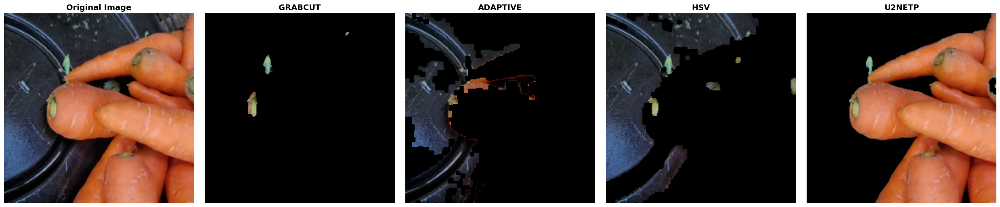

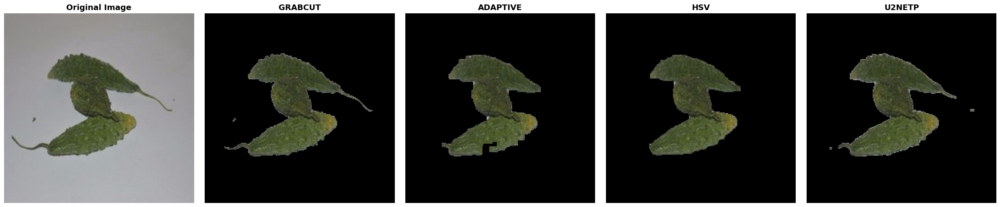

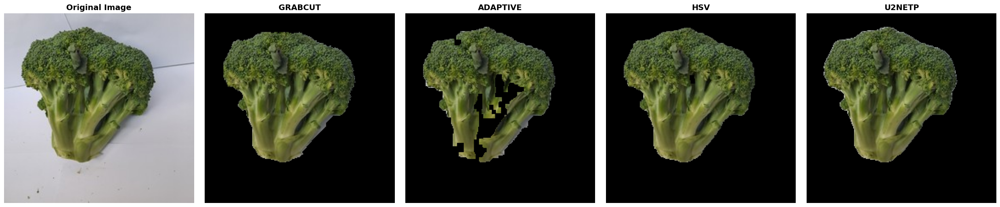

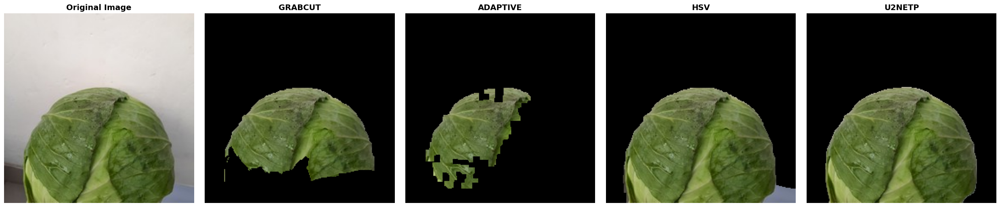

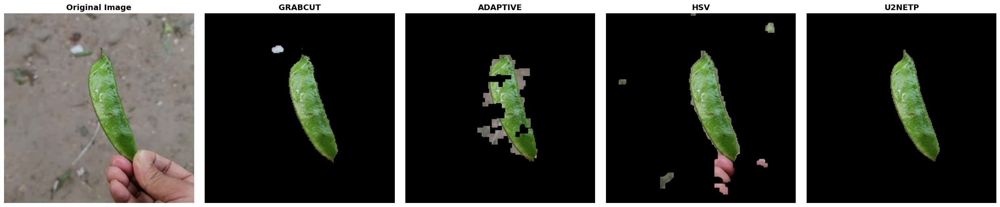

In [6]:
#@markdown Visualisasi segmentasi

import os

# Tentukan path dataset
TEST_DATASET_DIR = "dataset_prepared/train"
TEST_DATASET_DIR_2 = "dataset_prepared/val"

def get_sample(path):
    path1 = TEST_DATASET_DIR + path
    return path1 if os.path.exists(path1) else TEST_DATASET_DIR_2 + path

sample_images = [
    get_sample("/Sayur_Akar/carrot__0001.jpg"),
    get_sample("/Sayur_Buah/bitter_gourd__0007.jpg"),
    get_sample("/Sayur_Bunga/broccoli__0002.jpg"),
    get_sample("/Sayur_Daun/cabbage__0001.jpg"),
    get_sample("/Sayur_Polong/bean__0003.jpg")
]

if os.path.exists(TEST_DATASET_DIR):
    # Visualisasi perbandingan semua metode untuk 1 gambar
    if sample_images:
        print("\n" + "="*60)
        print("Perbandingan Semua Metode Segmentasi")
        print("="*60)
        for i in range(0, len(sample_images)):
           visualize_segmentation_comparison(
              sample_images[i],
              methods=['grabcut', 'adaptive', 'hsv', 'u2netp']
           )
else:
    print(f"⚠️ Dataset directory not found: {TEST_DATASET_DIR}")
    print("Please update TEST_DATASET_DIR variable with correct path")

## Visualisasi Auto brightness, contrast, clahe


Visualisasi Auto brightness, contrast & CLAHE


C:\Users\Raruu\AppData\Local\Temp\ipykernel_7716\845153331.py:53: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  accumulator.append(float(hist[0]))
C:\Users\Raruu\AppData\Local\Temp\ipykernel_7716\845153331.py:55: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  accumulator.append(accumulator[index - 1] + float(hist[index]))


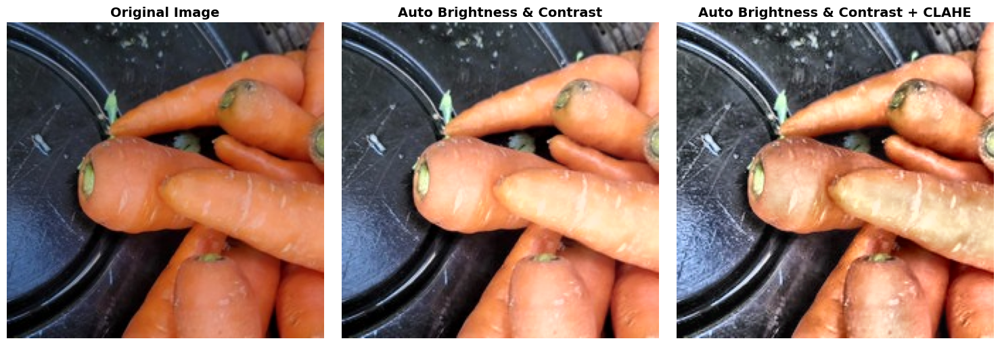

In [7]:
#@markdown ### Visualisasi Auto brightness, contrast, clahe


def visualize_auto_preprocess(image_path):
    """
    Visualizes the effect of automatic brightness & contrast and CLAHE.
    """
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error: Could not load image from {image_path}")
        return

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Apply automatic brightness and contrast
    img_auto_bc = apply_automatic_brightness_contrast(img.copy())
    img_auto_bc_rgb = cv2.cvtColor(img_auto_bc, cv2.COLOR_BGR2RGB)

    # Apply CLAHE after auto brightness and contrast
    img_auto_bc_clahe = apply_clahe(img_auto_bc.copy())
    img_auto_bc_clahe_rgb = cv2.cvtColor(img_auto_bc_clahe, cv2.COLOR_BGR2RGB)

    # Create subplots
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # Original Image
    axes[0].imshow(img_rgb)
    axes[0].set_title('Original Image', fontsize=14, fontweight='bold')
    axes[0].axis('off')

    # Auto Brightness & Contrast
    axes[1].imshow(img_auto_bc_rgb)
    axes[1].set_title('Auto Brightness & Contrast', fontsize=14, fontweight='bold')
    axes[1].axis('off')

    # Auto Brightness & Contrast + CLAHE
    axes[2].imshow(img_auto_bc_clahe_rgb)
    axes[2].set_title('Auto Brightness & Contrast + CLAHE', fontsize=14, fontweight='bold')
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

print("\n" + "="*60)
print("Visualisasi Auto brightness, contrast & CLAHE")
print("="*60)

visualize_auto_preprocess(sample_images[0])

# Feature Extraction

In [8]:
#@markdown ### extract_features.py
#@markdown - hog_feat,  # 5 features
#@markdown - lbp_feat,  # 6 features
#@markdown - sift_feat,  # 8 features
#@markdown - color_feat,  # 12 features
#@markdown - haralick_feat,  # 13 features
#@markdown #### Total: 44 features
#@markdown ---
USE_HOG = True #@param {type:"boolean"}
USE_LBP = True #@param {type:"boolean"}
USE_SIFT = True #@param {type:"boolean"}
USE_COLOR = True #@param {type:"boolean"}
USE_HARALICK = True #@param {type:"boolean"}

TOTAL_FEAUTURES = 0

if USE_HOG:
    TOTAL_FEAUTURES += 5
if USE_LBP:
    TOTAL_FEAUTURES += 6
if USE_SIFT:
    TOTAL_FEAUTURES += 8
if USE_COLOR:
    TOTAL_FEAUTURES += 12
if USE_HARALICK:
    TOTAL_FEAUTURES += 13


import numpy as np
from skimage.feature import hog, local_binary_pattern
import cv2
from scipy.stats import entropy
# from segment import auto_segment


def extract_hog_features(
    img, resize_shape=(128, 128), use_segmentation=False, seg_method="hsv"
):
    """
    Extract HOG (Histogram of Oriented Gradients) features

    Args:
        img: Input image (BGR)
        resize_shape: Target size for HOG computation
        use_segmentation: Whether to apply segmentation before feature extraction
        seg_method: Segmentation method ('grabcut', 'adaptive', 'hsv', 'none')
    """
    # Apply segmentation if enabled
    if use_segmentation and seg_method != "none":
        img = auto_segment(img, method=seg_method)

    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_resized = cv2.resize(img_gray, resize_shape)

    # HOG parameters
    hog_features = hog(
        img_resized,
        orientations=9,  # Number of orientation bins
        pixels_per_cell=(8, 8),  # Cell size
        cells_per_block=(2, 2),  # Block size
        block_norm="L2-Hys",  # Block normalization method
        visualize=False,
        feature_vector=True,
    )

    # Reduce dimensionality by taking statistics
    # Original HOG vector is too large, we summarize it
    hog_mean = np.mean(hog_features)
    hog_std = np.std(hog_features)
    hog_max = np.max(hog_features)
    hog_min = np.min(hog_features)
    hog_median = np.median(hog_features)

    return np.array([hog_mean, hog_std, hog_max, hog_min, hog_median], dtype=np.float32)


def extract_lbp_features(
    img,
    radius=1,
    n_points=8,
    resize_shape=(128, 128),
    use_segmentation=False,
    seg_method="hsv",
):
    """
    Extract LBP (Local Binary Pattern) features

    Args:
        img: Input image (BGR)
        radius: Radius of circle (default=1)
        n_points: Number of circularly symmetric neighbor points (default=8)
        resize_shape: Target size for LBP computation
        use_segmentation: Whether to apply segmentation before feature extraction
        seg_method: Segmentation method ('grabcut', 'adaptive', 'hsv', 'none')
    """
    # Apply segmentation if enabled
    if use_segmentation and seg_method != "none":
        img = auto_segment(img, method=seg_method)

    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_resized = cv2.resize(img_gray, resize_shape)

    # Compute LBP
    lbp = local_binary_pattern(img_resized, n_points, radius, method="uniform")

    # Extract statistical features from LBP
    lbp_mean = np.mean(lbp)
    lbp_std = np.std(lbp)
    lbp_max = np.max(lbp)
    lbp_min = np.min(lbp)
    lbp_median = np.median(lbp)

    # Calculate entropy (measure of randomness/complexity)
    hist, _ = np.histogram(
        lbp.ravel(), bins=n_points + 2, range=(0, n_points + 2), density=True
    )
    lbp_entropy = entropy(hist + 1e-7)  # Add small value to avoid log(0)

    return np.array(
        [lbp_mean, lbp_std, lbp_max, lbp_min, lbp_median, lbp_entropy], dtype=np.float32
    )


def extract_sift_features(
    img, n_keypoints=100, use_segmentation=False, seg_method="hsv"
):
    """
    Extract SIFT (Scale-Invariant Feature Transform) features

    Args:
        img: Input image (BGR)
        n_keypoints: Number of top keypoints to consider
        use_segmentation: Whether to apply segmentation before feature extraction
        seg_method: Segmentation method ('grabcut', 'adaptive', 'hsv', 'none')

    Returns:
        Statistical features from SIFT descriptors (8 features)
    """
    # Apply segmentation if enabled
    if use_segmentation and seg_method != "none":
        img = auto_segment(img, method=seg_method)

    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Initialize SIFT detector
    sift = cv2.SIFT_create()

    # Detect keypoints and compute descriptors
    keypoints, descriptors = sift.detectAndCompute(img_gray, None)

    if descriptors is None or len(descriptors) == 0:
        # Return zeros if no keypoints found
        return np.zeros(8, dtype=np.float32)

    # Sort keypoints by response strength and take top N
    if len(keypoints) > n_keypoints:
        # Sort by response (strength)
        sorted_indices = np.argsort([kp.response for kp in keypoints])[::-1]
        descriptors = descriptors[sorted_indices[:n_keypoints]]

    # Extract statistical features from SIFT descriptors
    sift_mean = np.mean(descriptors)
    sift_std = np.std(descriptors)
    sift_max = np.max(descriptors)
    sift_min = np.min(descriptors)
    sift_median = np.median(descriptors)
    sift_q25 = np.percentile(descriptors, 25)
    sift_q75 = np.percentile(descriptors, 75)
    sift_num_keypoints = len(keypoints)

    return np.array(
        [
            sift_mean,
            sift_std,
            sift_max,
            sift_min,
            sift_median,
            sift_q25,
            sift_q75,
            sift_num_keypoints,
        ],
        dtype=np.float32,
    )


def extract_color_histogram_features(img, use_segmentation=False, seg_method="hsv"):
    """
    Extract Color Histogram features from RGB channels

    Args:
        img: Input image (BGR)
        use_segmentation: Whether to apply segmentation before feature extraction
        seg_method: Segmentation method ('grabcut', 'adaptive', 'hsv', 'none')

    Returns:
        Color statistics features (12 features)
    """
    # Apply segmentation if enabled
    if use_segmentation and seg_method != "none":
        img = auto_segment(img, method=seg_method)

    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Create mask to ignore black pixels (background from segmentation)
    mask = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) > 10

    # Extract color statistics for each channel
    features = []

    for channel_idx, channel_name in enumerate(["R", "G", "B"]):
        channel = img_rgb[:, :, channel_idx]

        # Get valid pixels (non-background)
        valid_pixels = channel[mask]

        if len(valid_pixels) > 0:
            # Statistical features
            mean_val = np.mean(valid_pixels)
            std_val = np.std(valid_pixels)
            max_val = np.max(valid_pixels)
            min_val = np.min(valid_pixels)
        else:
            mean_val = std_val = max_val = min_val = 0

        features.extend([mean_val, std_val, max_val, min_val])

    return np.array(features, dtype=np.float32)


def extract_haralick_features(img, use_segmentation=False, seg_method="hsv"):
    """
    Extract Haralick texture features

    Args:
        img: Input image (BGR)
        use_segmentation: Whether to apply segmentation before feature extraction
        seg_method: Segmentation method ('grabcut', 'adaptive', 'hsv', 'none')

    Returns:
        Haralick texture features (13 features)
    """
    # Fallback: Use enhanced texture features if mahotas not available

    # Apply segmentation if enabled
    if use_segmentation and seg_method != "none":
        img = auto_segment(img, method=seg_method)

    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Compute texture features using multiple angles and distances
    from skimage.feature import graycomatrix, graycoprops

    distances = [1, 2]
    angles = [0, np.pi / 4, np.pi / 2, 3 * np.pi / 4]

    glcm = graycomatrix(
        img_gray,
        distances=distances,
        angles=angles,
        levels=256,
        symmetric=True,
        normed=True,
    )

    # Extract properties
    contrast = graycoprops(glcm, "contrast").mean()
    dissimilarity = graycoprops(glcm, "dissimilarity").mean()
    homogeneity = graycoprops(glcm, "homogeneity").mean()
    energy = graycoprops(glcm, "energy").mean()
    correlation = graycoprops(glcm, "correlation").mean()
    asm = graycoprops(glcm, "ASM").mean()

    # Additional texture measures
    contrast_std = graycoprops(glcm, "contrast").std()
    dissimilarity_std = graycoprops(glcm, "dissimilarity").std()
    homogeneity_std = graycoprops(glcm, "homogeneity").std()
    energy_std = graycoprops(glcm, "energy").std()
    correlation_std = graycoprops(glcm, "correlation").std()
    asm_std = graycoprops(glcm, "ASM").std()

    # Edge density
    edges = cv2.Canny(img_gray, 50, 150)
    edge_density = np.sum(edges > 0) / edges.size

    return np.array(
        [
            contrast,
            dissimilarity,
            homogeneity,
            energy,
            correlation,
            asm,
            contrast_std,
            dissimilarity_std,
            homogeneity_std,
            energy_std,
            correlation_std,
            asm_std,
            edge_density,
        ],
        dtype=np.float32,
    )


def extract_all_features(img, use_segmentation=False, seg_method="hsv"):
    features = []
    if USE_HOG:
        hog_feat = extract_hog_features(
            img, use_segmentation=use_segmentation, seg_method=seg_method
        )
        features.append(hog_feat)
    if USE_LBP:
        lbp_feat = extract_lbp_features(
            img, use_segmentation=use_segmentation, seg_method=seg_method
        )
        features.append(lbp_feat)
    if USE_SIFT:
        sift_feat = extract_sift_features(
            img, use_segmentation=use_segmentation, seg_method=seg_method
        )
        features.append(sift_feat)
    if USE_COLOR:
        color_feat = extract_color_histogram_features(
            img, use_segmentation=use_segmentation, seg_method=seg_method
        )
        features.append(color_feat)
    if USE_HARALICK:
        haralick_feat = extract_haralick_features(
            img, use_segmentation=use_segmentation, seg_method=seg_method
        )
        features.append(haralick_feat)

    # Concatenate all features: 5 + 6 + 8 + 12 + 13 = 44 features
    # combined = np.concatenate(
    #     [
    #         hog_feat,  # 5 features
    #         lbp_feat,  # 6 features
    #         sift_feat,  # 8 features
    #         color_feat,  # 12 features
    #         haralick_feat,  # 13 features
    #     ]
    # )
    combined = np.concatenate(features)

    return combined


In [9]:
#@markdown ### Helper Visualisasi Feature Extraction

import matplotlib.pyplot as plt
from skimage.feature import hog, local_binary_pattern
import cv2
import numpy as np
from pathlib import Path

def visualize_hog_features(image_path):
    """
    Visualisasi HOG features dengan gambar HOG
    """
    img = cv2.imread(image_path)
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_resized = cv2.resize(img_gray, (128, 128))

    # Extract HOG with visualization
    hog_features, hog_image = hog(
        img_resized,
        orientations=9,
        pixels_per_cell=(8, 8),
        cells_per_block=(2, 2),
        block_norm="L2-Hys",
        visualize=True,
        feature_vector=True,
    )

    # Create visualization
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))

    # Original grayscale
    axes[0].imshow(img_resized, cmap='gray')
    axes[0].set_title('Original Image (Grayscale)', fontsize=14, fontweight='bold')
    axes[0].axis('off')

    # HOG visualization
    axes[1].imshow(hog_image, cmap='hot')
    axes[1].set_title('HOG Features Visualization', fontsize=14, fontweight='bold')
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

    # Print statistics
    hog_mean = np.mean(hog_features)
    hog_std = np.std(hog_features)
    hog_max = np.max(hog_features)
    hog_min = np.min(hog_features)
    hog_median = np.median(hog_features)

    print(f"HOG Feature Statistics:")
    print(f"  Mean: {hog_mean:.4f}")
    print(f"  Std: {hog_std:.4f}")
    print(f"  Max: {hog_max:.4f}")
    print(f"  Min: {hog_min:.4f}")
    print(f"  Median: {hog_median:.4f}")


def visualize_lbp_features(image_path):
    """
    Visualisasi LBP features
    """
    img = cv2.imread(image_path)
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_resized = cv2.resize(img_gray, (128, 128))

    # Compute LBP
    radius = 1
    n_points = 8
    lbp = local_binary_pattern(img_resized, n_points, radius, method="uniform")

    # Create visualization
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # Original
    axes[0].imshow(img_resized, cmap='gray')
    axes[0].set_title('Original Image', fontsize=14, fontweight='bold')
    axes[0].axis('off')

    # LBP
    axes[1].imshow(lbp, cmap='gray')
    axes[1].set_title('LBP Pattern', fontsize=14, fontweight='bold')
    axes[1].axis('off')

    # LBP Histogram
    hist, bins = np.histogram(lbp.ravel(), bins=n_points + 2, range=(0, n_points + 2))
    axes[2].bar(range(len(hist)), hist, width=0.8, color='steelblue', edgecolor='black')
    axes[2].set_title('LBP Histogram', fontsize=14, fontweight='bold')
    axes[2].set_xlabel('LBP Value')
    axes[2].set_ylabel('Frequency')
    axes[2].grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

    # Print statistics
    from scipy.stats import entropy
    lbp_mean = np.mean(lbp)
    lbp_std = np.std(lbp)
    hist_norm = hist / hist.sum()
    lbp_entropy = entropy(hist_norm + 1e-7)

    print(f"LBP Feature Statistics:")
    print(f"  Mean: {lbp_mean:.4f}")
    print(f"  Std: {lbp_std:.4f}")
    print(f"  Entropy: {lbp_entropy:.4f}")


def visualize_sift_features(image_path):
    """
    Visualisasi SIFT keypoints
    """
    img = cv2.imread(image_path)
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Initialize SIFT
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(img_gray, None)

    # Draw keypoints
    img_keypoints = cv2.drawKeypoints(
        img, keypoints, None,
        flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS,
        color=(0, 255, 0)
    )

    # Create visualization
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))

    # Original
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    axes[0].imshow(img_rgb)
    axes[0].set_title('Original Image', fontsize=14, fontweight='bold')
    axes[0].axis('off')

    # SIFT keypoints
    img_keypoints_rgb = cv2.cvtColor(img_keypoints, cv2.COLOR_BGR2RGB)
    axes[1].imshow(img_keypoints_rgb)
    axes[1].set_title(f'SIFT Keypoints (Total: {len(keypoints)})', fontsize=14, fontweight='bold')
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

    # Print statistics
    if descriptors is not None and len(descriptors) > 0:
        sift_mean = np.mean(descriptors)
        sift_std = np.std(descriptors)
        sift_max = np.max(descriptors)
        sift_min = np.min(descriptors)

        print(f"SIFT Feature Statistics:")
        print(f"  Number of keypoints: {len(keypoints)}")
        print(f"  Descriptor mean: {sift_mean:.4f}")
        print(f"  Descriptor std: {sift_std:.4f}")
        print(f"  Descriptor max: {sift_max:.4f}")
        print(f"  Descriptor min: {sift_min:.4f}")


def visualize_color_features(image_path):
    """
    Visualisasi Color Histogram features
    """
    img = cv2.imread(image_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Create mask (ignore black background)
    mask = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) > 10

    # Create visualization
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))

    # Original image
    axes[0, 0].imshow(img_rgb)
    axes[0, 0].set_title('Original Image', fontsize=14, fontweight='bold')
    axes[0, 0].axis('off')

    # Color histograms for each channel
    colors = ['red', 'green', 'blue']
    channel_names = ['Red', 'Green', 'Blue']

    for i, (color, name) in enumerate(zip(colors, channel_names)):
        ax = axes[0, 1] if i == 0 else axes[1, i-1]

        channel = img_rgb[:, :, i]
        valid_pixels = channel[mask]

        if len(valid_pixels) > 0:
            ax.hist(valid_pixels, bins=50, color=color, alpha=0.7, edgecolor='black')
            ax.set_title(f'{name} Channel Histogram', fontsize=12, fontweight='bold')
            ax.set_xlabel('Pixel Value')
            ax.set_ylabel('Frequency')
            ax.grid(True, alpha=0.3)

            # Add statistics text
            mean_val = np.mean(valid_pixels)
            std_val = np.std(valid_pixels)
            ax.axvline(mean_val, color='darkred', linestyle='--', linewidth=2, label=f'Mean: {mean_val:.1f}')
            ax.legend()

    plt.tight_layout()
    plt.show()

    # Print overall statistics
    print(f"Color Feature Statistics:")
    for i, name in enumerate(channel_names):
        channel = img_rgb[:, :, i]
        valid_pixels = channel[mask]
        if len(valid_pixels) > 0:
            print(f"  {name} Channel:")
            print(f"    Mean: {np.mean(valid_pixels):.2f}")
            print(f"    Std: {np.std(valid_pixels):.2f}")
            print(f"    Max: {np.max(valid_pixels):.2f}")
            print(f"    Min: {np.min(valid_pixels):.2f}")


def visualize_haralick_features(image_path):
    """
    Visualisasi Haralick texture features dengan GLCM
    """
    from skimage.feature import graycomatrix, graycoprops

    img = cv2.imread(image_path)
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Compute GLCM
    distances = [1, 2]
    angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
    glcm = graycomatrix(
        img_gray,
        distances=distances,
        angles=angles,
        levels=256,
        symmetric=True,
        normed=True,
    )

    # Extract properties
    properties = ['contrast', 'dissimilarity', 'homogeneity', 'energy', 'correlation', 'ASM']
    prop_values = {prop: graycoprops(glcm, prop) for prop in properties}

    # Create visualization
    fig, axes = plt.subplots(2, 3, figsize=(16, 10))
    axes = axes.ravel()

    # Original image with edge detection
    axes[0].imshow(img_gray, cmap='gray')
    axes[0].set_title('Original Image (Grayscale)', fontsize=12, fontweight='bold')
    axes[0].axis('off')

    # Edge detection (Canny)
    edges = cv2.Canny(img_gray, 50, 150)
    axes[1].imshow(edges, cmap='gray')
    edge_density = np.sum(edges > 0) / edges.size
    axes[1].set_title(f'Edge Detection (Density: {edge_density:.4f})', fontsize=12, fontweight='bold')
    axes[1].axis('off')

    # GLCM properties visualization
    for idx, prop in enumerate(properties[:4], start=2):
        prop_mean = prop_values[prop].mean()
        prop_std = prop_values[prop].std()

        # Create heatmap
        data = prop_values[prop]
        im = axes[idx].imshow(data, cmap='viridis', aspect='auto')
        axes[idx].set_title(f'{prop.capitalize()}\nMean: {prop_mean:.4f}, Std: {prop_std:.4f}',
                           fontsize=11, fontweight='bold')
        axes[idx].set_xlabel('Angle Index')
        axes[idx].set_ylabel('Distance')
        plt.colorbar(im, ax=axes[idx], fraction=0.046, pad=0.04)

    plt.tight_layout()
    plt.show()

    # Print all statistics
    print(f"Haralick Texture Feature Statistics:")
    for prop in properties:
        print(f"  {prop.capitalize()}:")
        print(f"    Mean: {prop_values[prop].mean():.4f}")
        print(f"    Std: {prop_values[prop].std():.4f}")
    print(f"  Edge Density: {edge_density:.4f}")


def visualize_all_features(image_path):
    """
    Visualisasi semua fitur dalam satu dashboard
    """
    img_path_obj = Path(image_path)
    image_class = img_path_obj.parent.name.replace('_', ' ')

    print("=" * 80)
    print(f"Feature Extraction Visualization: {image_class}")
    print("=" * 80)
    print()

    print("1. HOG (Histogram of Oriented Gradients) Features")
    print("-" * 80)
    visualize_hog_features(image_path)
    print()

    print("2. LBP (Local Binary Pattern) Features")
    print("-" * 80)
    visualize_lbp_features(image_path)
    print()

    print("3. SIFT (Scale-Invariant Feature Transform) Features")
    print("-" * 80)
    visualize_sift_features(image_path)
    print()

    print("4. Color Histogram Features")
    print("-" * 80)
    visualize_color_features(image_path)
    print()

    print("5. Haralick Texture Features")
    print("-" * 80)
    visualize_haralick_features(image_path)
    print()

    # Extract and display combined features
    if TOTAL_FEAUTURES == 44:
      img = cv2.imread(image_path)
      combined_features = extract_all_features(img, use_segmentation=False, seg_method='none')

      print("6. Combined Feature Vector (44 features)")
      print("-" * 80)
      print(f"  HOG features (5): {combined_features[:5]}")
      print(f"  LBP features (6): {combined_features[5:11]}")
      print(f"  SIFT features (8): {combined_features[11:19]}")
      print(f"  Color features (12): {combined_features[19:31]}")
      print(f"  Haralick features (13): {combined_features[31:44]}")
      print(f"\n  Total features: {len(combined_features)}")

      # Visualize feature vector as bar chart
      fig, ax = plt.subplots(figsize=(16, 5))

      feature_groups = {
          'HOG': (0, 5),
          'LBP': (5, 11),
          'SIFT': (11, 19),
          'Color': (19, 31),
          'Haralick': (31, 44)
      }

      colors_map = {
          'HOG': 'steelblue',
          'LBP': 'orange',
          'SIFT': 'green',
          'Color': 'red',
          'Haralick': 'purple'
      }

      for name, (start, end) in feature_groups.items():
          indices = range(start, end)
          values = combined_features[start:end]
          ax.bar(indices, values, label=name, color=colors_map[name], alpha=0.7, edgecolor='black')

      ax.set_xlabel('Feature Index', fontsize=12, fontweight='bold')
      ax.set_ylabel('Feature Value', fontsize=12, fontweight='bold')
      ax.set_title('Combined Feature Vector (44 features)', fontsize=14, fontweight='bold')
      ax.legend(loc='upper right', fontsize=11)
      ax.grid(True, alpha=0.3, axis='y')

      plt.tight_layout()
      plt.show()

      print("=" * 80)


def compare_features_across_classes(sample_images):
    """
    Membandingkan fitur dari berbagai kelas sayuran
    """
    if len(sample_images) < 2:
        print("Need at least 2 images to compare")
        return

    print("=" * 80)
    print("Feature Comparison Across Classes")
    print("=" * 80)

    # Extract features for all images
    all_features = []
    class_names = []

    for img_path in sample_images:
        img = cv2.imread(img_path)
        features = extract_all_features(img, use_segmentation=False, seg_method='none')
        all_features.append(features)

        img_path_obj = Path(img_path)
        class_name = img_path_obj.parent.name.replace('_', ' ')
        class_names.append(class_name)

    all_features = np.array(all_features)

    # Create comparison visualization
    fig, axes = plt.subplots(2, 3, figsize=(18, 10))
    axes = axes.ravel()

    feature_groups = {
        'HOG': (0, 5),
        'LBP': (5, 11),
        'SIFT': (11, 19),
        'Color': (19, 31),
        'Haralick': (31, 44)
    }

    for idx, (name, (start, end)) in enumerate(feature_groups.items()):
        if idx >= 5:
            break

        ax = axes[idx]

        # Get features for this group
        group_features = all_features[:, start:end]

        # Calculate mean for each class
        mean_features = np.mean(group_features, axis=1)

        # Create bar chart
        x_pos = np.arange(len(class_names))
        bars = ax.bar(x_pos, mean_features, alpha=0.7, edgecolor='black')

        # Color bars differently
        colors = plt.cm.Set3(np.linspace(0, 1, len(class_names)))
        for bar, color in zip(bars, colors):
            bar.set_color(color)

        ax.set_xticks(x_pos)
        ax.set_xticklabels(class_names, rotation=45, ha='right')
        ax.set_ylabel('Mean Feature Value', fontsize=10)
        ax.set_title(f'{name} Features Comparison', fontsize=12, fontweight='bold')
        ax.grid(True, alpha=0.3, axis='y')

    # Use last subplot for overall comparison
    ax = axes[5]

    # Calculate overall feature magnitude for each class
    overall_magnitude = np.linalg.norm(all_features, axis=1)

    x_pos = np.arange(len(class_names))
    bars = ax.bar(x_pos, overall_magnitude, alpha=0.7, edgecolor='black')

    colors = plt.cm.Set3(np.linspace(0, 1, len(class_names)))
    for bar, color in zip(bars, colors):
        bar.set_color(color)

    ax.set_xticks(x_pos)
    ax.set_xticklabels(class_names, rotation=45, ha='right')
    ax.set_ylabel('Feature Vector Magnitude', fontsize=10)
    ax.set_title('Overall Feature Magnitude', fontsize=12, fontweight='bold')
    ax.grid(True, alpha=0.3, axis='y')

    plt.tight_layout()
    plt.show()

    # Print detailed comparison
    print("\nDetailed Feature Statistics:")
    print("-" * 80)
    for i, class_name in enumerate(class_names):
        print(f"\n{class_name}:")
        print(f"  Feature vector magnitude: {overall_magnitude[i]:.2f}")
        print(f"  Mean feature value: {np.mean(all_features[i]):.4f}")
        print(f"  Std feature value: {np.std(all_features[i]):.4f}")

In [10]:
import os
TEST_DATASET_DIR = "dataset_prepared_train/train"

sample_images = [
    TEST_DATASET_DIR + "/Sayur_Akar/carrot__0001.jpg",
    TEST_DATASET_DIR + "/Sayur_Buah/bitter_gourd__0074.jpg",
    TEST_DATASET_DIR + "/Sayur_Bunga/broccoli__0138.jpg",
    TEST_DATASET_DIR + "/Sayur_Daun/cabbage__0027.jpg",
    TEST_DATASET_DIR + "/Sayur_Polong/bean__0093.jpg"
]

### Visualisasi Feature Extraction - Sayur Akar

Feature Extraction Visualization: Sayur Akar

1. HOG (Histogram of Oriented Gradients) Features
--------------------------------------------------------------------------------


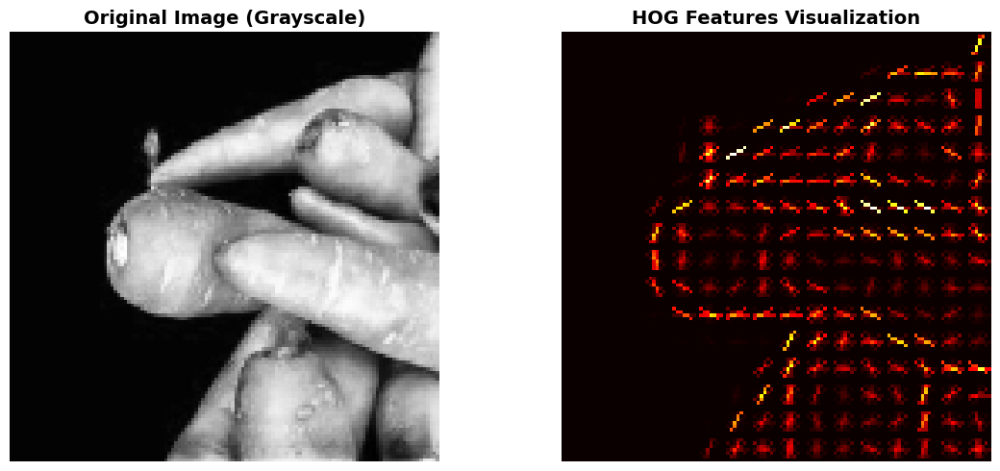

HOG Feature Statistics:
  Mean: 0.0877
  Std: 0.1179
  Max: 1.0000
  Min: 0.0000
  Median: 0.0269

2. LBP (Local Binary Pattern) Features
--------------------------------------------------------------------------------


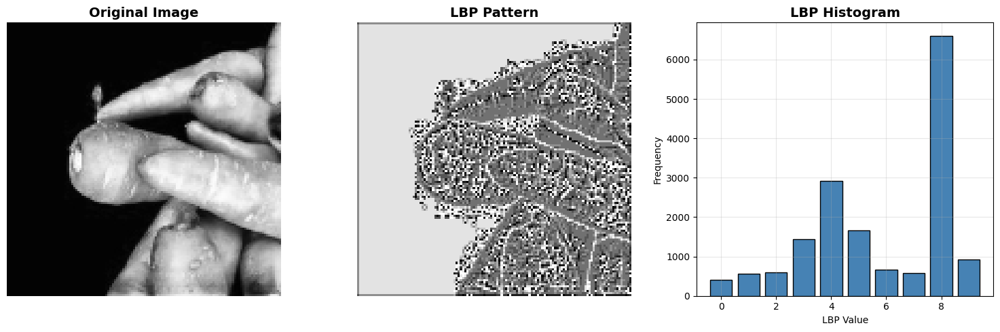

LBP Feature Statistics:
  Mean: 5.8201
  Std: 2.4628
  Entropy: 1.8598

3. SIFT (Scale-Invariant Feature Transform) Features
--------------------------------------------------------------------------------


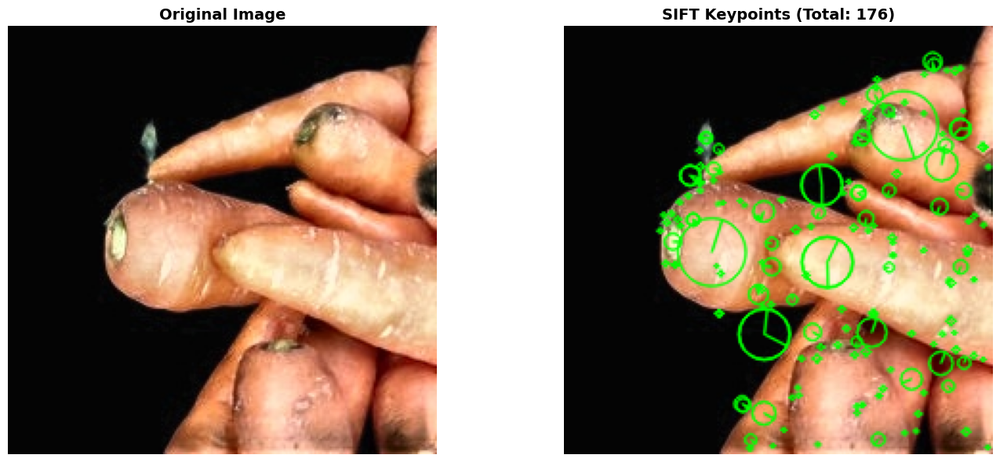

SIFT Feature Statistics:
  Number of keypoints: 176
  Descriptor mean: 23.4591
  Descriptor std: 38.7057
  Descriptor max: 187.0000
  Descriptor min: 0.0000

4. Color Histogram Features
--------------------------------------------------------------------------------


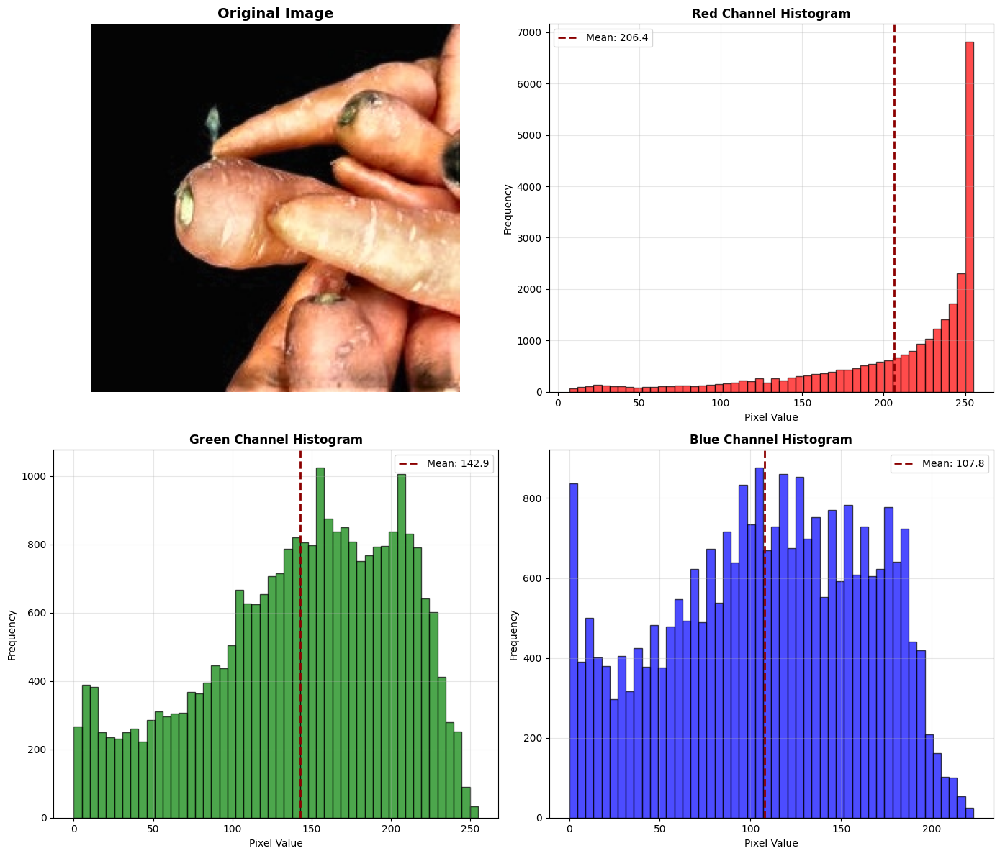

Color Feature Statistics:
  Red Channel:
    Mean: 206.38
    Std: 58.49
    Max: 255.00
    Min: 7.00
  Green Channel:
    Mean: 142.95
    Std: 61.15
    Max: 255.00
    Min: 0.00
  Blue Channel:
    Mean: 107.83
    Std: 55.16
    Max: 223.00
    Min: 0.00

5. Haralick Texture Features
--------------------------------------------------------------------------------


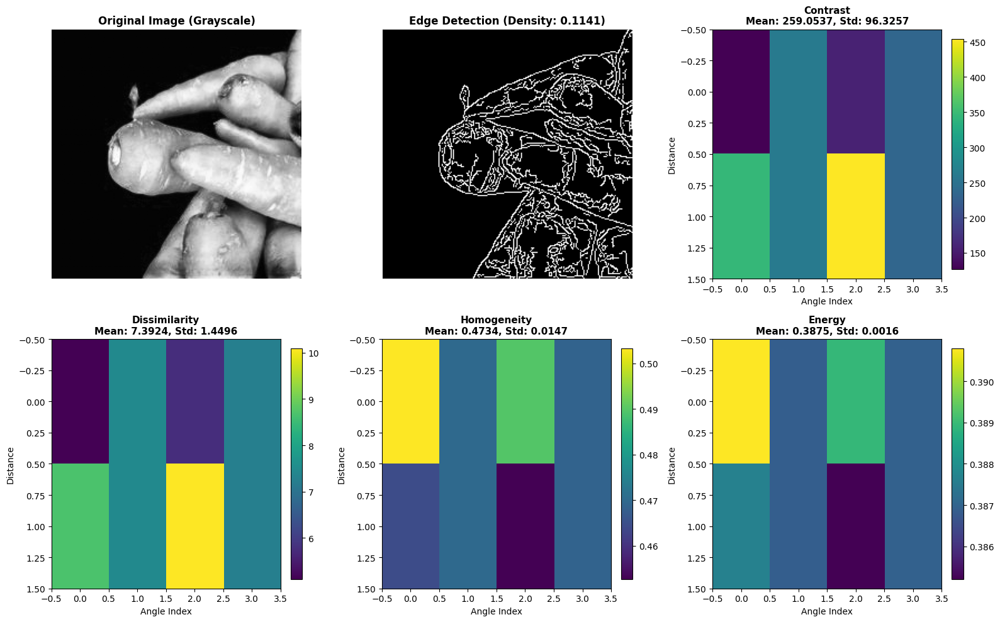

Haralick Texture Feature Statistics:
  Contrast:
    Mean: 259.0537
    Std: 96.3257
  Dissimilarity:
    Mean: 7.3924
    Std: 1.4496
  Homogeneity:
    Mean: 0.4734
    Std: 0.0147
  Energy:
    Mean: 0.3875
    Std: 0.0016
  Correlation:
    Mean: 0.9832
    Std: 0.0063
  Asm:
    Mean: 0.1502
    Std: 0.0012
  Edge Density: 0.1141

6. Combined Feature Vector (44 features)
--------------------------------------------------------------------------------
  HOG features (5): [0.08772246 0.11793943 1.         0.         0.02691223]
  LBP features (6): [5.8201294 2.4628456 9.        0.        6.        1.8597697]
  SIFT features (8): [ 22.98297   38.984215 187.         0.         4.         0.
  27.       176.      ]
  Color features (12): [206.3816   58.48617 255.        7.      142.94533  61.15172 255.
   0.      107.82853  55.15833 223.        0.     ]
  Haralick features (13): [2.59053711e+02 7.39238405e+00 4.73448485e-01 3.87526959e-01
 9.83154237e-01 1.50179580e-01 9.63256989e+01 1

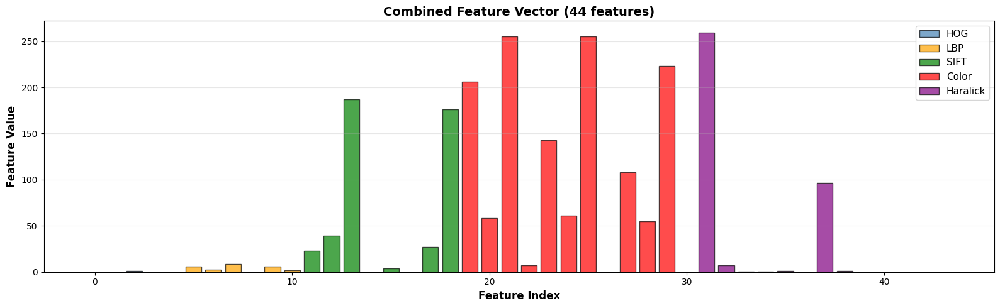

In [11]:
#@markdown Visualisasi Feature Extraction - Sayur Akar

if os.path.exists(TEST_DATASET_DIR):
    if len(sample_images) > 0 and os.path.exists(sample_images[0]):
        visualize_all_features(sample_images[0])

else:
    print(f"⚠️ Dataset directory not found: {TEST_DATASET_DIR}")
    print("Please update TEST_DATASET_DIR variable with correct path")

### Visualisasi Feature Extraction - Sayur Buah

Feature Extraction Visualization: Sayur Buah

1. HOG (Histogram of Oriented Gradients) Features
--------------------------------------------------------------------------------


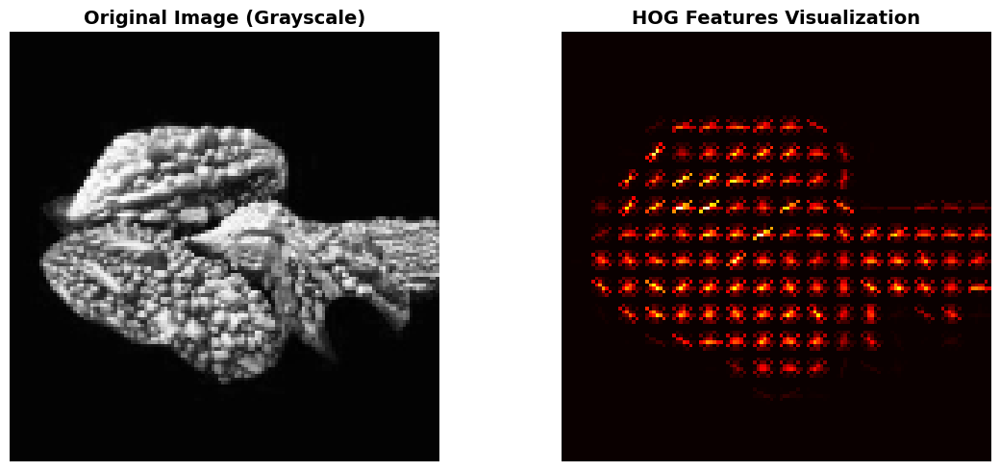

HOG Feature Statistics:
  Mean: 0.0830
  Std: 0.1112
  Max: 1.0000
  Min: 0.0000
  Median: 0.0105

2. LBP (Local Binary Pattern) Features
--------------------------------------------------------------------------------


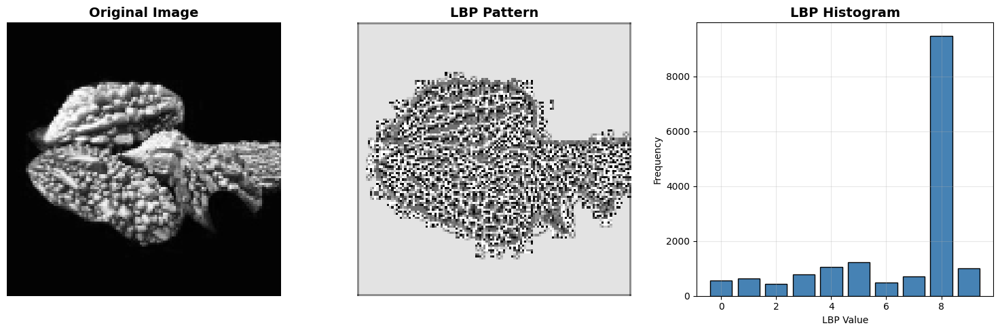

LBP Feature Statistics:
  Mean: 6.5362
  Std: 2.4473
  Entropy: 1.5816

3. SIFT (Scale-Invariant Feature Transform) Features
--------------------------------------------------------------------------------


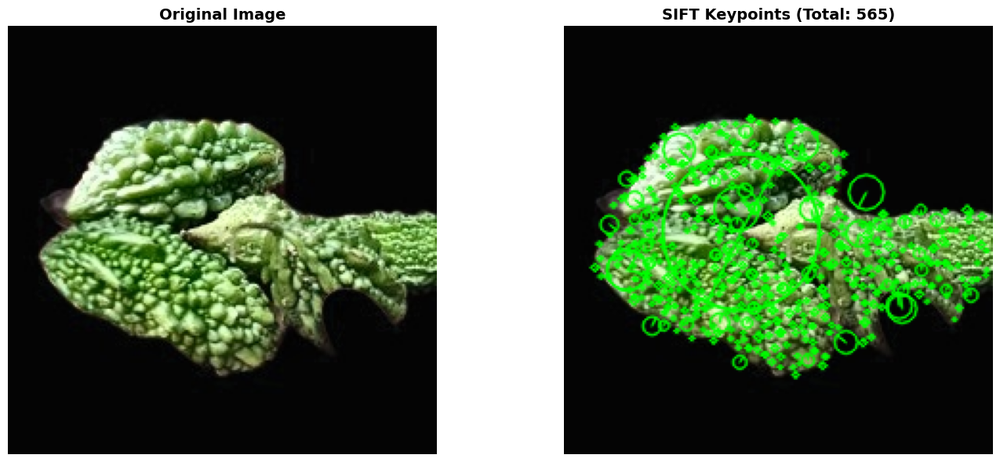

SIFT Feature Statistics:
  Number of keypoints: 565
  Descriptor mean: 28.7174
  Descriptor std: 34.9736
  Descriptor max: 191.0000
  Descriptor min: 0.0000

4. Color Histogram Features
--------------------------------------------------------------------------------


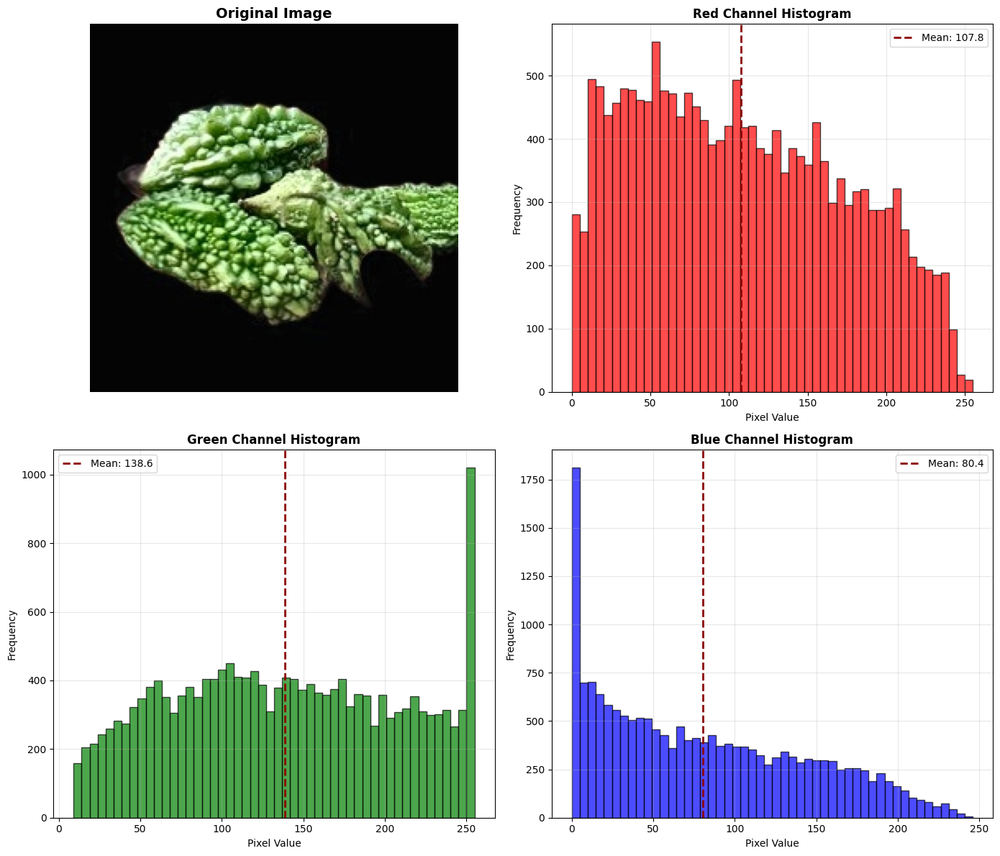

Color Feature Statistics:
  Red Channel:
    Mean: 107.75
    Std: 65.21
    Max: 255.00
    Min: 0.00
  Green Channel:
    Mean: 138.56
    Std: 69.13
    Max: 255.00
    Min: 9.00
  Blue Channel:
    Mean: 80.41
    Std: 62.95
    Max: 246.00
    Min: 0.00

5. Haralick Texture Features
--------------------------------------------------------------------------------


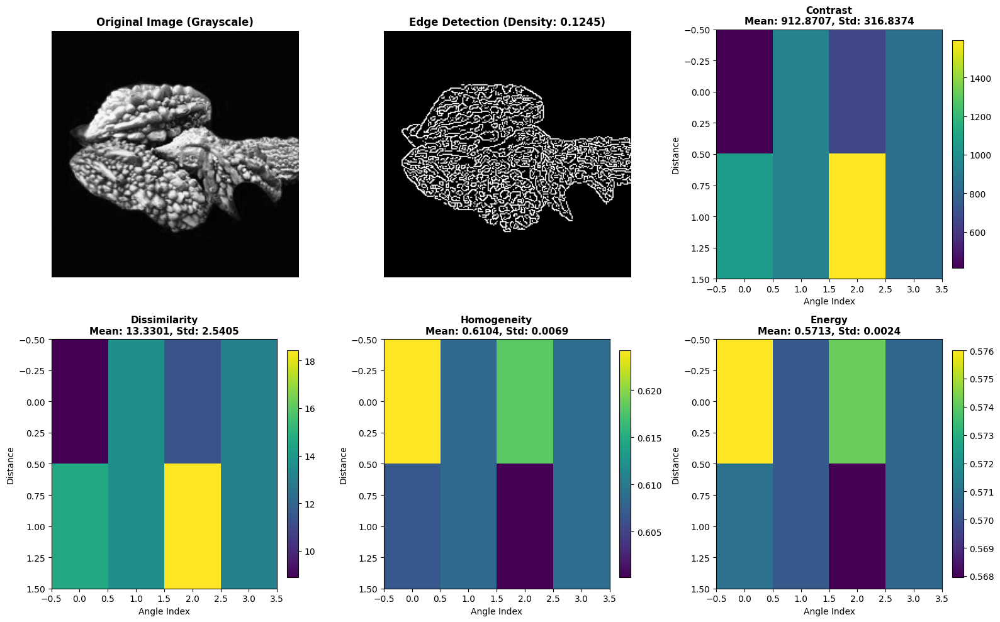

Haralick Texture Feature Statistics:
  Contrast:
    Mean: 912.8707
    Std: 316.8374
  Dissimilarity:
    Mean: 13.3301
    Std: 2.5405
  Homogeneity:
    Mean: 0.6104
    Std: 0.0069
  Energy:
    Mean: 0.5713
    Std: 0.0024
  Correlation:
    Mean: 0.9048
    Std: 0.0330
  Asm:
    Mean: 0.3264
    Std: 0.0027
  Edge Density: 0.1245

6. Combined Feature Vector (44 features)
--------------------------------------------------------------------------------
  HOG features (5): [0.08300871 0.11121517 1.         0.         0.01052793]
  LBP features (6): [6.536194  2.4473276 9.        0.        8.        1.5815506]
  SIFT features (8): [ 29.814531  34.037235 191.         0.        17.         5.
  42.       565.      ]
  Color features (12): [107.753296  65.20741  255.         0.       138.561     69.13202
 255.         9.        80.412025  62.946926 246.         0.      ]
  Haralick features (13): [9.1287067e+02 1.3330149e+01 6.1042756e-01 5.7133865e-01 9.0484035e-01
 3.2643345e-01 3.16

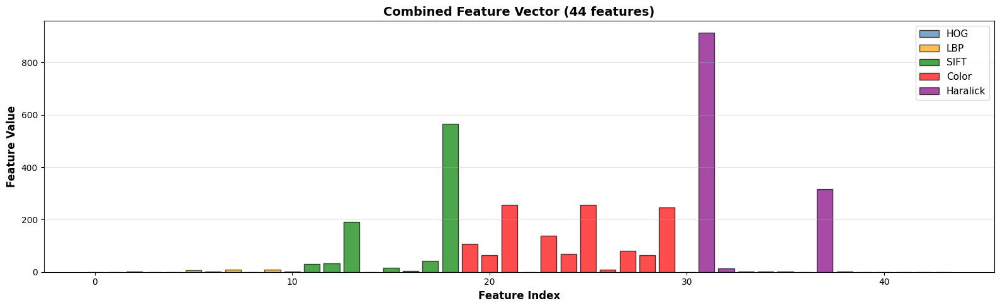

In [12]:
#@markdown Visualisasi Feature Extraction - Sayur Buah

if os.path.exists(TEST_DATASET_DIR):
    if len(sample_images) > 0 and os.path.exists(sample_images[1]):
        visualize_all_features(sample_images[1])

else:
    print(f"⚠️ Dataset directory not found: {TEST_DATASET_DIR}")
    print("Please update TEST_DATASET_DIR variable with correct path")

### Visualisasi Feature Extraction - Sayur Daun

Feature Extraction Visualization: Sayur Bunga

1. HOG (Histogram of Oriented Gradients) Features
--------------------------------------------------------------------------------


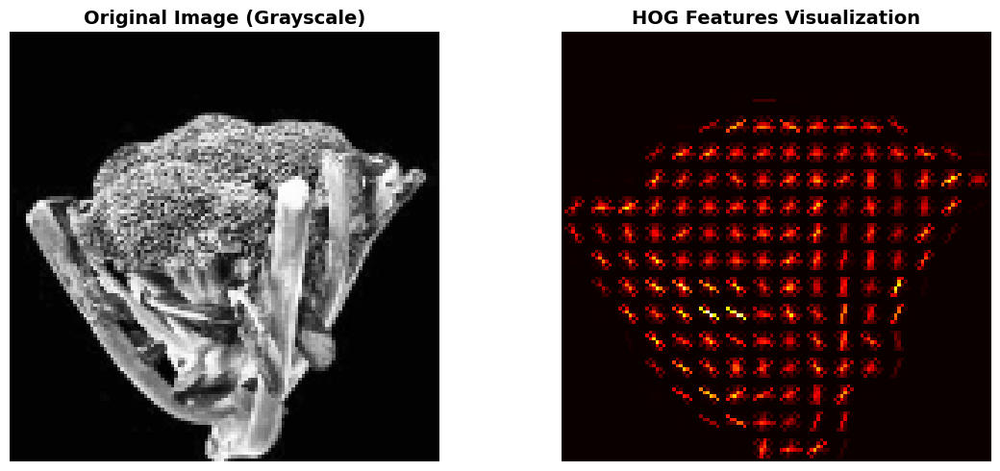

HOG Feature Statistics:
  Mean: 0.0932
  Std: 0.1163
  Max: 1.0000
  Min: 0.0000
  Median: 0.0399

2. LBP (Local Binary Pattern) Features
--------------------------------------------------------------------------------


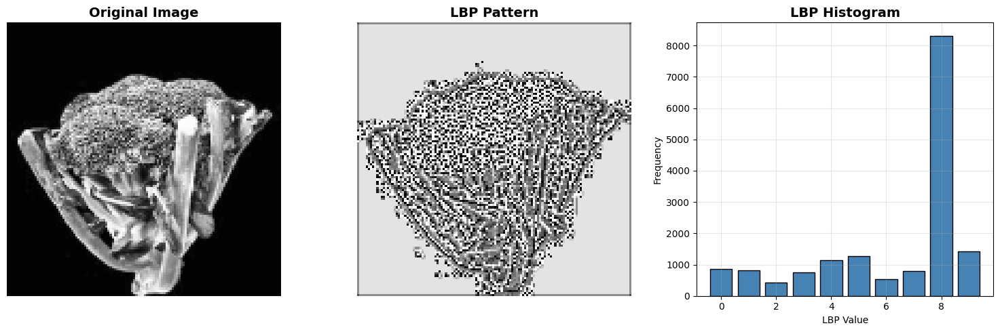

LBP Feature Statistics:
  Mean: 6.2952
  Std: 2.6676
  Entropy: 1.7454

3. SIFT (Scale-Invariant Feature Transform) Features
--------------------------------------------------------------------------------


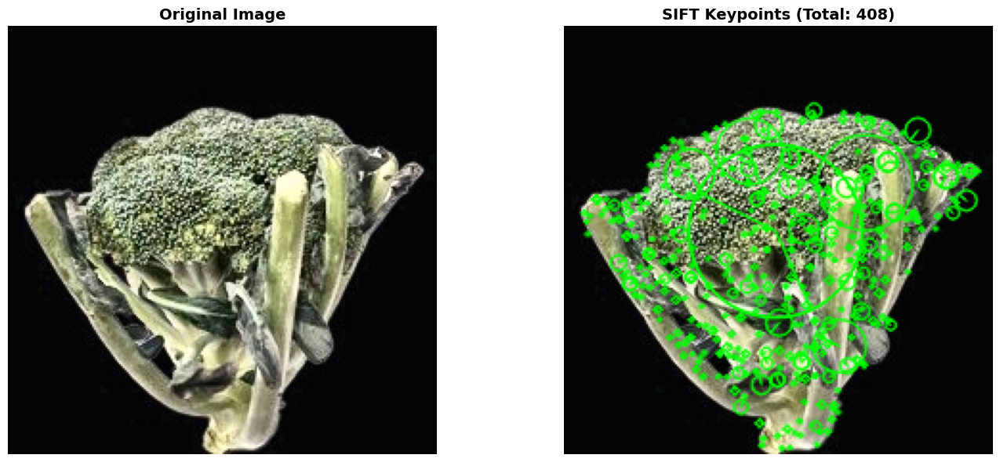

SIFT Feature Statistics:
  Number of keypoints: 408
  Descriptor mean: 26.5249
  Descriptor std: 36.6651
  Descriptor max: 209.0000
  Descriptor min: 0.0000

4. Color Histogram Features
--------------------------------------------------------------------------------


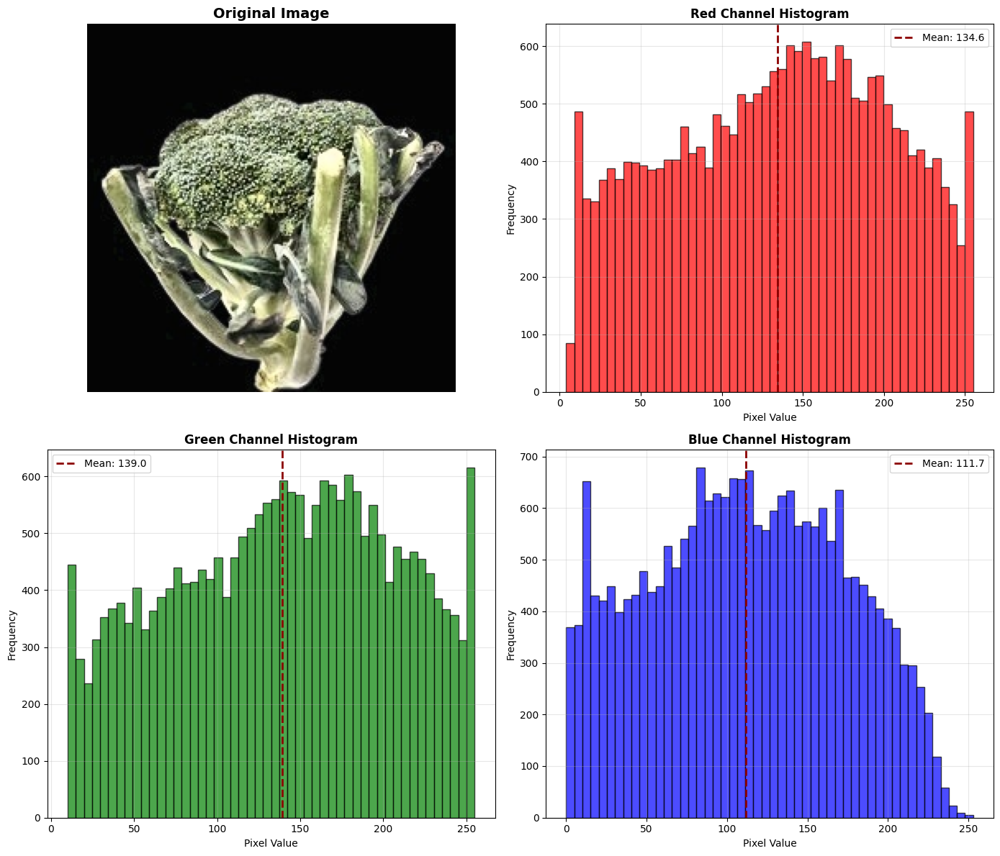

Color Feature Statistics:
  Red Channel:
    Mean: 134.55
    Std: 66.73
    Max: 255.00
    Min: 4.00
  Green Channel:
    Mean: 139.05
    Std: 66.41
    Max: 255.00
    Min: 10.00
  Blue Channel:
    Mean: 111.69
    Std: 60.46
    Max: 253.00
    Min: 0.00

5. Haralick Texture Features
--------------------------------------------------------------------------------


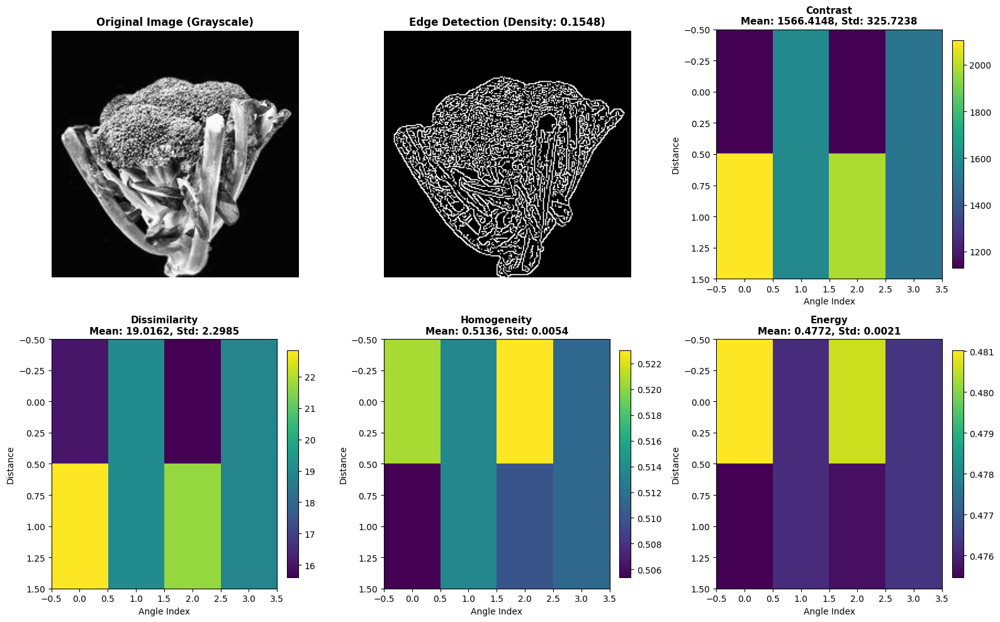

Haralick Texture Feature Statistics:
  Contrast:
    Mean: 1566.4148
    Std: 325.7238
  Dissimilarity:
    Mean: 19.0162
    Std: 2.2985
  Homogeneity:
    Mean: 0.5136
    Std: 0.0054
  Energy:
    Mean: 0.4772
    Std: 0.0021
  Correlation:
    Mean: 0.8732
    Std: 0.0263
  Asm:
    Mean: 0.2277
    Std: 0.0020
  Edge Density: 0.1548

6. Combined Feature Vector (44 features)
--------------------------------------------------------------------------------
  HOG features (5): [0.09321597 0.11633144 1.         0.         0.03987698]
  LBP features (6): [6.295166  2.6676292 9.        0.        8.        1.7454427]
  SIFT features (8): [ 27.20539  36.1623  189.        0.       11.        2.       37.
 408.     ]
  Color features (12): [134.55096   66.727646 255.         4.       139.04504   66.40591
 255.        10.       111.689896  60.45837  253.         0.      ]
  Haralick features (13): [1.5664148e+03 1.9016232e+01 5.1359785e-01 4.7721714e-01 8.7323552e-01
 2.2774054e-01 3.2572379e

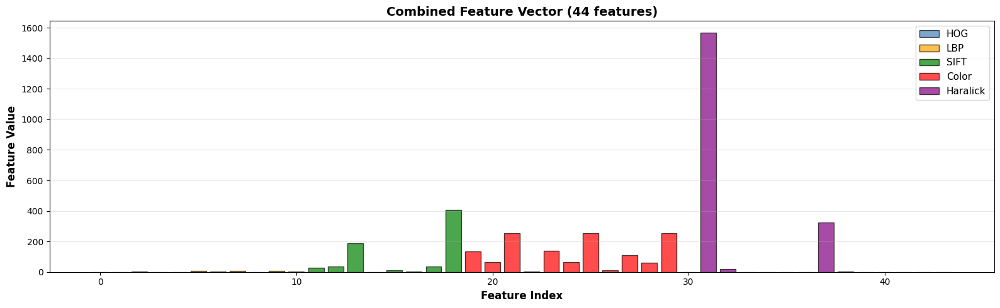

In [13]:
#@markdown Visualisasi Feature Extraction - Sayur Daun

if os.path.exists(TEST_DATASET_DIR):
    if len(sample_images) > 0 and os.path.exists(sample_images[2]):
        visualize_all_features(sample_images[2])

else:
    print(f"⚠️ Dataset directory not found: {TEST_DATASET_DIR}")
    print("Please update TEST_DATASET_DIR variable with correct path")

### Visualisasi Feature Extraction - Sayur Polong

Feature Extraction Visualization: Sayur Daun

1. HOG (Histogram of Oriented Gradients) Features
--------------------------------------------------------------------------------


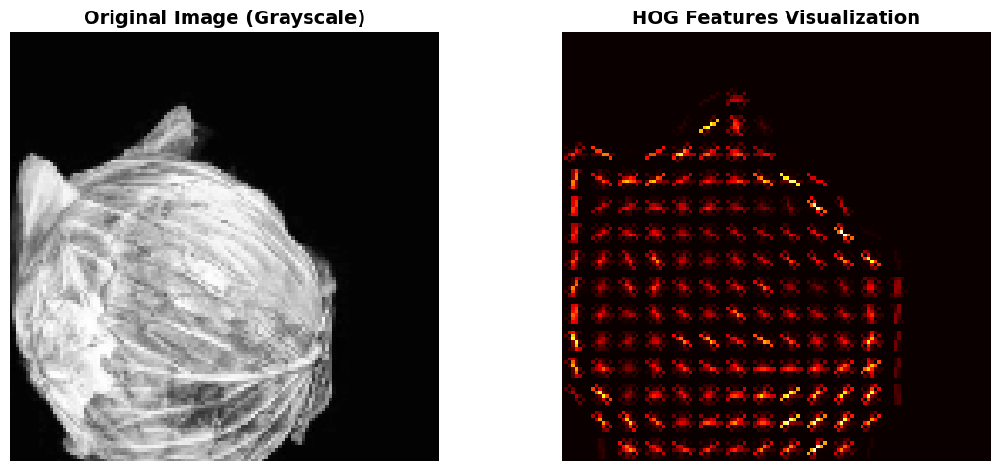

HOG Feature Statistics:
  Mean: 0.0860
  Std: 0.1117
  Max: 1.0000
  Min: 0.0000
  Median: 0.0309

2. LBP (Local Binary Pattern) Features
--------------------------------------------------------------------------------


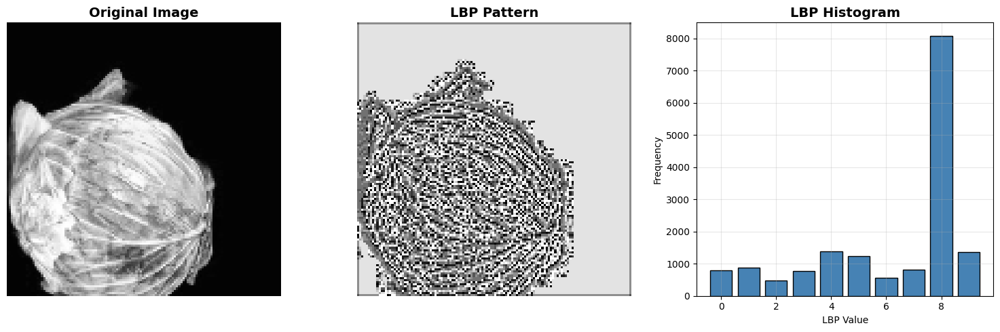

LBP Feature Statistics:
  Mean: 6.2281
  Std: 2.6668
  Entropy: 1.7753

3. SIFT (Scale-Invariant Feature Transform) Features
--------------------------------------------------------------------------------


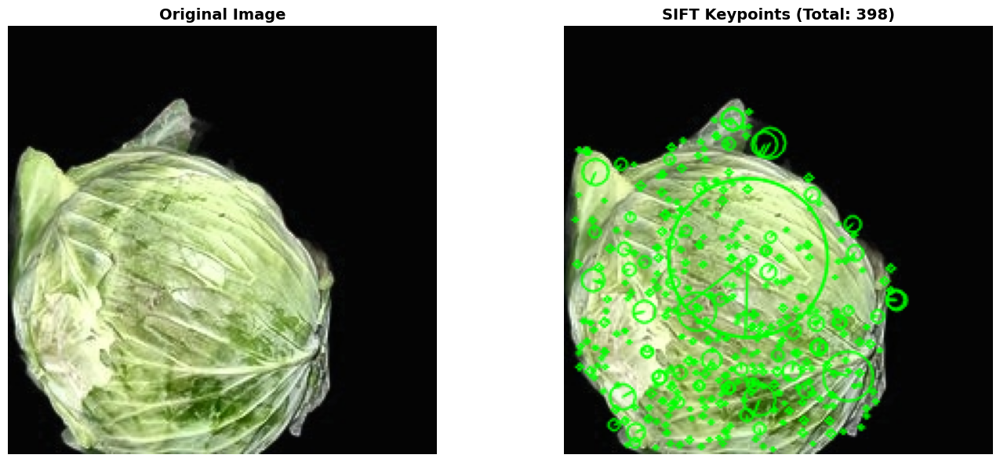

SIFT Feature Statistics:
  Number of keypoints: 398
  Descriptor mean: 26.8674
  Descriptor std: 36.4153
  Descriptor max: 207.0000
  Descriptor min: 0.0000

4. Color Histogram Features
--------------------------------------------------------------------------------


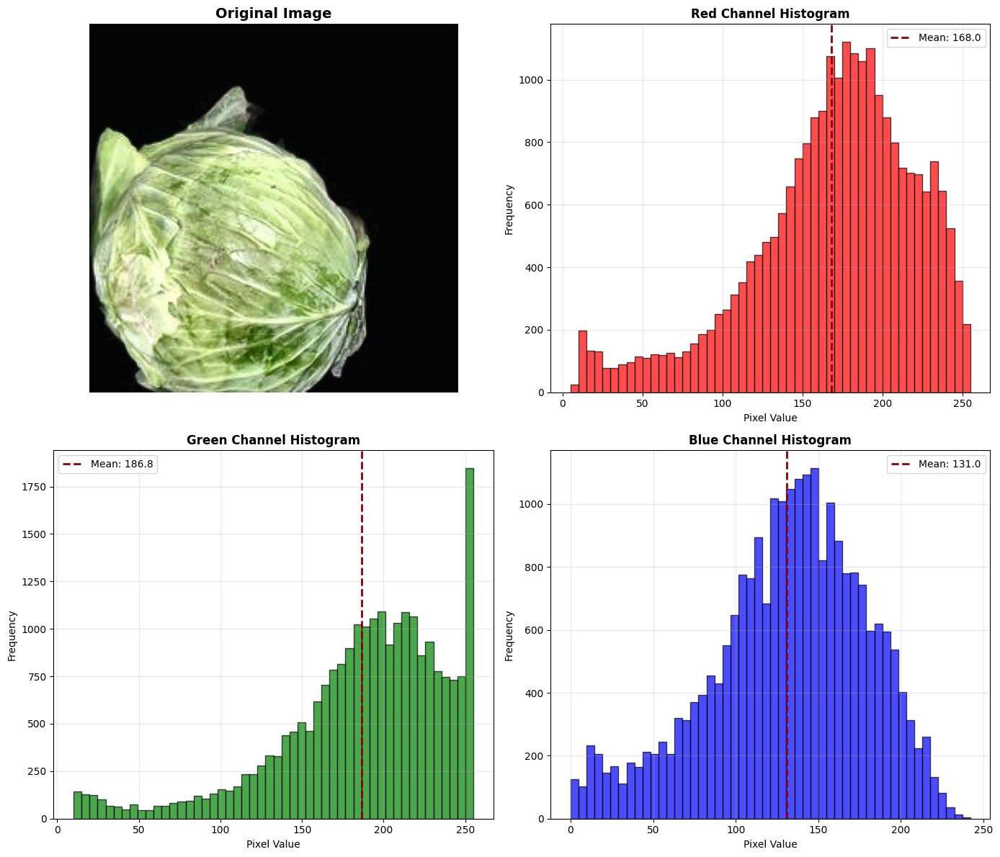

Color Feature Statistics:
  Red Channel:
    Mean: 167.97
    Std: 51.75
    Max: 255.00
    Min: 5.00
  Green Channel:
    Mean: 186.77
    Std: 51.87
    Max: 255.00
    Min: 10.00
  Blue Channel:
    Mean: 131.04
    Std: 47.86
    Max: 242.00
    Min: 0.00

5. Haralick Texture Features
--------------------------------------------------------------------------------


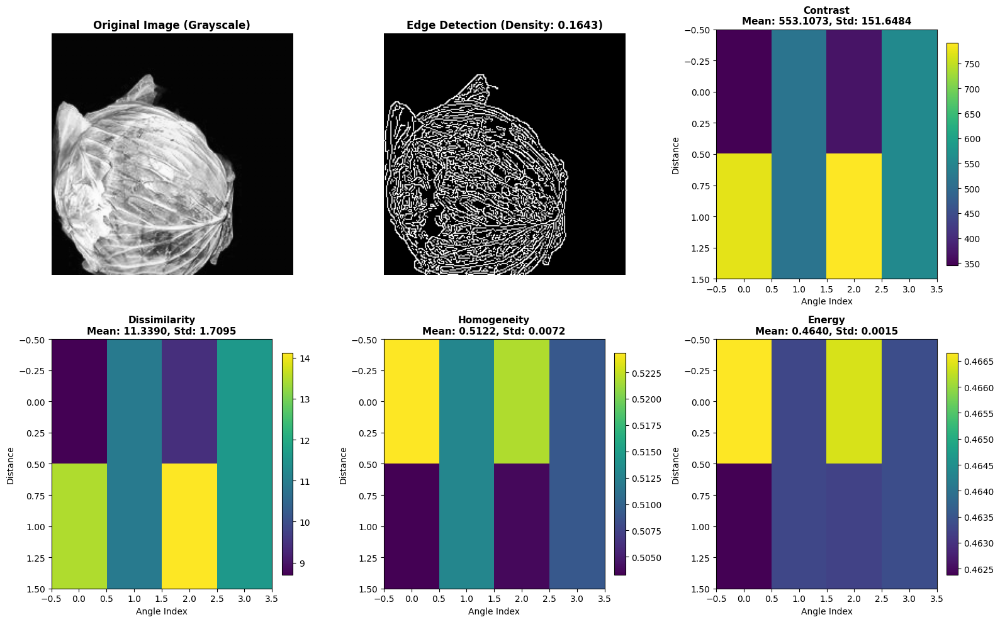

Haralick Texture Feature Statistics:
  Contrast:
    Mean: 553.1073
    Std: 151.6484
  Dissimilarity:
    Mean: 11.3390
    Std: 1.7095
  Homogeneity:
    Mean: 0.5122
    Std: 0.0072
  Energy:
    Mean: 0.4640
    Std: 0.0015
  Correlation:
    Mean: 0.9676
    Std: 0.0089
  Asm:
    Mean: 0.2153
    Std: 0.0014
  Edge Density: 0.1643

6. Combined Feature Vector (44 features)
--------------------------------------------------------------------------------
  HOG features (5): [0.08599642 0.11171911 1.         0.         0.0308513 ]
  LBP features (6): [6.2281494 2.6668353 9.        0.        8.        1.7753015]
  SIFT features (8): [ 24.398046  38.11205  207.         0.         7.         0.
  31.       398.      ]
  Color features (12): [167.96796   51.749775 255.         5.       186.77461   51.872223
 255.        10.       131.04146   47.863594 242.         0.      ]
  Haralick features (13): [5.5310730e+02 1.1338989e+01 5.1217186e-01 4.6400332e-01 9.6758848e-01
 2.1530131e-01 1.5

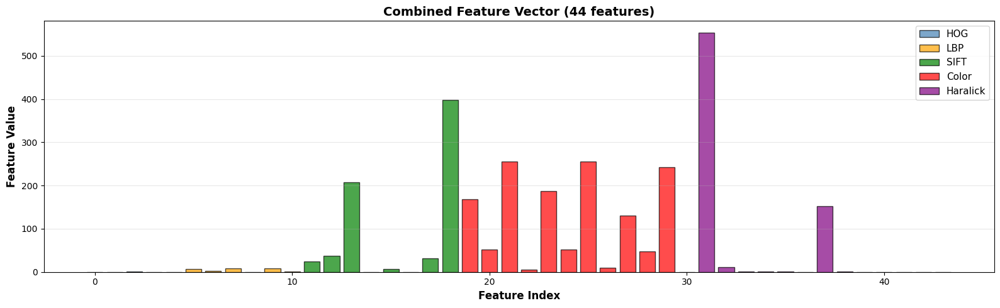

In [14]:
#@markdown Visualisasi Feature Extraction - Sayur Polong

if os.path.exists(TEST_DATASET_DIR):
    if len(sample_images) > 0 and os.path.exists(sample_images[3]):
        visualize_all_features(sample_images[3])

else:
    print(f"⚠️ Dataset directory not found: {TEST_DATASET_DIR}")
    print("Please update TEST_DATASET_DIR variable with correct path")

### Visualisasi perbandingan fitur antar kelas

# Classification

In [15]:
#@markdown ### Model.py - MLP Model V2
import torch.nn as nn

import torch
import torch.nn.functional as F

class ModelMLPV2(nn.Module):
    def __init__(
        self,
        num_features=TOTAL_FEAUTURES,
        num_classes=4,
        hidden_dims=[256, 512, 256, 128],
        dropout_rate=0.3,
        use_residual=True,
    ):
        super().__init__()
        self.use_residual = use_residual

        # Input normalization
        self.input_bn = nn.BatchNorm1d(num_features)

        # Build dynamic layer structure
        layers = []
        prev_dim = num_features

        for i, hidden_dim in enumerate(hidden_dims):
            # Main path
            block = nn.Sequential(
                nn.Linear(prev_dim, hidden_dim),
                nn.BatchNorm1d(hidden_dim),
                nn.ReLU(inplace=True),
                nn.Dropout(dropout_rate * (0.5 ** i))  # Decreasing dropout
            )
            layers.append(block)

            # Residual connection if dimensions match
            if use_residual and prev_dim == hidden_dim:
                layers.append(ResidualBlock(hidden_dim, dropout_rate * (0.5 ** i)))

            prev_dim = hidden_dim

        self.features = nn.Sequential(*layers)

        # Classification head with label smoothing support
        self.classifier = nn.Linear(prev_dim, num_classes)

        # Initialize weights
        self._initialize_weights()

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.BatchNorm1d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

    def forward(self, x):
        x = self.input_bn(x)
        x = self.features(x)
        x = self.classifier(x)
        return x


class ResidualBlock(nn.Module):
    """Residual block for skip connections"""
    def __init__(self, dim, dropout_rate):
        super().__init__()
        self.block = nn.Sequential(
            nn.Linear(dim, dim),
            nn.BatchNorm1d(dim),
            nn.ReLU(inplace=True),
            nn.Dropout(dropout_rate),
            nn.Linear(dim, dim),
            nn.BatchNorm1d(dim),
        )
        self.relu = nn.ReLU(inplace=True)

    def forward(self, x):
        residual = x
        out = self.block(x)
        out += residual  # Skip connection
        out = self.relu(out)
        return out


# Alternative: Attention-based MLP
class AttentionMLP(nn.Module):
    def __init__(
        self,
        num_features=44,
        num_classes=4,
        hidden_dim=256,
        dropout_rate=0.3,
    ):
        super().__init__()

        self.input_bn = nn.BatchNorm1d(num_features)

        # Feature extraction
        self.encoder = nn.Sequential(
            nn.Linear(num_features, hidden_dim),
            nn.BatchNorm1d(hidden_dim),
            nn.ReLU(inplace=True),
            nn.Dropout(dropout_rate),
        )

        # Self-attention mechanism
        self.attention = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim // 4),
            nn.Tanh(),
            nn.Linear(hidden_dim // 4, 1),
            nn.Softmax(dim=1)
        )

        # Classification layers
        self.classifier = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim // 2),
            nn.BatchNorm1d(hidden_dim // 2),
            nn.ReLU(inplace=True),
            nn.Dropout(dropout_rate * 0.5),
            nn.Linear(hidden_dim // 2, num_classes),
        )

        self._initialize_weights()

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)

    def forward(self, x):
        x = self.input_bn(x)
        features = self.encoder(x)

        # Apply attention (if batch processing multiple features)
        attn_weights = self.attention(features)
        weighted_features = features * attn_weights

        out = self.classifier(weighted_features)
        return out

In [16]:
# @markdown ### Preprocess.py - Preprocess, Feature Extraction untuk model

from torch.utils.data import Dataset
import torchvision.transforms as T
import cv2
import torch
# from extract_features import extract_all_features
# from segment import auto_segment
from concurrent.futures import ThreadPoolExecutor, as_completed
from multiprocessing import cpu_count
import gc


class FeatureDataset(Dataset):
    def __init__(
        self,
        img_paths,
        labels,
        img_size,
        use_segmentation=False,
        seg_method="hsv",
        cache_features=True,
        num_workers=None,
        max_cache_size_gb=4.0,  # Limit cache size to prevent memory issues
    ):
        self.img_paths = img_paths
        self.labels = labels
        self.img_size = img_size
        self.use_segmentation = use_segmentation
        self.seg_method = seg_method
        self.cache_features = cache_features
        self.feature_cache = {}
        self.max_cache_size_gb = max_cache_size_gb

        # Auto-detect number of workers if not specified
        if num_workers is None:
            # For I/O bound: 2x CPUs, but cap it to avoid thread overhead
            num_workers = min(cpu_count() * 2, 12)
        self.num_workers = num_workers

        # Image transformation
        self.transform = T.Compose(
            [
                T.ToTensor(),
                T.Resize((img_size, img_size), antialias=True),
                T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
            ]
        )

        # Preprocess all features if caching is enabled
        if self.cache_features:
            seg_status = (
                f"with {seg_method} segmentation"
                if use_segmentation
                else "without segmentation"
            )
            print(
                f"Preprocessing {len(img_paths)} images ({seg_status}, ALL 44 features)"
            )
            print(f"Using {self.num_workers} parallel workers")

            self._parallel_preprocess()
            print(f"✅ All features cached!")

    def _process_single_image(self, idx):
        """
        Worker function - processes image and extracts features
        """
        try:
            # Read image
            img = cv2.imread(self.img_paths[idx])

            if img is None:
                raise ValueError(f"Failed to load image at {self.img_paths[idx]}")

            # Apply segmentation if enabled
            if self.use_segmentation and self.seg_method != "none":
                img_processed = auto_segment(img.copy(), method=self.seg_method)
            else:
                img_processed = img

            # Extract features
            combined_feat = extract_all_features(
                img_processed,
                use_segmentation=False,
                seg_method="none",
            )

            # Store only features to save memory
            # We'll re-read images in __getitem__ (fast operation)

            return idx, combined_feat, None

        except Exception as e:
            return idx, None, str(e)

    def _parallel_preprocess(self):
        """Optimized parallel preprocessing with strategic memory cleanup at 25% intervals"""
        from tqdm import tqdm

        total_images = len(self.img_paths)
        failed_images = []
        processed_count = 0

        # Calculate cleanup checkpoints at 25%, 50%, 75%
        cleanup_intervals = [int(total_images * p) for p in [0.25, 0.5, 0.75]]

        # Use ThreadPoolExecutor with context manager for proper cleanup
        with ThreadPoolExecutor(
            max_workers=self.num_workers,
            thread_name_prefix="ImgPreproc"
        ) as executor:

            # Submit all tasks
            futures = {
                executor.submit(self._process_single_image, idx): idx
                for idx in range(total_images)
            }

            # Process results as they complete
            with tqdm(total=total_images, desc="Caching features", smoothing=0.1) as pbar:
                for future in as_completed(futures):
                    try:
                        idx, result, error = future.result()

                        if error is None and result is not None:
                            # Store only features, not images
                            self.feature_cache[idx] = result
                            processed_count += 1
                        else:
                            failed_images.append((idx, error))
                            print(f"\n⚠️ Failed to process image {idx}: {error}")

                        pbar.update(1)

                        # Strategic cleanup at 25%, 50%, 75% progress
                        if processed_count in cleanup_intervals:
                            progress = (processed_count / total_images) * 100
                            print(f"\n🧹 Cleanup at {progress:.0f}% ({processed_count}/{total_images})")
                            gc.collect()

                    except Exception as e:
                        print(f"\n⚠️ Error retrieving result: {e}")
                        failed_images.append((futures[future], str(e)))
                        pbar.update(1)

            # Final cleanup
            futures.clear()
            gc.collect()

        # Report failures
        if failed_images:
            print(f"\n⚠️ {len(failed_images)}/{total_images} images failed to process")
            print("Failed indices:", [idx for idx, _ in failed_images[:10]])
            if len(failed_images) > 10:
                print(f"... and {len(failed_images) - 10} more")

        success_rate = (total_images - len(failed_images)) / total_images * 100
        print(f"Success rate: {success_rate:.1f}%")
        print(f"Cached {len(self.feature_cache)} feature vectors")

    def _preprocess_and_cache(self, idx):
        """On-demand preprocessing (fallback)"""
        if idx in self.feature_cache:
            return self.feature_cache[idx]

        # Read image
        img = cv2.imread(self.img_paths[idx])

        if img is None:
            raise ValueError(f"Failed to load image at {self.img_paths[idx]}")

        # Apply segmentation if enabled
        if self.use_segmentation and self.seg_method != "none":
            img_processed = auto_segment(img.copy(), method=self.seg_method)
        else:
            img_processed = img

        combined_feat = extract_all_features(
            img_processed,
            use_segmentation=False,
            seg_method="none",
        )

        # Cache only features
        self.feature_cache[idx] = combined_feat

        return combined_feat

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        """
        CRITICAL FIX: Read images fresh each time to avoid memory bloat.
        Only cache the expensive feature extraction, not images.
        """

        # Get features (from cache or compute)
        if self.cache_features:
            if idx not in self.feature_cache:
                combined_feat = self._preprocess_and_cache(idx)
            else:
                combined_feat = self.feature_cache[idx]

            # Read image fresh (fast operation)
            img = cv2.imread(self.img_paths[idx])
            if img is None:
                raise ValueError(f"Failed to load image at {self.img_paths[idx]}")

            # Apply segmentation if needed
            if self.use_segmentation and self.seg_method != "none":
                img = auto_segment(img, method=self.seg_method)

            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        else:
            # No caching - compute everything fresh
            img = cv2.imread(self.img_paths[idx])

            if img is None:
                raise ValueError(f"Failed to load image at {self.img_paths[idx]}")

            combined_feat = extract_all_features(
                img, use_segmentation=self.use_segmentation, seg_method=self.seg_method
            )

            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Transform image to tensor
        img_tensor = self.transform(img_rgb)

        # Convert to tensors
        features_tensor = torch.tensor(combined_feat, dtype=torch.float32)
        label_tensor = torch.tensor(self.labels[idx], dtype=torch.long)

        return img_tensor, features_tensor, label_tensor

    def clear_cache(self):
        """Manually clear cache if needed"""
        self.feature_cache.clear()
        gc.collect()
        print("✅ Cache cleared")

In [17]:
#@markdown ### Helper Data Loader
import os
from glob import glob
from torch.utils.data import DataLoader
# from lib.preprocess import FeatureDataset


def load_dataset(
    dataset_dir,
    batch_size,
    num_workers,
    img_size,
    use_segmentation,
    seg_method,
    prefetch_factor,
    persistent_workers,
    pin_memory,
    cache_features,
):
    def load_split(split):
        split_dir = os.path.join(dataset_dir, split)
        class_names = sorted(os.listdir(split_dir))

        img_paths = []
        labels = []

        for idx, cls in enumerate(class_names):
            class_dir = os.path.join(split_dir, cls)
            images = glob(class_dir + "/*.*")
            img_paths.extend(images)
            labels.extend([idx] * len(images))

        return img_paths, labels, class_names

    # Load splits
    train_img, train_label, classes = load_split("train")
    val_img, val_label, _ = load_split("val")

    # datasets with all features and segmentation
    train_dataset = FeatureDataset(
        train_img, train_label, img_size, use_segmentation, seg_method, cache_features
    )
    val_dataset = FeatureDataset(
        val_img, val_label, img_size, use_segmentation, seg_method, cache_features
    )

    # GPU-Optimized DataLoader settings
    dataloader_kwargs = {
        "batch_size": batch_size,
        "num_workers": num_workers,
        "pin_memory": pin_memory,
        "persistent_workers": persistent_workers if num_workers > 0 else False,
        "prefetch_factor": prefetch_factor if num_workers > 0 else None,
    }

    train_loader = DataLoader(train_dataset, shuffle=True, **dataloader_kwargs)
    val_loader = DataLoader(val_dataset, shuffle=False, **dataloader_kwargs)

    seg_status = (
        f"with {seg_method} segmentation"
        if use_segmentation
        else "without segmentation"
    )
    cache_status = "(cached)" if cache_features else ""

    print(f"Dataset loaded ({seg_status} {cache_status}):")
    print(f"  {len(train_dataset)} train, {len(val_dataset)} val")
    print(f"  Classes: {classes}")

    return train_loader, val_loader, classes

In [18]:
#@markdown ### Helper set seed
import random


def set_torch_seed(seed: int = 42):
    """
    Fix all random-number generators that PyTorch (and common data-loading
    utilities) depend on so that experiments are reproducible.

    Parameters
    ----------
    seed : int
        The single integer seed to use for every generator.
    """
    # Python's built-in RNG (used by e.g. random_split, random.shuffle, ...)
    random.seed(seed)

    # Numpy RNG (used by some transforms, datasets, etc.)
    np.random.seed(seed)

    # PyTorch CPU & CUDA
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)  # multi-GPU

    # Tell cuDNN to use deterministic algorithms (may slow things down)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

    # Convenience message
    print(f"[RNG] PyTorch & auxiliary seeds set to {seed}")

## HyperParameters

In [19]:
class HyperParams:
  #@markdown ### Data parameters
  batch_size = 64 #@param {type:"integer"}
  img_size = 224 #@param {type:"integer"}
  num_workers = 0 #@param {type:"integer"}
  prefetch_factor = 2 #@param {type:"integer"}
  persistent_workers = True #@param {type:"boolean"}

  #@markdown ---
  #@markdown ### Training parameters
  epochs = 40 #@param {type:"integer"}
  lr = 1e-3  #@param {type:"number"}
  weight_decay = 1e-4 #@param {type:"number"}

  #@markdown ---
  #@markdown ### Model parameters
  num_classes = 5 #@param {type:"integer"}
  hidden_dims = [256, 512, 256, 128] #@param
  use_residual=True #@param {type:"boolean"}
  dropout_rate = 0.3 #@param {type:"number"}

  #@markdown ---
  #@markdown ### Segmentation parameters
  use_segmentation = False #@param {type:"boolean"}
  segmentation_method = "u2netp" #@param ["grabcut", "adaptive", "hsv", "u2netp", "none"]
  cache_features = True #@param {type:"boolean"}

  #@markdown ---
  #@markdown ### Optimization parameters
  use_amp = True #@param {type:"boolean"}
  gradient_accumulation_steps = 1 #@param {type:"integer"}
  pin_memory = True #@param {type:"boolean"}

  #@markdown ---
  #@markdown ### Learning rate scheduler
  scheduler_type = "cosine" #@param ["cosine", "step", "reduce_on_plateau"]
  warmup_epochs = 5 #@param {type:"integer"}

  #@markdown ---
  #@markdown ### Regularization
  label_smoothing = 0.05 #@param {type:"number"}

  #@markdown ---
  #@markdown ### Experiment tracking
  run_name = "auto_clahe_split_train-30_val_70" #@param {type:"string"}
  save_best_only = True #@param {type:"boolean"}
  early_stopping_patience = 40 #@param {type:"integer"}

  #@markdown ---
  #@markdown ### Model Selection
  RUN_MLP = True #@param {type:"boolean"}
  RUN_SVM = True #@param {type:"boolean"}
  RUN_EFFICIENTNETV2S = True #@param {type:"boolean"}
  
  #@markdown ---
  #@markdown ### EfficientNetV2Model
  pretrained = False #@param {type:"boolean"}
  freeze_backbone = False #@param {type:"boolean"}

  #@markdown ---
  #@markdown ### Replicate
  seed = 42 #@param {type:"integer"}

set_torch_seed(HyperParams.seed)


[RNG] PyTorch & auxiliary seeds set to 42


## Dataset Loader

In [20]:
dataset_dir = "./dataset_prepared/30_train" #@param {type:"string"}

print(f'dataset dir: {dataset_dir}')

train_loader, val_loader, class_names = load_dataset(
    dataset_dir,
    batch_size=HyperParams.batch_size,
    num_workers=HyperParams.num_workers,
    img_size=HyperParams.img_size,
    use_segmentation=HyperParams.use_segmentation,
    seg_method=HyperParams.segmentation_method,
    prefetch_factor=HyperParams.prefetch_factor,
    persistent_workers=HyperParams.persistent_workers,
    pin_memory=HyperParams.pin_memory,
    cache_features=HyperParams.cache_features,
)

dataset dir: ./dataset_prepared/30_train
Preprocessing 3272 images (without segmentation, ALL 44 features)
Using 12 parallel workers


Caching features:  25%|██▌       | 819/3272 [00:27<01:20, 30.37it/s]


🧹 Cleanup at 25% (818/3272)


Caching features:  50%|████▉     | 1634/3272 [00:53<00:50, 32.28it/s]


🧹 Cleanup at 50% (1636/3272)


Caching features:  75%|███████▌  | 2457/3272 [01:20<00:27, 29.91it/s]


🧹 Cleanup at 75% (2454/3272)


Caching features: 100%|██████████| 3272/3272 [01:46<00:00, 30.79it/s]


Success rate: 100.0%
Cached 3272 feature vectors
✅ All features cached!
Preprocessing 7627 images (without segmentation, ALL 44 features)
Using 12 parallel workers


Caching features:  25%|██▌       | 1909/7627 [01:00<03:06, 30.72it/s]


🧹 Cleanup at 25% (1906/7627)


Caching features:  50%|████▉     | 3813/7627 [02:01<01:55, 32.91it/s]


🧹 Cleanup at 50% (3813/7627)


Caching features:  75%|███████▌  | 5722/7627 [03:01<01:05, 29.02it/s]


🧹 Cleanup at 75% (5720/7627)


Caching features: 100%|██████████| 7627/7627 [04:02<00:00, 31.47it/s]


Success rate: 100.0%
Cached 7627 feature vectors
✅ All features cached!
Dataset loaded (without segmentation (cached)):
  3272 train, 7627 val
  Classes: ['Sayur_Akar', 'Sayur_Buah', 'Sayur_Bunga', 'Sayur_Daun', 'Sayur_Polong']


## Model Training
### MLP

In [21]:
# @markdown #### MLP Training

if HyperParams.RUN_MLP:
    import torch
    import torch.nn as nn
    from torch.utils.tensorboard import SummaryWriter
    from torch.optim.lr_scheduler import CosineAnnealingLR, StepLR, ReduceLROnPlateau
    from tqdm import tqdm
    import os

    # Setup
    # ========================================
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    if torch.cuda.is_available():
        print(f"GPU: {torch.cuda.get_device_name(0)}")
        print(
            f"GPU Memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB"
        )

    # Model, Loss, Optimizer
    # ========================================
    model = ModelMLPV2(
        num_features=TOTAL_FEAUTURES,
        num_classes=HyperParams.num_classes,
        dropout_rate=HyperParams.dropout_rate,
        hidden_dims=HyperParams.hidden_dims,
        use_residual=HyperParams.use_residual,
    ).to(device)

    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total parameters: {total_params:,}")
    print(f"Trainable parameters: {trainable_params:,}")

    # Loss function
    criterion = nn.CrossEntropyLoss(label_smoothing=HyperParams.label_smoothing)

    # Optimizer
    optimizer = torch.optim.AdamW(
        model.parameters(), lr=HyperParams.lr, weight_decay=HyperParams.weight_decay
    )

    # Learning rate scheduler
    if HyperParams.scheduler_type == "cosine":
        scheduler = CosineAnnealingLR(optimizer, T_max=HyperParams.epochs, eta_min=2e-5)
    elif HyperParams.scheduler_type == "step":
        scheduler = StepLR(optimizer, step_size=10, gamma=0.1)
    elif HyperParams.scheduler_type == "reduce_on_plateau":
        scheduler = ReduceLROnPlateau(
            optimizer, mode="min", factor=0.5, patience=3, min_lr=1e-5
        )
    else:
        scheduler = None

    # Mixed precision scaler
    scaler = torch.amp.GradScaler(device, enabled=HyperParams.use_amp)

    # TensorBoard writer
    writer = SummaryWriter(log_dir=os.path.join("runs", f"mlp-{HyperParams.run_name}"))

    # Model checkpoint directory
    save_dir = os.path.join("models", f"mlp-{HyperParams.run_name}")
    os.makedirs(save_dir, exist_ok=True)

    # Training Loop
    # ========================================
    best_val_acc = 0.0
    early_stop_counter = 0

    for epoch in range(HyperParams.epochs):
        print(f"\n{'='*60}")
        print(f"Epoch {epoch+1}/{HyperParams.epochs}")
        print(f"{'='*60}")

        # -------------------- Training --------------------
        model.train()
        train_loss = 0.0
        train_correct = 0
        train_total = 0

        pbar = tqdm(train_loader, desc=f"Training")
        for batch_idx, (images, handcrafted_features, labels) in enumerate(pbar):
            # Move data to GPU (non_blocking for async transfer)
            images = images.to(device, non_blocking=True)
            handcrafted_features = handcrafted_features.to(device, non_blocking=True)
            labels = labels.to(device, non_blocking=True)

            # Zero gradients
            optimizer.zero_grad(set_to_none=True)  # Faster than zero_grad()

            # Mixed precision forward pass
            with torch.amp.autocast(str(device), enabled=HyperParams.use_amp):
                outputs = model(handcrafted_features)
                loss = criterion(outputs, labels)

            # Backward pass
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            # Statistics
            train_loss += loss.item()
            _, predicted = outputs.max(1)
            train_total += labels.size(0)
            train_correct += predicted.eq(labels).sum().item()

            # Update progress bar
            pbar.set_postfix(
                {
                    "loss": f"{train_loss/(batch_idx+1):.4f}",
                    "acc": f"{100.*train_correct/train_total:.2f}%",
                }
            )

        train_loss_avg = train_loss / len(train_loader)
        train_acc = 100.0 * train_correct / train_total

        # -------------------- Validation --------------------
        model.eval()
        val_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            pbar = tqdm(val_loader, desc=f"Validation")
            for batch_idx, (images, handcrafted_features, labels) in enumerate(pbar):
                images = images.to(device, non_blocking=True)
                handcrafted_features = handcrafted_features.to(device, non_blocking=True)
                labels = labels.to(device, non_blocking=True)

                with torch.amp.autocast(str(device), enabled=HyperParams.use_amp):
                    outputs = model(handcrafted_features)
                    loss = criterion(outputs, labels)

                val_loss += loss.item()
                _, predicted = outputs.max(1)
                val_total += labels.size(0)
                val_correct += predicted.eq(labels).sum().item()

                pbar.set_postfix(
                    {
                        "loss": f"{val_loss/(batch_idx+1):.4f}",
                        "acc": f"{100.*val_correct/val_total:.2f}%",
                    }
                )

        val_loss_avg = val_loss / len(val_loader)
        val_acc = 100.0 * val_correct / val_total

        # -------------------- Logging --------------------
        current_lr = optimizer.param_groups[0]["lr"]

        print(f"\nResults:")
        print(f"  Train Loss: {train_loss_avg:.4f} | Train Acc: {train_acc:.2f}%")
        print(f"  Val Loss:   {val_loss_avg:.4f} | Val Acc:   {val_acc:.2f}%")
        print(f"  Learning Rate: {current_lr:.6f}")

        if torch.cuda.is_available():
            print(f"  GPU Memory: {torch.cuda.max_memory_allocated()/1e9:.2f} GB")
            torch.cuda.reset_peak_memory_stats()

        # TensorBoard logging
        writer.add_scalar(f"Loss/train", train_loss_avg, epoch)
        writer.add_scalar(f"Loss/val", val_loss_avg, epoch)
        writer.add_scalar(f"Accuracy/train", train_acc, epoch)
        writer.add_scalar(f"Accuracy/val", val_acc, epoch)
        writer.add_scalar(f"LR", current_lr, epoch)

        # -------------------- Scheduler Step --------------------
        if scheduler:
            if isinstance(scheduler, ReduceLROnPlateau):
                scheduler.step(val_acc)
            else:
                scheduler.step()

        # -------------------- Model Checkpoint --------------------
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            early_stop_counter = 0

            # Convert HyperParams to dict (avoid mappingproxy pickle error)
            hyperparams_dict = {
                "batch_size": HyperParams.batch_size,
                "img_size": HyperParams.img_size,
                "epochs": HyperParams.epochs,
                "lr": HyperParams.lr,
                "weight_decay": HyperParams.weight_decay,
                "num_classes": HyperParams.num_classes,
                "dropout_rate": HyperParams.dropout_rate,
                "scheduler_type": HyperParams.scheduler_type,
                "label_smoothing": HyperParams.label_smoothing,
                "use_segmentation": HyperParams.use_segmentation,
                "segmentation_method": HyperParams.segmentation_method,
                "hidden_dims": HyperParams.hidden_dims,
                "use_residual": HyperParams.use_residual,
            }

            checkpoint = {
                "epoch": epoch + 1,
                "model_state_dict": model.state_dict(),
                "optimizer_state_dict": optimizer.state_dict(),
                "scheduler_state_dict": scheduler.state_dict() if scheduler else None,
                "best_val_acc": best_val_acc,
                "val_loss": val_loss_avg,
                "hyperparams": hyperparams_dict,
            }

            torch.save(checkpoint, os.path.join(save_dir, "best_model.pth"))
            print(f"  ✓ Best model saved! (Val Acc: {best_val_acc:.2f}%)")
        else:
            early_stop_counter += 1
            print(
                f"  Early stopping counter: {early_stop_counter}/{HyperParams.early_stopping_patience}"
            )

        # Early stopping
        if early_stop_counter >= HyperParams.early_stopping_patience:
            print(f"\n⚠ Early stopping triggered after {epoch+1} epochs")
            break

        # Save last checkpoint
        if not HyperParams.save_best_only:
            torch.save(
                checkpoint, os.path.join(save_dir, f"checkpoint_epoch_{epoch+1}.pth")
            )

    writer.close()
    print(f"\n{'='*60}")
    print(f"MLP Training Complete!")
    print(f"Best Validation Accuracy: {best_val_acc:.2f}%")
    print(f"Model saved to: {save_dir}")
    print(f"{'='*60}")

else:
    print("MLP training skipped (RUN_MLP = False)")


Using device: cuda
GPU: NVIDIA GeForce RTX 3060
GPU Memory: 12.88 GB
Total parameters: 310,365
Trainable parameters: 310,365

Epoch 1/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 17.06it/s, loss=0.9519, acc=84.75%]



Results:
  Train Loss: 2.6967 | Train Acc: 57.89%
  Val Loss:   0.9519 | Val Acc:   84.75%
  Learning Rate: 0.001000
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 84.75%)

Epoch 2/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.57it/s, loss=0.8727, acc=87.11%]



Results:
  Train Loss: 1.0602 | Train Acc: 80.68%
  Val Loss:   0.8727 | Val Acc:   87.11%
  Learning Rate: 0.000998
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 87.11%)

Epoch 3/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.67it/s, loss=0.6457, acc=90.74%]



Results:
  Train Loss: 0.9169 | Train Acc: 82.85%
  Val Loss:   0.6457 | Val Acc:   90.74%
  Learning Rate: 0.000994
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 90.74%)

Epoch 4/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.90it/s, loss=0.5765, acc=91.56%]



Results:
  Train Loss: 0.8496 | Train Acc: 83.68%
  Val Loss:   0.5765 | Val Acc:   91.56%
  Learning Rate: 0.000986
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 91.56%)

Epoch 5/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.43it/s, loss=0.5308, acc=92.50%]



Results:
  Train Loss: 0.7890 | Train Acc: 85.21%
  Val Loss:   0.5308 | Val Acc:   92.50%
  Learning Rate: 0.000976
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 92.50%)

Epoch 6/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.84it/s, loss=0.5380, acc=91.57%]



Results:
  Train Loss: 0.7043 | Train Acc: 86.46%
  Val Loss:   0.5380 | Val Acc:   91.57%
  Learning Rate: 0.000963
  GPU Memory: 0.06 GB
  Early stopping counter: 1/40

Epoch 7/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.69it/s, loss=0.4884, acc=92.96%]



Results:
  Train Loss: 0.6253 | Train Acc: 87.29%
  Val Loss:   0.4884 | Val Acc:   92.96%
  Learning Rate: 0.000947
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 92.96%)

Epoch 8/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.56it/s, loss=0.4651, acc=93.12%]



Results:
  Train Loss: 0.6186 | Train Acc: 88.14%
  Val Loss:   0.4651 | Val Acc:   93.12%
  Learning Rate: 0.000928
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 93.12%)

Epoch 9/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.71it/s, loss=0.4498, acc=93.75%]



Results:
  Train Loss: 0.5759 | Train Acc: 89.12%
  Val Loss:   0.4498 | Val Acc:   93.75%
  Learning Rate: 0.000906
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 93.75%)

Epoch 10/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.58it/s, loss=0.4351, acc=93.71%]



Results:
  Train Loss: 0.5838 | Train Acc: 89.52%
  Val Loss:   0.4351 | Val Acc:   93.71%
  Learning Rate: 0.000883
  GPU Memory: 0.06 GB
  Early stopping counter: 1/40

Epoch 11/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.88it/s, loss=0.4291, acc=93.58%]



Results:
  Train Loss: 0.5515 | Train Acc: 88.88%
  Val Loss:   0.4291 | Val Acc:   93.58%
  Learning Rate: 0.000856
  GPU Memory: 0.06 GB
  Early stopping counter: 2/40

Epoch 12/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 17.12it/s, loss=0.4283, acc=94.20%]



Results:
  Train Loss: 0.5092 | Train Acc: 90.65%
  Val Loss:   0.4283 | Val Acc:   94.20%
  Learning Rate: 0.000828
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 94.20%)

Epoch 13/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.87it/s, loss=0.4122, acc=94.27%]



Results:
  Train Loss: 0.5161 | Train Acc: 90.37%
  Val Loss:   0.4122 | Val Acc:   94.27%
  Learning Rate: 0.000798
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 94.27%)

Epoch 14/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.69it/s, loss=0.4104, acc=94.39%]



Results:
  Train Loss: 0.5047 | Train Acc: 91.32%
  Val Loss:   0.4104 | Val Acc:   94.39%
  Learning Rate: 0.000766
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 94.39%)

Epoch 15/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.80it/s, loss=0.4027, acc=94.31%]



Results:
  Train Loss: 0.4886 | Train Acc: 91.20%
  Val Loss:   0.4027 | Val Acc:   94.31%
  Learning Rate: 0.000732
  GPU Memory: 0.06 GB
  Early stopping counter: 1/40

Epoch 16/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 17.07it/s, loss=0.4111, acc=94.38%]



Results:
  Train Loss: 0.4846 | Train Acc: 90.95%
  Val Loss:   0.4111 | Val Acc:   94.38%
  Learning Rate: 0.000698
  GPU Memory: 0.06 GB
  Early stopping counter: 2/40

Epoch 17/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.90it/s, loss=0.4010, acc=94.55%]



Results:
  Train Loss: 0.4785 | Train Acc: 91.81%
  Val Loss:   0.4010 | Val Acc:   94.55%
  Learning Rate: 0.000661
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 94.55%)

Epoch 18/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.80it/s, loss=0.3877, acc=94.93%]



Results:
  Train Loss: 0.4860 | Train Acc: 92.45%
  Val Loss:   0.3877 | Val Acc:   94.93%
  Learning Rate: 0.000624
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 94.93%)

Epoch 19/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.52it/s, loss=0.3987, acc=94.48%]



Results:
  Train Loss: 0.4636 | Train Acc: 91.96%
  Val Loss:   0.3987 | Val Acc:   94.48%
  Learning Rate: 0.000587
  GPU Memory: 0.06 GB
  Early stopping counter: 1/40

Epoch 20/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 17.04it/s, loss=0.3943, acc=95.04%]



Results:
  Train Loss: 0.4591 | Train Acc: 92.63%
  Val Loss:   0.3943 | Val Acc:   95.04%
  Learning Rate: 0.000548
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 95.04%)

Epoch 21/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 17.01it/s, loss=0.3853, acc=94.99%]



Results:
  Train Loss: 0.4561 | Train Acc: 92.51%
  Val Loss:   0.3853 | Val Acc:   94.99%
  Learning Rate: 0.000510
  GPU Memory: 0.06 GB
  Early stopping counter: 1/40

Epoch 22/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 15.94it/s, loss=0.3862, acc=94.93%]



Results:
  Train Loss: 0.4336 | Train Acc: 92.88%
  Val Loss:   0.3862 | Val Acc:   94.93%
  Learning Rate: 0.000472
  GPU Memory: 0.06 GB
  Early stopping counter: 2/40

Epoch 23/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.79it/s, loss=0.3796, acc=95.27%]



Results:
  Train Loss: 0.4591 | Train Acc: 92.91%
  Val Loss:   0.3796 | Val Acc:   95.27%
  Learning Rate: 0.000433
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 95.27%)

Epoch 24/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 17.02it/s, loss=0.3756, acc=95.31%]



Results:
  Train Loss: 0.4489 | Train Acc: 92.91%
  Val Loss:   0.3756 | Val Acc:   95.31%
  Learning Rate: 0.000396
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 95.31%)

Epoch 25/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.88it/s, loss=0.3808, acc=95.50%]



Results:
  Train Loss: 0.4432 | Train Acc: 93.15%
  Val Loss:   0.3808 | Val Acc:   95.50%
  Learning Rate: 0.000359
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 95.50%)

Epoch 26/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.77it/s, loss=0.3767, acc=95.12%]



Results:
  Train Loss: 0.4195 | Train Acc: 93.98%
  Val Loss:   0.3767 | Val Acc:   95.12%
  Learning Rate: 0.000322
  GPU Memory: 0.06 GB
  Early stopping counter: 1/40

Epoch 27/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.81it/s, loss=0.3769, acc=95.48%]



Results:
  Train Loss: 0.4355 | Train Acc: 93.49%
  Val Loss:   0.3769 | Val Acc:   95.48%
  Learning Rate: 0.000288
  GPU Memory: 0.06 GB
  Early stopping counter: 2/40

Epoch 28/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.73it/s, loss=0.3751, acc=95.45%]



Results:
  Train Loss: 0.4246 | Train Acc: 93.70%
  Val Loss:   0.3751 | Val Acc:   95.45%
  Learning Rate: 0.000254
  GPU Memory: 0.06 GB
  Early stopping counter: 3/40

Epoch 29/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.54it/s, loss=0.3720, acc=95.63%]



Results:
  Train Loss: 0.4256 | Train Acc: 93.70%
  Val Loss:   0.3720 | Val Acc:   95.63%
  Learning Rate: 0.000222
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 95.63%)

Epoch 30/40


Validation: 100%|██████████| 120/120 [00:06<00:00, 17.14it/s, loss=0.3666, acc=95.74%]



Results:
  Train Loss: 0.4129 | Train Acc: 94.19%
  Val Loss:   0.3666 | Val Acc:   95.74%
  Learning Rate: 0.000192
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 95.74%)

Epoch 31/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.36it/s, loss=0.3692, acc=95.61%]



Results:
  Train Loss: 0.4067 | Train Acc: 94.04%
  Val Loss:   0.3692 | Val Acc:   95.61%
  Learning Rate: 0.000164
  GPU Memory: 0.06 GB
  Early stopping counter: 1/40

Epoch 32/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.82it/s, loss=0.3681, acc=95.69%]



Results:
  Train Loss: 0.4007 | Train Acc: 94.38%
  Val Loss:   0.3681 | Val Acc:   95.69%
  Learning Rate: 0.000137
  GPU Memory: 0.06 GB
  Early stopping counter: 2/40

Epoch 33/40


Validation: 100%|██████████| 120/120 [00:06<00:00, 17.20it/s, loss=0.3715, acc=95.75%]



Results:
  Train Loss: 0.4157 | Train Acc: 93.98%
  Val Loss:   0.3715 | Val Acc:   95.75%
  Learning Rate: 0.000114
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 95.75%)

Epoch 34/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.82it/s, loss=0.3685, acc=95.35%]



Results:
  Train Loss: 0.4056 | Train Acc: 94.41%
  Val Loss:   0.3685 | Val Acc:   95.35%
  Learning Rate: 0.000092
  GPU Memory: 0.06 GB
  Early stopping counter: 1/40

Epoch 35/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.46it/s, loss=0.3665, acc=95.75%]



Results:
  Train Loss: 0.4055 | Train Acc: 94.56%
  Val Loss:   0.3665 | Val Acc:   95.75%
  Learning Rate: 0.000073
  GPU Memory: 0.06 GB
  Early stopping counter: 2/40

Epoch 36/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.36it/s, loss=0.3649, acc=95.48%]



Results:
  Train Loss: 0.4117 | Train Acc: 93.92%
  Val Loss:   0.3649 | Val Acc:   95.48%
  Learning Rate: 0.000057
  GPU Memory: 0.06 GB
  Early stopping counter: 3/40

Epoch 37/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.62it/s, loss=0.3677, acc=95.66%]



Results:
  Train Loss: 0.4227 | Train Acc: 94.01%
  Val Loss:   0.3677 | Val Acc:   95.66%
  Learning Rate: 0.000044
  GPU Memory: 0.06 GB
  Early stopping counter: 4/40

Epoch 38/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.48it/s, loss=0.3661, acc=95.65%]



Results:
  Train Loss: 0.4264 | Train Acc: 94.07%
  Val Loss:   0.3661 | Val Acc:   95.65%
  Learning Rate: 0.000034
  GPU Memory: 0.06 GB
  Early stopping counter: 5/40

Epoch 39/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 16.59it/s, loss=0.3684, acc=95.79%]



Results:
  Train Loss: 0.4210 | Train Acc: 94.25%
  Val Loss:   0.3684 | Val Acc:   95.79%
  Learning Rate: 0.000026
  GPU Memory: 0.06 GB
  ✓ Best model saved! (Val Acc: 95.79%)

Epoch 40/40


Validation: 100%|██████████| 120/120 [00:07<00:00, 17.07it/s, loss=0.3725, acc=95.66%]


Results:
  Train Loss: 0.4026 | Train Acc: 94.83%
  Val Loss:   0.3725 | Val Acc:   95.66%
  Learning Rate: 0.000022
  GPU Memory: 0.06 GB
  Early stopping counter: 1/40

MLP Training Complete!
Best Validation Accuracy: 95.79%
Model saved to: models\mlp-auto_clahe_split_train-30_val_70


## Testing & evaluation

### Metrics

In [22]:
#@markdown ### plt tensorboard
import matplotlib.pyplot as plt
from tensorboard.backend.event_processing import event_accumulator
import os

# Fungsi untuk memuat data dari TensorBoard log
def load_tensorboard_data(log_dir, tags):
    """
    Memuat data dari TensorBoard event files

    Args:
        log_dir: Path ke direktori log TensorBoard
        tags: List of tag names yang ingin dimuat (e.g., ['Loss/train', 'Loss/val'])

    Returns:
        Dictionary dengan key=tag, value=dict{'steps': [], 'values': []}
    """
    ea = event_accumulator.EventAccumulator(log_dir)
    ea.Reload()

    data = {}
    for tag in tags:
        try:
            events = ea.Scalars(tag)
            steps = [e.step for e in events]
            values = [e.value for e in events]
            data[tag] = {'steps': steps, 'values': values}
        except KeyError:
            print(f"Tag '{tag}' tidak ditemukan di log")

    return data

# Fungsi untuk plotting
def plot_tensorboard_data(runs_name, tags_to_plot=None):
    """
    Memuat dan menampilkan data dari TensorBoard log

    Args:
        runs_name: Nama run (subdirektori di dalam 'runs/')
        tags_to_plot: List of tags untuk diplot. Default: Loss dan Accuracy
    """
    log_dir = os.path.join("runs", runs_name)

    if not os.path.exists(log_dir):
        print(f"Direktori log tidak ditemukan: {log_dir}")
        return

    # Default tags jika tidak dispesifikasi
    if tags_to_plot is None:
        tags_to_plot = ['Loss/train', 'Loss/val', 'Accuracy/train', 'Accuracy/val', 'LR']

    # Load data
    data = load_tensorboard_data(log_dir, tags_to_plot)

    if not data:
        print("Tidak ada data yang dimuat")
        return

    # Plotting
    # Pisahkan Loss, Accuracy, dan LR
    loss_tags = [tag for tag in data.keys() if 'Loss' in tag]
    acc_tags = [tag for tag in data.keys() if 'Accuracy' in tag]
    lr_tags = [tag for tag in data.keys() if 'LR' in tag]

    num_plots = (1 if loss_tags else 0) + (1 if acc_tags else 0) + (1 if lr_tags else 0)

    if num_plots == 0:
        print("Tidak ada data untuk diplot")
        return

    fig, axes = plt.subplots(1, num_plots, figsize=(6*num_plots, 5))
    if num_plots == 1:
        axes = [axes]

    plot_idx = 0

    # Plot Loss
    if loss_tags:
        ax = axes[plot_idx]
        for tag in loss_tags:
            label = tag.split('/')[-1]  # train/val
            ax.plot(data[tag]['steps'], data[tag]['values'], label=label, marker='o', markersize=3)
        ax.set_xlabel('Epoch')
        ax.set_ylabel('Loss')
        ax.set_title(f'Training Loss - {runs_name}')
        ax.legend()
        ax.grid(True, alpha=0.3)
        plot_idx += 1

    # Plot Accuracy
    if acc_tags:
        ax = axes[plot_idx]
        for tag in acc_tags:
            label = tag.split('/')[-1]  # train/val
            ax.plot(data[tag]['steps'], data[tag]['values'], label=label, marker='o', markersize=3)
        ax.set_xlabel('Epoch')
        ax.set_ylabel('Accuracy (%)')
        ax.set_title(f'Training Accuracy - {runs_name}')
        ax.legend()
        ax.grid(True, alpha=0.3)
        plot_idx += 1

    # Plot Learning Rate
    if lr_tags:
        ax = axes[plot_idx]
        for tag in lr_tags:
            ax.plot(data[tag]['steps'], data[tag]['values'], label='Learning Rate', marker='o', markersize=3, color='orange')
        ax.set_xlabel('Epoch')
        ax.set_ylabel('Learning Rate')
        ax.set_title(f'Learning Rate Schedule - {runs_name}')
        ax.legend()
        ax.grid(True, alpha=0.3)
        ax.set_yscale('log')  # Log scale untuk LR

    plt.tight_layout()
    plt.show()

    # Print summary statistics
    print(f"\n{'='*60}")
    print(f"Summary for: {runs_name}")
    print(f"{'='*60}")
    for tag, values in data.items():
        if values['values']:
            print(f"{tag}:")
            print(f"  Final: {values['values'][-1]:.4f}")
            print(f"  Best: {max(values['values']) if 'Accuracy' in tag else min(values['values']):.4f}")

try:
    plot_tensorboard_data(HyperParams.run_name)
except NameError:
    # Jika HyperParams belum didefinisikan, gunakan nama run secara manual
    # Ganti dengan nama folder di dalam direktori 'runs/'
    available_runs = os.listdir("runs") if os.path.exists("runs") else []
    print("Available runs:", available_runs)

    if available_runs:
        # Plot run terbaru atau spesifik
        runs_name = available_runs[-1]  # Run terakhir
        print(f"\nMemuat data dari run: {runs_name}")
        plot_tensorboard_data(runs_name)
    else:
        print("Tidak ada runs yang tersedia di direktori 'runs/'")

Direktori log tidak ditemukan: runs\auto_clahe_split_train-30_val_70



Classification Report
              precision    recall  f1-score   support

  Sayur_Akar       0.95      0.99      0.97      1740
  Sayur_Buah       0.97      0.97      0.97      3933
 Sayur_Bunga       0.97      0.93      0.95      1073
  Sayur_Daun       0.89      0.93      0.91       691
Sayur_Polong       0.95      0.69      0.80       190

    accuracy                           0.96      7627
   macro avg       0.95      0.90      0.92      7627
weighted avg       0.96      0.96      0.96      7627



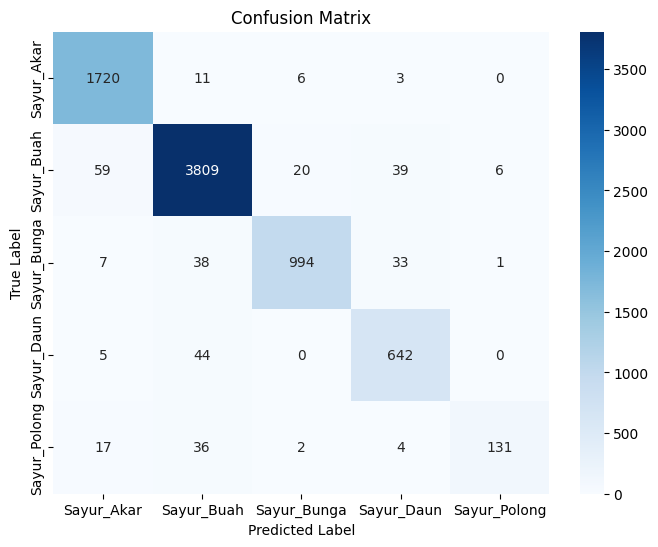

In [23]:
#@markdown #### Classification Report
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

model.eval()
model.to(device)

all_labels = []
all_preds = []

with torch.no_grad():
    for images, handcrafted_features, labels in val_loader:
        handcrafted_features = handcrafted_features.to(device, non_blocking=True)
        labels = labels.to(device, non_blocking=True)

        with torch.amp.autocast(str(device), enabled=HyperParams.use_amp):
            outputs = model(handcrafted_features)
            _, predicted = outputs.max(1)

        all_labels.extend(labels.cpu().numpy())
        all_preds.extend(predicted.cpu().numpy())

# Convert to numpy arrays
all_labels = np.array(all_labels)
all_preds = np.array(all_preds)

print("\n" + "="*60)
print("Classification Report")
print("="*60)
print(classification_report(all_labels, all_preds, target_names=class_names))

# Compute confusion matrix
cm = confusion_matrix(all_labels, all_preds)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(
    cm,
    annot=True,
    fmt="d",
    cmap="Blues",
    xticklabels=class_names,
    yticklabels=class_names,
)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

### Tensorboard

In [24]:
#@markdown ### Launch Tensorboard
#@markdown ---
#@markdown #### Load history

LOAD_B1 = False # @param {"type":"boolean"}
LOAD_B2 = False # @param {"type":"boolean"}
LOAD_B3 = False # @param {"type":"boolean"}
LOAD_EXTRACT_FEATURES_DIFF = False # @param {"type":"boolean"}

if LOAD_B1:
    gdown.download(
        id="1DWzgqq2aktQt27ALUGfG_Ly5Sn4zesQu",
        output="./B1.zip",
        quiet=True,
    )
    # Extract zip file
    with zipfile.ZipFile('./B1.zip', 'r') as zip_ref:
        zip_ref.extractall('./runs')

if LOAD_B2:
    gdown.download(
        id="10cIoaB-7sa6rcqP8Uu9LWNdde6TYB8Ta",
        output="./B2.zip",
        quiet=True,
    )
    # Extract zip file
    with zipfile.ZipFile('./B2.zip', 'r') as zip_ref:
        zip_ref.extractall('./runs')

if LOAD_B3:
    gdown.download(
        id="1qh1lXg6H54tRj_QHaViIH1vUmq3FwZPP",
        output="./B2.zip",
        quiet=True,
    )
    # Extract zip file
    with zipfile.ZipFile('./B2.zip', 'r') as zip_ref:
        zip_ref.extractall('./runs')

if LOAD_EXTRACT_FEATURES_DIFF:
    gdown.download(
        id="1_enSdzkqP8-spPxuycxQRG2aH59-lw06",
        output="./B2.zip",
        quiet=True,
    )
    # Extract zip file
    with zipfile.ZipFile('./B2.zip', 'r') as zip_ref:
        zip_ref.extractall('./runs')

# Load TensorBoard extension
%load_ext tensorboard

# Launch TensorBoard
%tensorboard --logdir runs


Reusing TensorBoard on port 6006 (pid 10312), started 18:17:42 ago. (Use '!kill 10312' to kill it.)

### Gradio

In [25]:
# @markdown ### app_gradio.py

USE_MODEL = "training" #@param ["training", "prod_mlpv2_auto_clahe"]

gdown_id = ""

os.makedirs("./models", exist_ok=True)
dw_path = f"./models/{USE_MODEL}.pth"

if USE_MODEL == "prod_mlpv2_auto_clahe":
  # !wget -O {dw_path} https://raw.githubusercontent.com/petrusthelastking/PBL-2025/refs/heads/main/PCVK/api/models/mlpv2_auto-clahe.pth
  wget.download('https://raw.githubusercontent.com/petrusthelastking/PBL-2025/refs/heads/main/PCVK/api/services/classification/models/mlpv2_auto-clahe.pth', dw_path)

import gradio as gr
import torch
import cv2
import numpy as np
from PIL import Image
import sys
import os
from typing import Tuple, Dict

# Add lib directory to path
# sys.path.append(os.path.join(os.path.dirname(__file__), "lib"))

# from lib.model_v2 import ModelMLPV2
# from lib.extract_features import extract_all_features
# from lib.segment import auto_segment


# Konfigurasi
MODEL_PATH = (
    os.path.join(save_dir, "best_model.pth")
    # os.path.join(os.getcwd(), "models", "R3-70_seed-42_ep-60_auto-clahe_early-15_smooth-0.1_drop-0.5", "best_model.pth")
    if USE_MODEL == "training"
    else os.path.join(os.getcwd(), "models", f"{USE_MODEL}.pth")
)
CLASS_NAMES = ["Sayur Akar", "Sayur Buah", "Sayur Bunga", "Sayur Daun", "Sayur Polong"]
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load model
print("Loading model...")
model = ModelMLPV2(
    num_features=TOTAL_FEAUTURES,
    num_classes=len(CLASS_NAMES),
    dropout_rate=HyperParams.dropout_rate,
    hidden_dims=HyperParams.hidden_dims,
    use_residual=HyperParams.use_residual,
)
checkpoint = torch.load(MODEL_PATH, map_location=DEVICE)

# Handle different checkpoint formats
if isinstance(checkpoint, dict) and "model_state_dict" in checkpoint:
    model.load_state_dict(checkpoint["model_state_dict"])
else:
    model.load_state_dict(checkpoint)

model = model.to(DEVICE)
model.eval()
print(f"Model loaded successfully on {DEVICE}")


def predict_image(
    image,
    use_segmentation=True,
    seg_method="hsv",
    use_custom_params=False,
    # HSV parameters
    hsv_h_lower=20,
    hsv_s_lower=40,
    hsv_v_lower=40,
    hsv_h_upper=180,
    hsv_s_upper=255,
    hsv_v_upper=255,
    # GrabCut parameters
    grabcut_iterations=5,
    # Adaptive threshold parameters
    adaptive_kernel_size=5,
):
    """
    Prediksi gambar sayuran

    Args:
        image: PIL Image atau numpy array
        use_segmentation: Apakah menggunakan segmentasi
        seg_method: Metode segmentasi ('hsv', 'grabcut', 'adaptive', 'none')
        hsv_h_lower, hsv_s_lower, hsv_v_lower: Lower bounds untuk HSV
        hsv_h_upper, hsv_s_upper, hsv_v_upper: Upper bounds untuk HSV
        grabcut_iterations: Jumlah iterasi untuk GrabCut
        adaptive_kernel_size: Ukuran kernel untuk adaptive threshold

    Returns:
        Tuple (label, confidences_dict, segmented_image)
    """
    try:
        # Convert PIL Image to numpy array (BGR for OpenCV)
        if isinstance(image, Image.Image):
            image_np = np.array(image)
            # Convert RGB to BGR
            image_bgr = cv2.cvtColor(image_np, cv2.COLOR_RGB2BGR)
            image_bgr = cv2.resize(image_bgr, (224, 224))
        else:
            image_bgr = image

        # Apply segmentation if enabled
        if use_segmentation and seg_method != "none":
            if seg_method == "hsv":
                segmented_img = segment_hsv_color(
                    image_bgr.copy(),
                    lower_bound=(
                        (hsv_h_lower, hsv_s_lower, hsv_v_lower)
                        if use_custom_params
                        else (20, 40, 40)
                    ),
                    upper_bound=(
                        (hsv_h_upper, hsv_s_upper, hsv_v_upper)
                        if use_custom_params
                        else (180, 255, 255)
                    ),
                )
            elif seg_method == "grabcut":
                segmented_img = segment_grabcut(
                    image_bgr.copy(),
                    iterations=grabcut_iterations if use_custom_params else 5,
                )
            elif seg_method == "adaptive":
                segmented_img = segment_adaptive_threshold(
                    image_bgr.copy(),
                    kernel_size=adaptive_kernel_size if use_custom_params else 5,
                )
            else:
                segmented_img = auto_segment(image_bgr.copy(), method=seg_method)
        else:
            segmented_img = image_bgr.copy()

        # Extract features (44 features total)
        features = extract_all_features(
            apply_clahe(apply_automatic_brightness_contrast(segmented_img)),
            use_segmentation=False,  # Already segmented above
            seg_method="none",
        )

        # Convert to tensor
        features_tensor = torch.tensor(features, dtype=torch.float32).unsqueeze(0)
        features_tensor = features_tensor.to(DEVICE)

        # Predict
        with torch.no_grad():
            outputs = model(features_tensor)
            probabilities = torch.softmax(outputs, dim=1)
            confidence, predicted = torch.max(probabilities, 1)

            # Get all class probabilities
            probs = probabilities[0].cpu().numpy()

        # Prepare results
        predicted_class = CLASS_NAMES[predicted.item()]
        confidence_value = confidence.item()

        # Create confidence dictionary for all classes
        confidences = {CLASS_NAMES[i]: float(probs[i]) for i in range(len(CLASS_NAMES))}

        # Convert segmented image back to RGB for display
        segmented_rgb = cv2.cvtColor(segmented_img, cv2.COLOR_BGR2RGB)

        return predicted_class, confidences, segmented_rgb

    except Exception as e:
        print(f"Error during prediction: {e}")
        import traceback

        traceback.print_exc()
        return f"Error: {str(e)}", {}, None


def gradio_predict(
    image,
    use_segmentation,
    seg_method,
    use_custom_params,
    hsv_h_lower,
    hsv_s_lower,
    hsv_v_lower,
    hsv_h_upper,
    hsv_s_upper,
    hsv_v_upper,
    grabcut_iterations,
    adaptive_kernel_size,
):
    """
    Wrapper function untuk Gradio interface
    """
    predicted_class, confidences, segmented_img = predict_image(
        image,
        use_segmentation,
        seg_method,
        use_custom_params,
        hsv_h_lower,
        hsv_s_lower,
        hsv_v_lower,
        hsv_h_upper,
        hsv_s_upper,
        hsv_v_upper,
        grabcut_iterations,
        adaptive_kernel_size,
    )

    # Format output
    result_text = f"**Prediksi:** {predicted_class}\n\n**Confidence:** {confidences.get(predicted_class, 0):.2%}"

    return result_text, confidences, segmented_img


# Create Gradio interface
with gr.Blocks(title="Klasifikasi Sayuran") as demo:
    gr.Markdown(
        """
        # 🥬 Sistem Klasifikasi Sayuran

        Upload gambar sayuran untuk mengklasifikasikannya ke dalam 4 kategori:
        - **Sayur Akar** (wortel, lobak, dll)
        - **Sayur Buah** (tomat, terong, cabai, dll)
        - **Sayur Daun** (bayam, sawi, kangkung, dll)
        - **Sayur Polong** (kacang panjang, buncis, dll)

        Model menggunakan MLP dengan ekstraksi fitur: 44 (HOG: 5, LBP: 6, SIFT: 8, Color-Histogram: 12, Haralick: 13).
        """
    )

    with gr.Row():
        with gr.Column():
            input_image = gr.Image(type="pil", label="Upload Gambar Sayuran")

            with gr.Accordion("Pengaturan Segmentasi", open=False):
                use_seg = gr.Checkbox(
                    value=True,
                    label="Gunakan Segmentasi",
                    info="Memisahkan objek dari background",
                )
                seg_method = gr.Radio(
                    choices=["hsv", "grabcut", "adaptive", "u2netp", "none"],
                    value="hsv",
                    label="Metode Segmentasi",
                    info="HSV: berdasarkan warna, GrabCut: berbasis grafik, Adaptive: threshold adaptif, U2Net-P: deep learning",
                )

                use_custom_params = gr.Checkbox(
                    value=False,
                    label="Gunakan Parameter Custom",
                    info="Centang untuk mengatur parameter secara manual",
                )

                # HSV Parameters
                with gr.Group(visible=True) as hsv_params:
                    gr.Markdown("**Parameter HSV**")
                    with gr.Row():
                        hsv_h_lower = gr.Slider(
                            minimum=0,
                            maximum=179,
                            value=20,
                            step=1,
                            label="Hue Lower",
                            info="Batas bawah Hue (0-179)",
                            interactive=False,
                        )
                        hsv_h_upper = gr.Slider(
                            minimum=0,
                            maximum=179,
                            value=179,
                            step=1,
                            label="Hue Upper",
                            info="Batas atas Hue (0-179)",
                            interactive=False,
                        )
                    with gr.Row():
                        hsv_s_lower = gr.Slider(
                            minimum=0,
                            maximum=255,
                            value=40,
                            step=1,
                            label="Saturation Lower",
                            info="Batas bawah Saturasi (0-255)",
                            interactive=False,
                        )
                        hsv_s_upper = gr.Slider(
                            minimum=0,
                            maximum=255,
                            value=255,
                            step=1,
                            label="Saturation Upper",
                            info="Batas atas Saturasi (0-255)",
                            interactive=False,
                        )
                    with gr.Row():
                        hsv_v_lower = gr.Slider(
                            minimum=0,
                            maximum=255,
                            value=40,
                            step=1,
                            label="Value Lower",
                            info="Batas bawah Value (0-255)",
                            interactive=False,
                        )
                        hsv_v_upper = gr.Slider(
                            minimum=0,
                            maximum=255,
                            value=255,
                            step=1,
                            label="Value Upper",
                            info="Batas atas Value (0-255)",
                            interactive=False,
                        )

                # GrabCut Parameters
                with gr.Group(visible=False) as grabcut_params:
                    gr.Markdown("**Parameter GrabCut**")
                    grabcut_iterations = gr.Slider(
                        minimum=1,
                        maximum=10,
                        value=5,
                        step=1,
                        label="Iterasi",
                        info="Jumlah iterasi GrabCut (1-10)",
                        interactive=False,
                    )

                # Adaptive Threshold Parameters
                with gr.Group(visible=False) as adaptive_params:
                    gr.Markdown("**Parameter Adaptive Threshold**")
                    adaptive_kernel_size = gr.Slider(
                        minimum=3,
                        maximum=15,
                        value=5,
                        step=2,
                        label="Kernel Size",
                        info="Ukuran kernel morfologi (ganjil)",
                        interactive=False,
                    )

                # Update parameter visibility based on selected method
                def update_params_visibility(method):
                    return {
                        hsv_params: gr.update(visible=(method == "hsv")),
                        grabcut_params: gr.update(visible=(method == "grabcut")),
                        adaptive_params: gr.update(visible=(method == "adaptive")),
                    }

                # Update slider interactivity based on custom params checkbox
                def update_sliders_interactivity(use_custom):
                    return [
                        gr.update(interactive=use_custom),  # hsv_h_lower
                        gr.update(interactive=use_custom),  # hsv_h_upper
                        gr.update(interactive=use_custom),  # hsv_s_lower
                        gr.update(interactive=use_custom),  # hsv_s_upper
                        gr.update(interactive=use_custom),  # hsv_v_lower
                        gr.update(interactive=use_custom),  # hsv_v_upper
                        gr.update(interactive=use_custom),  # grabcut_iterations
                        gr.update(interactive=use_custom),  # adaptive_kernel_size
                    ]

                seg_method.change(
                    fn=update_params_visibility,
                    inputs=[seg_method],
                    outputs=[hsv_params, grabcut_params, adaptive_params],
                )

                use_custom_params.change(
                    fn=update_sliders_interactivity,
                    inputs=[use_custom_params],
                    outputs=[
                        hsv_h_lower,
                        hsv_h_upper,
                        hsv_s_lower,
                        hsv_s_upper,
                        hsv_v_lower,
                        hsv_v_upper,
                        grabcut_iterations,
                        adaptive_kernel_size,
                    ],
                )

            predict_btn = gr.Button("🔍 Klasifikasi", variant="primary", size="lg")

        with gr.Column():
            result_text = gr.Markdown(label="Hasil Prediksi")
            confidence_plot = gr.Label(label="Confidence Score", num_top_classes=4)
            segmented_output = gr.Image(label="Gambar Setelah Segmentasi")

    # Example images (will try to load from dataset if available)
    example_images = []
    train_path = "dataset_prepared/train"
    if os.path.exists(train_path):
        for class_name in CLASS_NAMES:
            # Convert class name to folder name
            folder_map = {
                "Sayur Akar": "Sayur_Akar",
                "Sayur Buah": "Sayur_Buah",
                "Sayur Bunga": "Sayur_Bunga",
                "Sayur Daun": "Sayur_Daun",
                "Sayur Polong": "Sayur_Polong",
            }
            folder_name = folder_map.get(class_name, class_name.replace(" ", "_"))
            class_path = os.path.join(train_path, folder_name)

            if os.path.exists(class_path):
                # Get first image from this class
                images = [
                    f
                    for f in os.listdir(class_path)
                    if f.lower().endswith((".png", ".jpg", ".jpeg"))
                ]
                if images:
                    example_images.append(
                        [os.path.join(class_path, images[0]), True, "hsv"]
                    )

    if example_images:
        gr.Markdown("### 📸 Contoh Gambar")
        gr.Examples(
            examples=example_images,
            inputs=[input_image, use_seg, seg_method],
            label="Klik untuk mencoba",
        )

    # Connect button to function
    predict_btn.click(
        fn=gradio_predict,
        inputs=[
            input_image,
            use_seg,
            seg_method,
            use_custom_params,
            hsv_h_lower,
            hsv_s_lower,
            hsv_v_lower,
            hsv_h_upper,
            hsv_s_upper,
            hsv_v_upper,
            grabcut_iterations,
            adaptive_kernel_size,
        ],
        outputs=[result_text, confidence_plot, segmented_output],
    )

LAUNCH_GRADIO = False  #@param {type:"boolean"}
if LAUNCH_GRADIO:
  demo.launch(server_name="0.0.0.0", server_port=7870, share=True, debug=False)

f:\NaniKaSuru\Polinema\PBL_SEM5\.venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Loading model...
Model loaded successfully on cuda


#### Shutdown gradio server

In [26]:
demo.close()

### Test data

In [27]:
#@markdown #### Helper plot test data
def plot_prediction_result(image_path, true_class, predicted_class, confidences, segmented_img):
    """
    Membuat plot dengan 3 panel:
    1. Gambar asli
    2. Gambar tersegmentasi
    3. Bar chart confidence untuk semua kelas
    """
    # Load gambar asli
    original_img = Image.open(image_path)
    original_img = original_img.resize((224, 224))

    # Buat figure dengan 3 subplot
    fig, axes = plt.subplots(1, 3, figsize=(15, 4))

    # Panel 1: Gambar asli
    axes[0].imshow(original_img)
    axes[0].set_title('Gambar Asli', fontsize=12, fontweight='bold')
    axes[0].axis('off')
    axes[0].text(0.5, -0.1, f'Ground Truth: {true_class}',
                 ha='center', va='top', transform=axes[0].transAxes,
                 fontsize=10, color='blue', fontweight='bold')

    # Panel 2: Gambar tersegmentasi
    if segmented_img is not None:
        axes[1].imshow(segmented_img)
        axes[1].set_title('Gambar Preprocess', fontsize=12, fontweight='bold')
        axes[1].axis('off')
    else:
        axes[1].text(0.5, 0.5, 'Preprocess Gagal',
                     ha='center', va='center', fontsize=12)
        axes[1].axis('off')

    # Panel 3: Bar chart confidence
    classes = list(confidences.keys())
    values = list(confidences.values())
    colors = ['green' if cls == predicted_class else 'lightblue' for cls in classes]

    bars = axes[2].barh(classes, values, color=colors)
    axes[2].set_xlabel('Confidence (%)', fontsize=10)
    axes[2].set_title('Prediksi Probabilitas', fontsize=12, fontweight='bold')
    axes[2].set_xlim(0, 1)

    # Tambahkan nilai pada bar
    for i, (bar, val) in enumerate(zip(bars, values)):
        axes[2].text(val + 0.02, bar.get_y() + bar.get_height()/2,
                     f'{val*100:.1f}%',
                     va='center', fontsize=9)

    # Tambahkan border hijau jika prediksi benar, merah jika salah
    is_correct = predicted_class == true_class
    border_color = 'green' if is_correct else 'red'
    border_width = 3

    for spine in fig.patch.get_children():
        if hasattr(spine, 'set_edgecolor'):
            spine.set_edgecolor(border_color)
            spine.set_linewidth(border_width)

    # Suptitle dengan status prediksi
    status = '✓ BENAR' if is_correct else '✗ SALAH'
    status_color = 'green' if is_correct else 'red'
    filename = os.path.basename(image_path)

    fig.suptitle(f'{filename}\nPrediksi: {predicted_class} | Status: {status}',
                 fontsize=13, fontweight='bold', color=status_color, y=1.02)

    plt.tight_layout()
    return fig, is_correct

Total gambar ditemukan: 30

Detail per class:
  Sayur Akar: 8 gambar
  Sayur Buah: 12 gambar
  Sayur Bunga: 5 gambar
  Sayur Daun: 3 gambar
  Sayur Polong: 2 gambar
Memproses gambar...

[1/30] Processing: 63eb1424512c5_20230214115500-1.jpg


C:\Users\Raruu\AppData\Local\Temp\ipykernel_7716\845153331.py:53: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  accumulator.append(float(hist[0]))
C:\Users\Raruu\AppData\Local\Temp\ipykernel_7716\845153331.py:55: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  accumulator.append(accumulator[index - 1] + float(hist[index]))


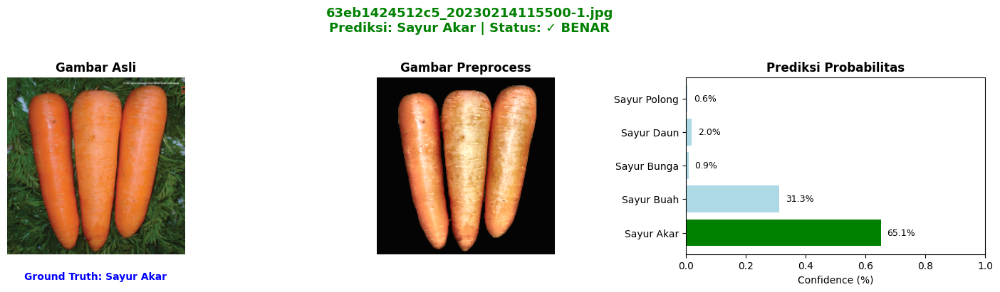

[2/30] Processing: lobak-putih-3.jpg


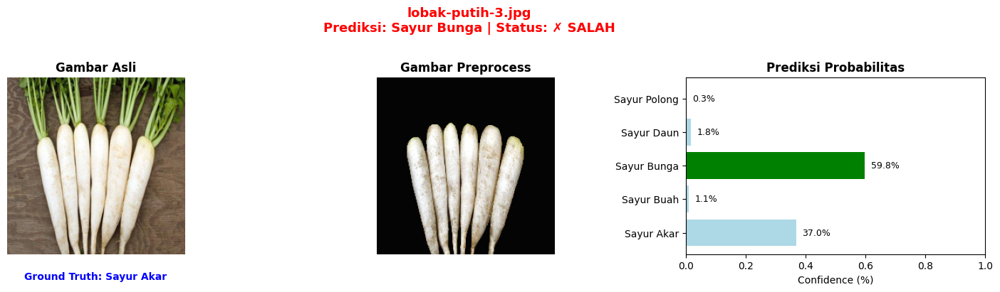

[3/30] Processing: maxresdefault.jpg


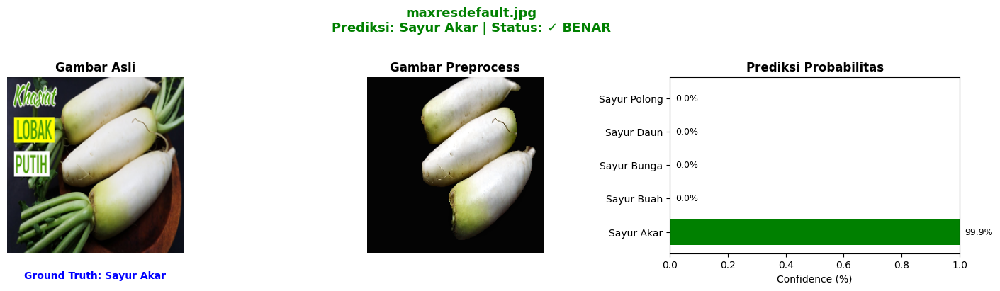

[4/30] Processing: im2age.jpeg


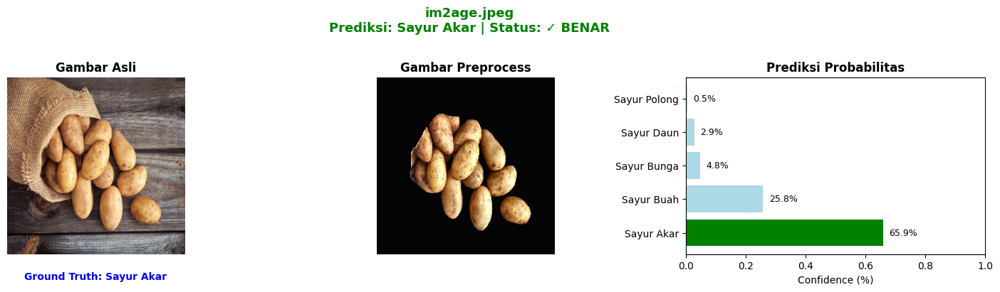

[5/30] Processing: 123clipboard.png


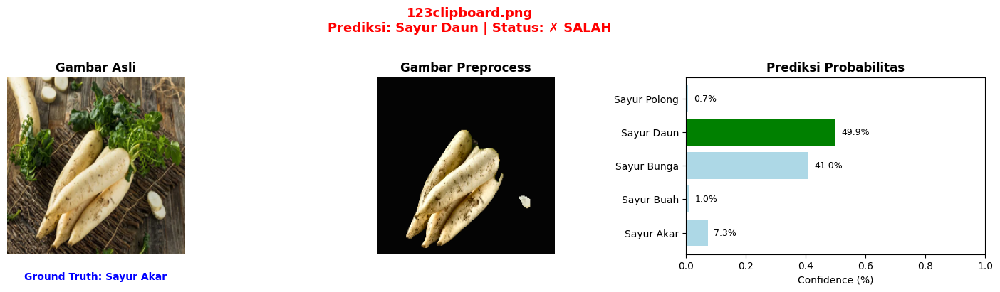

[6/30] Processing: clipb213oard.png


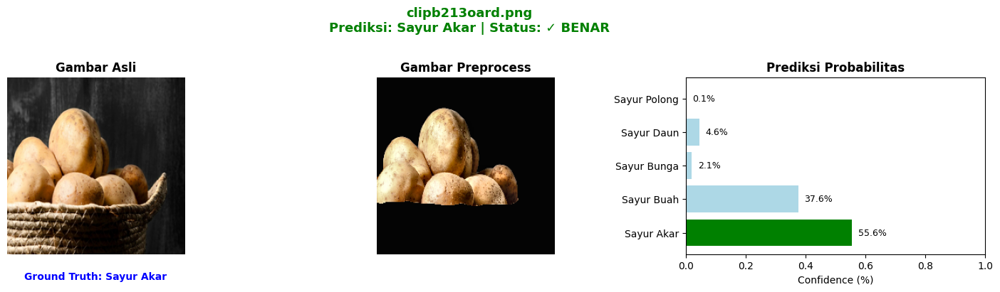

[7/30] Processing: clipboard.png


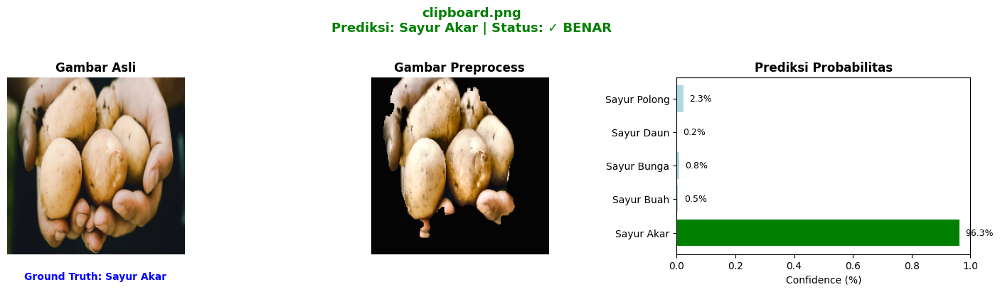

[8/30] Processing: tomewew.png


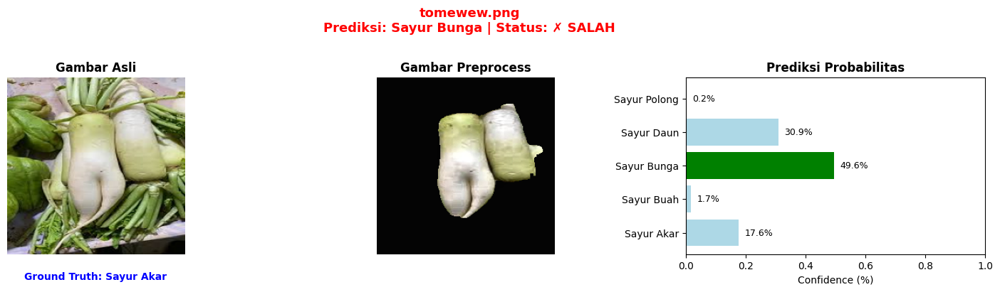

[9/30] Processing: 049edb45fe46b2074dc3e58a006da485.jpg


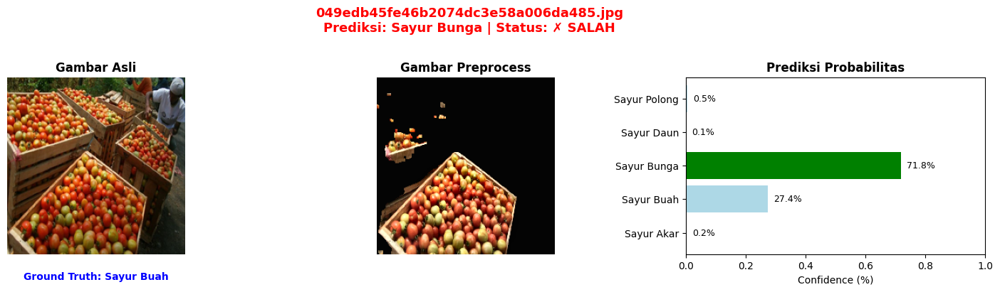

[10/30] Processing: image.jpg


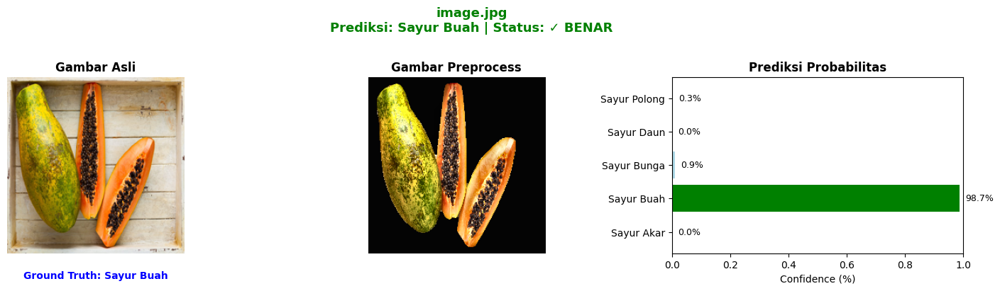

[11/30] Processing: images.jpeg


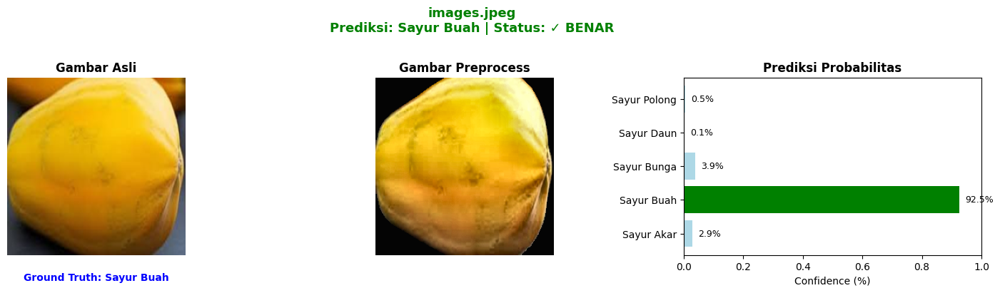

[12/30] Processing: premium_photo-1661811820259-2575b82101bf.jpeg


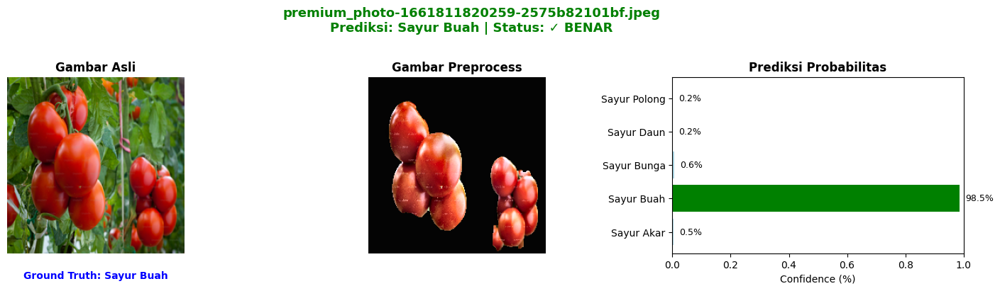

[13/30] Processing: 0clipboard.png


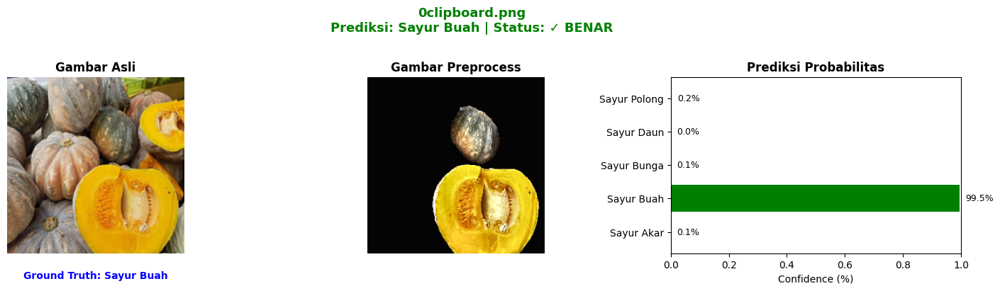

[14/30] Processing: 11clipboard.png


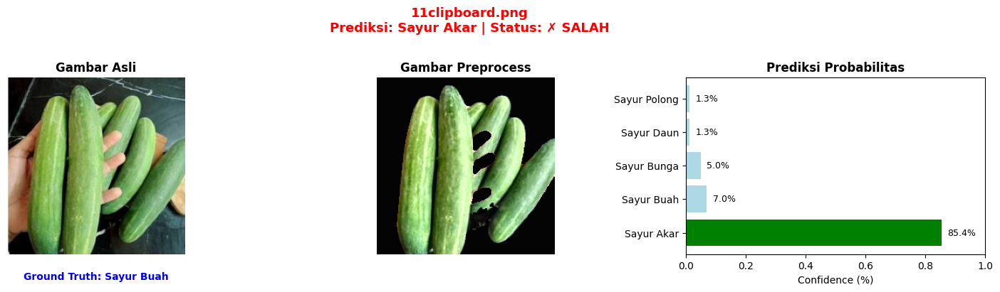

[15/30] Processing: 12clipboard.png


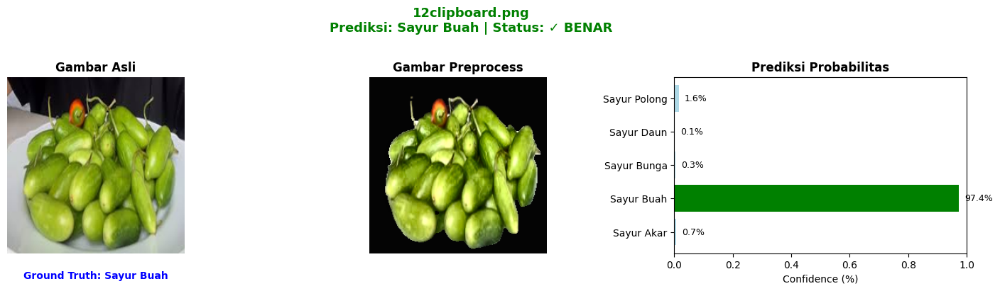

[16/30] Processing: brinajkclipboard.png


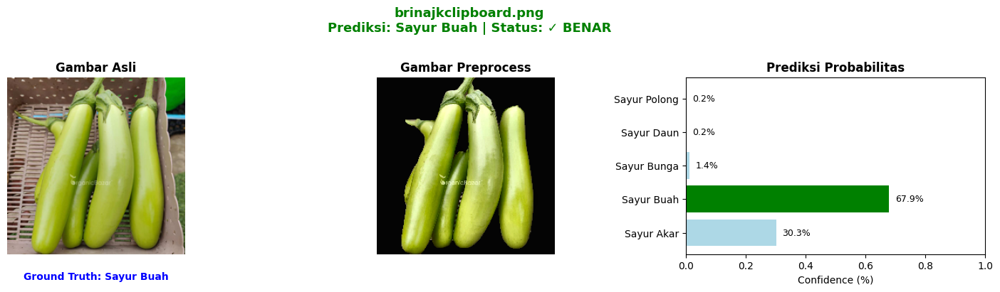

[17/30] Processing: cepclipboard.png


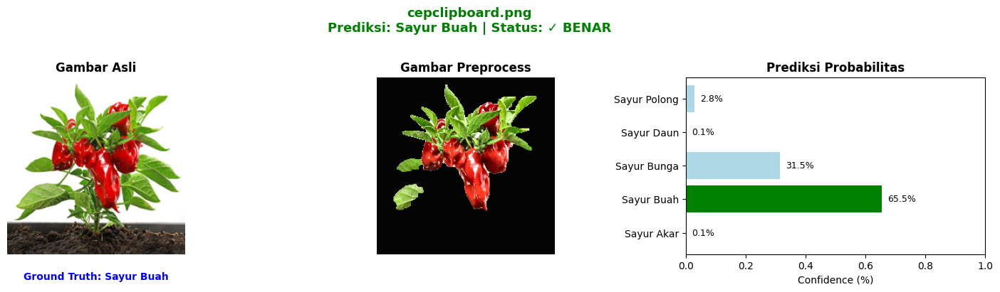

[18/30] Processing: clipboardasd.png


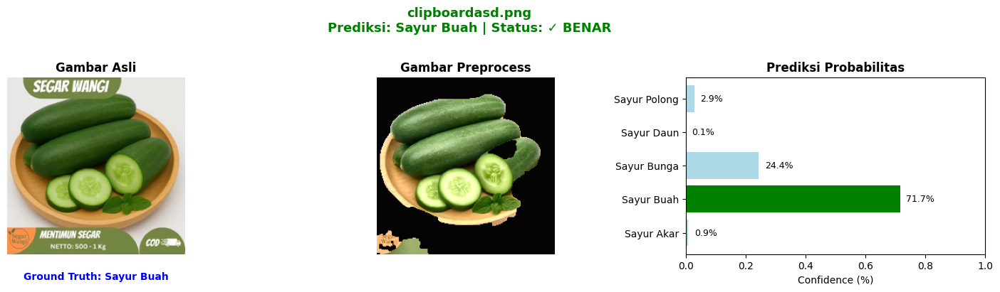

[19/30] Processing: pepaya-thailand-di-lumajang-2_11.png


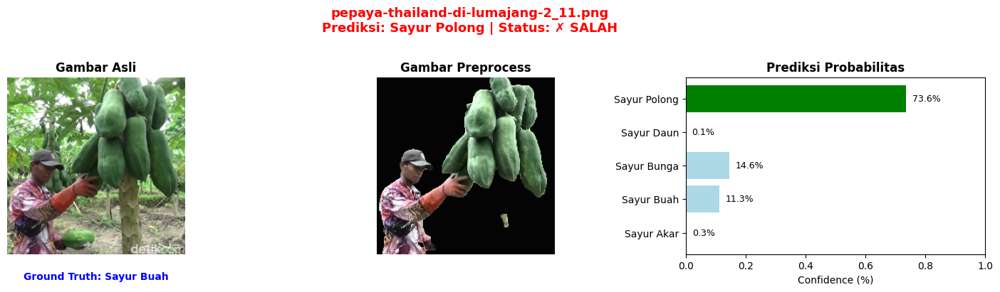

[20/30] Processing: Blog-banner-_-Ternyata-Tidak-Sulit-Loh-Inilah-Cara-Menanam-Tomat-Yang-Benar--1024x768.webp


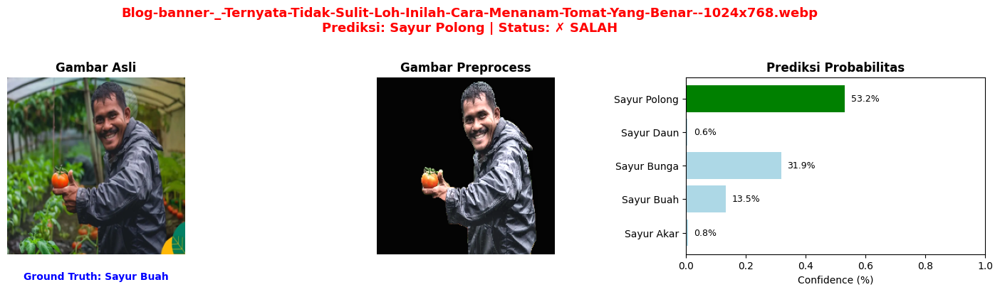

[21/30] Processing: 1666604832343.jpg


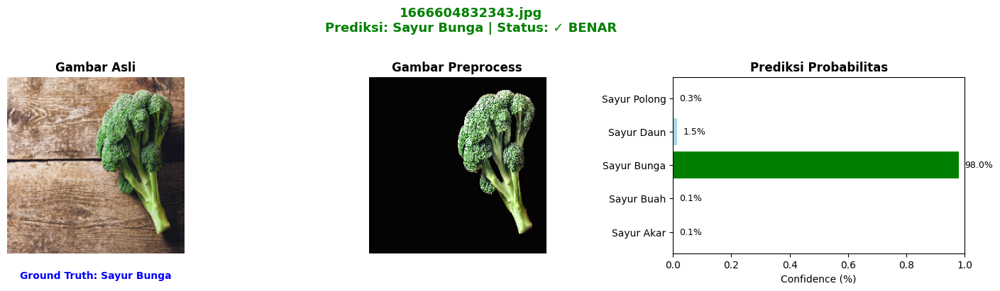

[22/30] Processing: Roasted_Broccoli_012-632f5bb05b49406a8d301bd733ff4686.jpg


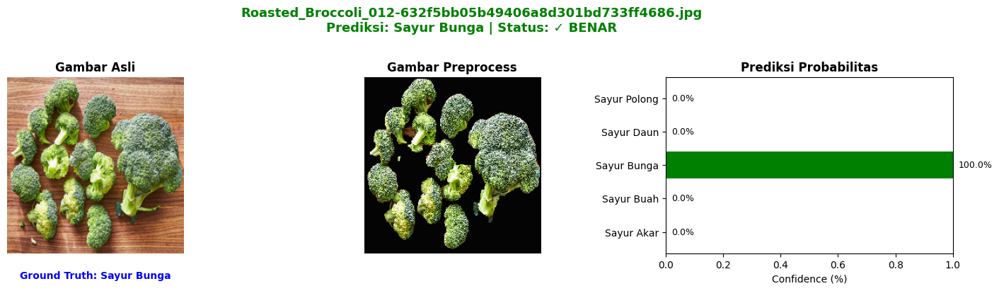

[23/30] Processing: 12clipboard.png


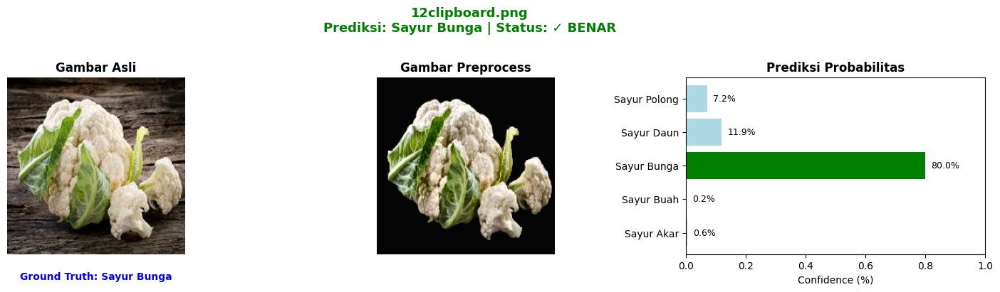

[24/30] Processing: aclipboard.png


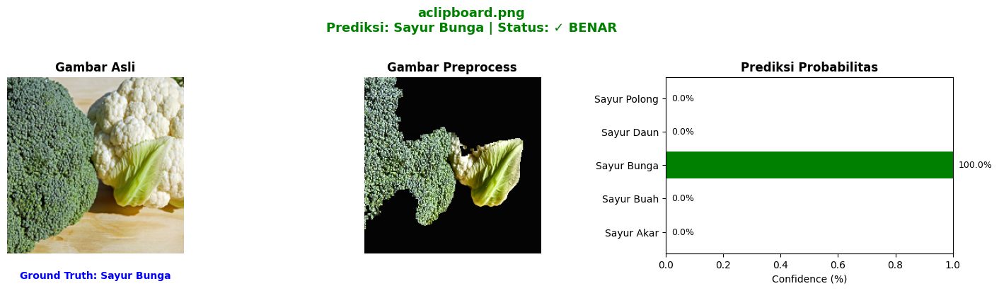

[25/30] Processing: clipboard.png


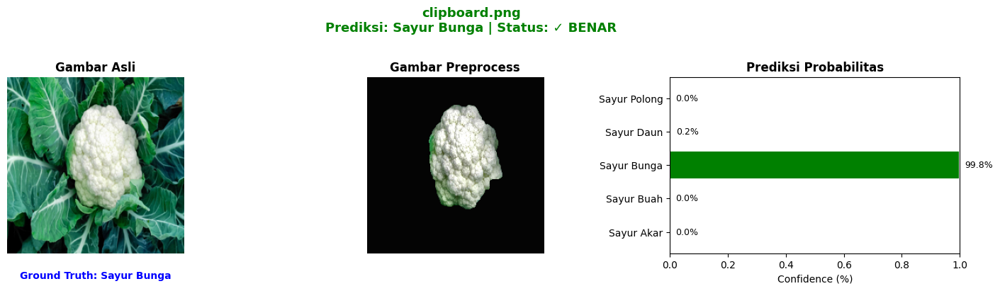

[26/30] Processing: lastclipboard.png


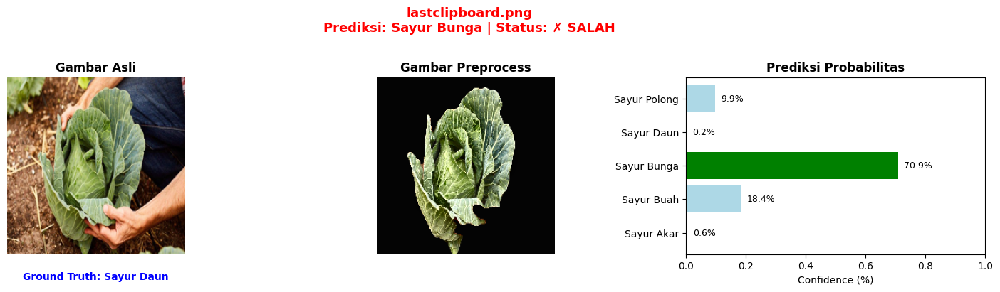

[27/30] Processing: Cabbage.jpg.webp


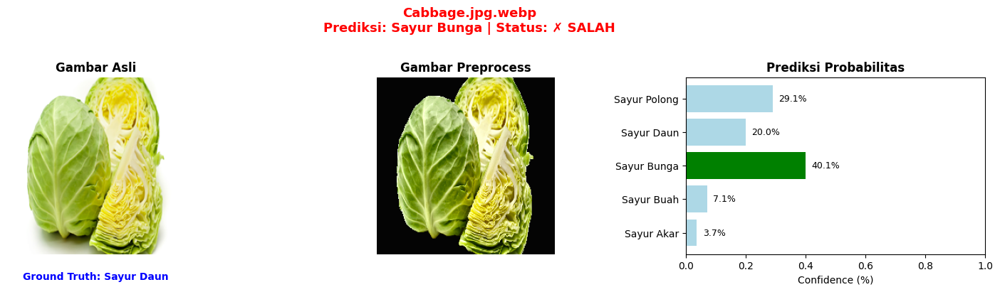

[28/30] Processing: csm_Cabbage_7b2773b5e6.webp


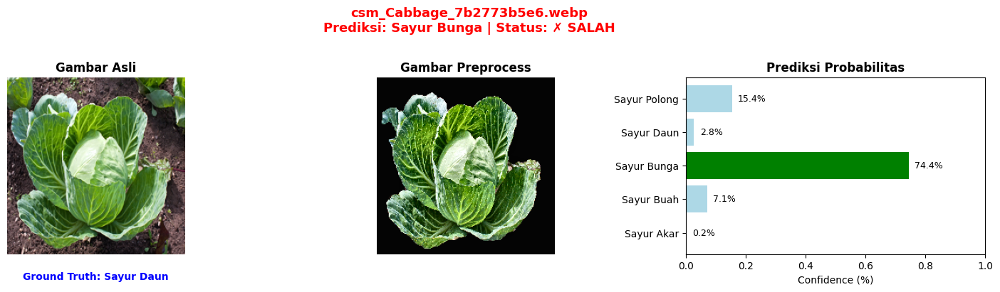

[29/30] Processing: ilustrasi-kacang-polong-foto-pixabay-qbt5s-qcg2.jpg


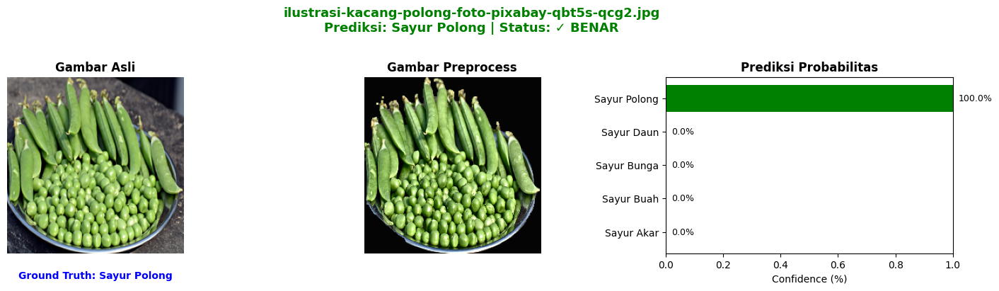

[30/30] Processing: clipboard.png


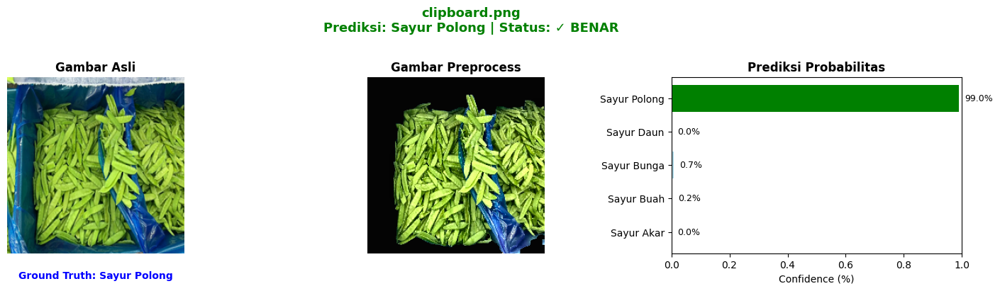


HASIL VALIDASI
Total gambar diproses: 30
Prediksi benar: 20
Prediksi salah: 10
Akurasi keseluruhan: 66.67%


In [28]:
#@markdown ### Test data
import os
import glob
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

# Direktori test images
test_img_dir = "./test_img"

if not os.path.isdir(test_img_dir):
  gdown.download(
      id="1VrbSjqTivDmBmUWOTdrjn2AGOAvlCPtv",
      output="./test_data.zip",
      quiet=True,
  )
  # Extract zip file
  with zipfile.ZipFile('./test_data.zip', 'r') as zip_ref:
      zip_ref.extractall(test_img_dir)

# Mapping folder ke class
class_folders = {
    "Sayur_Akar": "Sayur Akar",
    "Sayur_Buah": "Sayur Buah",
    "Sayur_Bunga": "Sayur Bunga",
    "Sayur_Daun": "Sayur Daun",
    "Sayur_Polong": "Sayur Polong"
}


# Kumpulkan semua gambar dengan label ground truth
test_images = []
for folder_name, class_name in class_folders.items():
    folder_path = os.path.join(test_img_dir, folder_name)
    if os.path.exists(folder_path):
        # Cari semua file gambar (jpg, jpeg, png, webp)
        image_files = []
        for ext in ['*.jpg', '*.jpeg', '*.png', '*.webp']:
            image_files.extend(glob.glob(os.path.join(folder_path, ext)))

        for img_path in image_files:
            test_images.append({
                'path': img_path,
                'true_class': class_name,
                'filename': os.path.basename(img_path)
            })

print(f"Total gambar ditemukan: {len(test_images)}")
print("\nDetail per class:")
for class_name in class_folders.values():
    count = sum(1 for img in test_images if img['true_class'] == class_name)
    print(f"  {class_name}: {count} gambar")


results = []
correct_predictions = 0
total_predictions = 0

print("Memproses gambar...\n")

for idx, img_data in enumerate(test_images, 1):
    img_path = img_data['path']
    true_class = img_data['true_class']
    filename = img_data['filename']

    print(f"[{idx}/{len(test_images)}] Processing: {filename}")

    try:
        # Load gambar
        image = Image.open(img_path)

        # Prediksi menggunakan fungsi predict_image
        predicted_class, confidences, segmented_img = predict_image(
            # model=model,
            # image=image,
            image,
            use_segmentation=True,
            seg_method="u2netp",
        )

        # Plot hasil
        fig, is_correct = plot_prediction_result(
            img_path,
            true_class,
            predicted_class,
            confidences,
            segmented_img
        )

        plt.show()
        plt.close()

        # Simpan hasil
        results.append({
            'filename': filename,
            'true_class': true_class,
            'predicted_class': predicted_class,
            'is_correct': is_correct,
            'confidence': confidences[predicted_class]
        })

        if is_correct:
            correct_predictions += 1
        total_predictions += 1

    except Exception as e:
        print(f"  Error processing {filename}: {str(e)}")
        continue

print(f"\n{'='*60}")
print(f"HASIL VALIDASI")
print(f"{'='*60}")
print(f"Total gambar diproses: {total_predictions}")
print(f"Prediksi benar: {correct_predictions}")
print(f"Prediksi salah: {total_predictions - correct_predictions}")
print(f"Akurasi keseluruhan: {(correct_predictions/total_predictions)*100:.2f}%")


## ML
### SVM


SVM Training
Extracting features from training set...


Train features: 100%|██████████| 52/52 [00:02<00:00, 18.31it/s]


Training features shape: (3272, 44)
Training labels shape: (3272,)

Extracting features from validation set...


Val features: 100%|██████████| 120/120 [00:06<00:00, 18.27it/s]
f:\NaniKaSuru\Polinema\PBL_SEM5\.venv\Lib\site-packages\sklearn\svm\_base.py:305: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Validation features shape: (7627, 44)
Validation labels shape: (7627,)

Scaling features...

Training SVM (RBF kernel)...
[LibSVM]
Evaluating on training set...
Evaluating on validation set...

SVM Results:
Train Accuracy: 99.08%
Val Accuracy:   95.44%

Classification Report (Validation):
              precision    recall  f1-score   support

  Sayur_Akar       0.96      0.98      0.97      1740
  Sayur_Buah       0.96      0.97      0.96      3933
 Sayur_Bunga       0.97      0.93      0.95      1073
  Sayur_Daun       0.92      0.89      0.90       691
Sayur_Polong       0.95      0.69      0.80       190

    accuracy                           0.95      7627
   macro avg       0.95      0.89      0.92      7627
weighted avg       0.95      0.95      0.95      7627


Generating confusion matrix...
Confusion matrix saved to: models\svm-auto_clahe_split_train-30_val_70\confusion_matrix.png


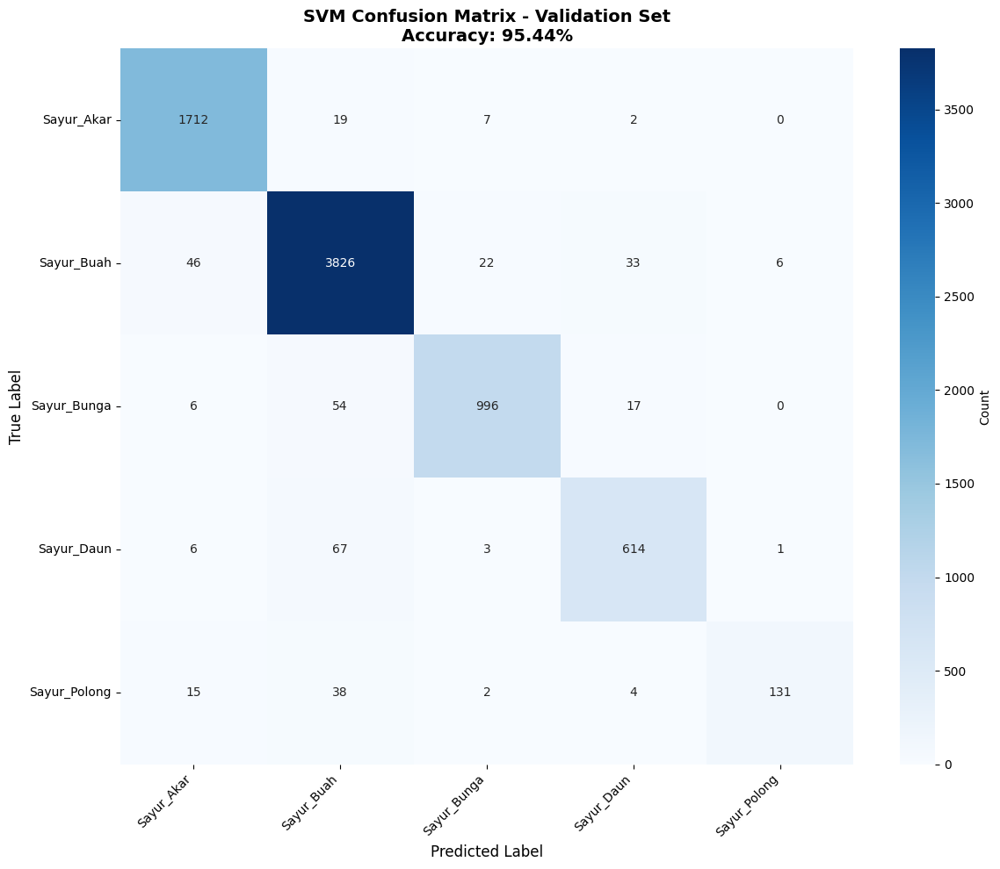


SVM model saved to: models\svm-auto_clahe_split_train-30_val_70
SVM metrics logged to TensorBoard: runs/svm-auto_clahe_split_train-30_val_70



In [29]:
#@markdown ## SVM Training

if HyperParams.RUN_SVM:
    import numpy as np
    from sklearn.svm import SVC
    from sklearn.preprocessing import StandardScaler
    from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
    from tqdm import tqdm
    import pickle
    import joblib
    import matplotlib.pyplot as plt
    import seaborn as sns

    print(f"\n{'='*60}")
    print("SVM Training")
    print(f"{'='*60}")

    # Extract features from train and val loaders
    print("Extracting features from training set...")
    X_train = []
    y_train = []

    for images, handcrafted_features, labels in tqdm(train_loader, desc="Train features"):
        X_train.append(handcrafted_features.numpy())
        y_train.append(labels.numpy())

    X_train = np.vstack(X_train)
    y_train = np.concatenate(y_train)

    print(f"Training features shape: {X_train.shape}")
    print(f"Training labels shape: {y_train.shape}")

    print("\nExtracting features from validation set...")
    X_val = []
    y_val = []

    for images, handcrafted_features, labels in tqdm(val_loader, desc="Val features"):
        X_val.append(handcrafted_features.numpy())
        y_val.append(labels.numpy())

    X_val = np.vstack(X_val)
    y_val = np.concatenate(y_val)

    print(f"Validation features shape: {X_val.shape}")
    print(f"Validation labels shape: {y_val.shape}")

    # Feature scaling
    print("\nScaling features...")
    scaler_svm = StandardScaler()
    X_train_scaled = scaler_svm.fit_transform(X_train)
    X_val_scaled = scaler_svm.transform(X_val)

    # Train SVM with RBF kernel
    print("\nTraining SVM (RBF kernel)...")
    svm_model = SVC(
        kernel='rbf',
        C=10.0,
        gamma='scale',
        random_state=HyperParams.seed,
        verbose=True,
        max_iter=1000
    )

    svm_model.fit(X_train_scaled, y_train)

    # Evaluate on training set
    print("\nEvaluating on training set...")
    y_train_pred = svm_model.predict(X_train_scaled)
    train_acc_svm = accuracy_score(y_train, y_train_pred) * 100

    # Evaluate on validation set
    print("Evaluating on validation set...")
    y_val_pred = svm_model.predict(X_val_scaled)
    val_acc_svm = accuracy_score(y_val, y_val_pred) * 100

    print(f"\n{'='*60}")
    print("SVM Results:")
    print(f"{'='*60}")
    print(f"Train Accuracy: {train_acc_svm:.2f}%")
    print(f"Val Accuracy:   {val_acc_svm:.2f}%")

    print("\nClassification Report (Validation):")
    print(classification_report(y_val, y_val_pred, target_names=class_names))

    # Generate and plot confusion matrix
    print("\nGenerating confusion matrix...")
    cm = confusion_matrix(y_val, y_val_pred)
    
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=class_names, yticklabels=class_names,
                cbar_kws={'label': 'Count'})
    plt.title(f'SVM Confusion Matrix - Validation Set\nAccuracy: {val_acc_svm:.2f}%', 
              fontsize=14, fontweight='bold')
    plt.ylabel('True Label', fontsize=12)
    plt.xlabel('Predicted Label', fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    
    # Save confusion matrix plot
    cm_save_path = os.path.join("models", f"svm-{HyperParams.run_name}", "confusion_matrix.png")
    os.makedirs(os.path.dirname(cm_save_path), exist_ok=True)
    plt.savefig(cm_save_path, dpi=300, bbox_inches='tight')
    print(f"Confusion matrix saved to: {cm_save_path}")
    plt.show()

    # Save SVM model
    svm_save_dir = os.path.join("models", f"svm-{HyperParams.run_name}")
    os.makedirs(svm_save_dir, exist_ok=True)

    # Save model and scaler
    joblib.dump(svm_model, os.path.join(svm_save_dir, "svm_model.pkl"))
    joblib.dump(scaler_svm, os.path.join(svm_save_dir, "scaler.pkl"))

    print(f"\nSVM model saved to: {svm_save_dir}")

    # Log to TensorBoard
    from torch.utils.tensorboard import SummaryWriter
    writer_svm = SummaryWriter(log_dir=os.path.join("runs", f"svm-{HyperParams.run_name}"))

    # Log metrics (SVM only has final results, not per-epoch)
    writer_svm.add_scalar("Accuracy/train", train_acc_svm, 0)
    writer_svm.add_scalar("Accuracy/val", val_acc_svm, 0)

    # Add confusion matrix to TensorBoard
    from torch.utils.tensorboard import SummaryWriter
    import matplotlib

    # fig_cm = plt.figure(figsize=(12, 10))
    # sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
    #             xticklabels=class_names, yticklabels=class_names)
    # plt.title('SVM Confusion Matrix')
    # plt.ylabel('True Label')
    # plt.xlabel('Predicted Label')
    # writer_svm.add_figure("Confusion Matrix", fig_cm, 0)
    # plt.close(fig_cm)

    # Add hyperparameters
    writer_svm.add_text("hyperparameters", f"""
    SVM Configuration:
    - Kernel: RBF
    - C: 10.0
    - Gamma: scale
    - Features: {TOTAL_FEAUTURES}
    - Use Segmentation: {HyperParams.use_segmentation}
    - Segmentation Method: {HyperParams.segmentation_method}
    - Cache Features: {HyperParams.cache_features}
    """)

    writer_svm.close()

    print(f"SVM metrics logged to TensorBoard: runs/svm-{HyperParams.run_name}")
    print(f"{'='*60}\n")

else:
    print("SVM training skipped (RUN_SVM = False)")


### EFFICIENTNETV2S

dataset dir: ./dataset_prepared/30_train
Dataset loaded using ImageFolder:
  3272 train, 7627 val
  Classes (5): ['Sayur_Akar', 'Sayur_Buah', 'Sayur_Bunga', 'Sayur_Daun', 'Sayur_Polong']
Using device: cuda
GPU: NVIDIA GeForce RTX 3060
GPU Memory: 12.88 GB

Model: EfficientNetV2-S
Total parameters: 20,183,893
Trainable parameters: 20,183,893
Pretrained: False
Backbone frozen: False

Epoch 1/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.52it/s, loss=1.4840, acc=33.43%]



Results:
  Train Loss: 3.0923 | Train Acc: 44.99%
  Val Loss:   1.4840 | Val Acc:   33.43%
  Learning Rate: 0.001000
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 33.43%)

Epoch 2/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.93it/s, loss=1.7574, acc=53.85%]



Results:
  Train Loss: 1.7196 | Train Acc: 61.49%
  Val Loss:   1.7574 | Val Acc:   53.85%
  Learning Rate: 0.000998
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 53.85%)

Epoch 3/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.94it/s, loss=3.4959, acc=71.48%]



Results:
  Train Loss: 1.3911 | Train Acc: 61.43%
  Val Loss:   3.4959 | Val Acc:   71.48%
  Learning Rate: 0.000994
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 71.48%)

Epoch 4/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.96it/s, loss=0.8895, acc=74.03%]



Results:
  Train Loss: 1.1569 | Train Acc: 68.12%
  Val Loss:   0.8895 | Val Acc:   74.03%
  Learning Rate: 0.000986
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 74.03%)

Epoch 5/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.93it/s, loss=6.6381, acc=77.95%]



Results:
  Train Loss: 0.9735 | Train Acc: 73.14%
  Val Loss:   6.6381 | Val Acc:   77.95%
  Learning Rate: 0.000976
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 77.95%)

Epoch 6/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.96it/s, loss=0.8923, acc=80.37%]



Results:
  Train Loss: 0.8815 | Train Acc: 75.49%
  Val Loss:   0.8923 | Val Acc:   80.37%
  Learning Rate: 0.000962
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 80.37%)

Epoch 7/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.96it/s, loss=0.8953, acc=82.09%]



Results:
  Train Loss: 1.0217 | Train Acc: 75.86%
  Val Loss:   0.8953 | Val Acc:   82.09%
  Learning Rate: 0.000946
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 82.09%)

Epoch 8/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.94it/s, loss=0.7379, acc=84.32%]



Results:
  Train Loss: 0.7802 | Train Acc: 80.26%
  Val Loss:   0.7379 | Val Acc:   84.32%
  Learning Rate: 0.000926
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 84.32%)

Epoch 9/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.94it/s, loss=0.6008, acc=88.54%]



Results:
  Train Loss: 0.6894 | Train Acc: 85.02%
  Val Loss:   0.6008 | Val Acc:   88.54%
  Learning Rate: 0.000905
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 88.54%)

Epoch 10/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.93it/s, loss=0.8113, acc=85.62%]



Results:
  Train Loss: 0.6935 | Train Acc: 84.38%
  Val Loss:   0.8113 | Val Acc:   85.62%
  Learning Rate: 0.000880
  GPU Memory: 5.38 GB
  Early stopping counter: 1/40

Epoch 11/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.95it/s, loss=0.6804, acc=88.41%]



Results:
  Train Loss: 0.7095 | Train Acc: 87.04%
  Val Loss:   0.6804 | Val Acc:   88.41%
  Learning Rate: 0.000854
  GPU Memory: 5.38 GB
  Early stopping counter: 2/40

Epoch 12/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.96it/s, loss=0.4890, acc=91.08%]



Results:
  Train Loss: 0.6032 | Train Acc: 88.08%
  Val Loss:   0.4890 | Val Acc:   91.08%
  Learning Rate: 0.000825
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 91.08%)

Epoch 13/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.94it/s, loss=0.5011, acc=92.63%]



Results:
  Train Loss: 0.5965 | Train Acc: 89.06%
  Val Loss:   0.5011 | Val Acc:   92.63%
  Learning Rate: 0.000794
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 92.63%)

Epoch 14/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.95it/s, loss=nan, acc=68.19%]  



Results:
  Train Loss: 0.5857 | Train Acc: 89.73%
  Val Loss:   nan | Val Acc:   68.19%
  Learning Rate: 0.000761
  GPU Memory: 5.38 GB
  Early stopping counter: 1/40

Epoch 15/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.96it/s, loss=0.5540, acc=89.30%]



Results:
  Train Loss: 0.7305 | Train Acc: 81.78%
  Val Loss:   0.5540 | Val Acc:   89.30%
  Learning Rate: 0.000727
  GPU Memory: 5.38 GB
  Early stopping counter: 2/40

Epoch 16/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.93it/s, loss=0.5518, acc=90.82%]



Results:
  Train Loss: 0.6303 | Train Acc: 88.48%
  Val Loss:   0.5518 | Val Acc:   90.82%
  Learning Rate: 0.000692
  GPU Memory: 5.38 GB
  Early stopping counter: 3/40

Epoch 17/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.92it/s, loss=1.2498, acc=86.94%]



Results:
  Train Loss: 0.7285 | Train Acc: 84.14%
  Val Loss:   1.2498 | Val Acc:   86.94%
  Learning Rate: 0.000655
  GPU Memory: 5.38 GB
  Early stopping counter: 4/40

Epoch 18/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.95it/s, loss=0.6254, acc=89.97%]



Results:
  Train Loss: 0.6754 | Train Acc: 85.45%
  Val Loss:   0.6254 | Val Acc:   89.97%
  Learning Rate: 0.000617
  GPU Memory: 5.38 GB
  Early stopping counter: 5/40

Epoch 19/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.93it/s, loss=0.5143, acc=90.21%]



Results:
  Train Loss: 0.6053 | Train Acc: 87.32%
  Val Loss:   0.5143 | Val Acc:   90.21%
  Learning Rate: 0.000579
  GPU Memory: 5.38 GB
  Early stopping counter: 6/40

Epoch 20/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.92it/s, loss=0.5316, acc=90.85%]



Results:
  Train Loss: 0.5169 | Train Acc: 89.61%
  Val Loss:   0.5316 | Val Acc:   90.85%
  Learning Rate: 0.000540
  GPU Memory: 5.38 GB
  Early stopping counter: 7/40

Epoch 21/40


Validation: 100%|██████████| 120/120 [00:15<00:00,  7.91it/s, loss=0.4462, acc=91.91%]



Results:
  Train Loss: 0.5250 | Train Acc: 89.15%
  Val Loss:   0.4462 | Val Acc:   91.91%
  Learning Rate: 0.000500
  GPU Memory: 5.38 GB
  Early stopping counter: 8/40

Epoch 22/40


Validation: 100%|██████████| 120/120 [00:16<00:00,  7.32it/s, loss=0.5054, acc=93.48%]



Results:
  Train Loss: 0.4978 | Train Acc: 90.10%
  Val Loss:   0.5054 | Val Acc:   93.48%
  Learning Rate: 0.000461
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 93.48%)

Epoch 23/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.96it/s, loss=0.4163, acc=93.77%]



Results:
  Train Loss: 0.4493 | Train Acc: 92.33%
  Val Loss:   0.4163 | Val Acc:   93.77%
  Learning Rate: 0.000422
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 93.77%)

Epoch 24/40


Validation: 100%|██████████| 120/120 [00:18<00:00,  6.62it/s, loss=0.4091, acc=93.94%]



Results:
  Train Loss: 0.4511 | Train Acc: 92.60%
  Val Loss:   0.4091 | Val Acc:   93.94%
  Learning Rate: 0.000384
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 93.94%)

Epoch 25/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.94it/s, loss=0.4050, acc=93.72%]



Results:
  Train Loss: 0.4350 | Train Acc: 92.63%
  Val Loss:   0.4050 | Val Acc:   93.72%
  Learning Rate: 0.000346
  GPU Memory: 5.38 GB
  Early stopping counter: 1/40

Epoch 26/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.82it/s, loss=0.4576, acc=92.97%]



Results:
  Train Loss: 0.4262 | Train Acc: 93.03%
  Val Loss:   0.4576 | Val Acc:   92.97%
  Learning Rate: 0.000309
  GPU Memory: 5.38 GB
  Early stopping counter: 2/40

Epoch 27/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.88it/s, loss=0.4165, acc=94.01%]



Results:
  Train Loss: 0.4566 | Train Acc: 92.85%
  Val Loss:   0.4165 | Val Acc:   94.01%
  Learning Rate: 0.000274
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 94.01%)

Epoch 28/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.85it/s, loss=0.3906, acc=94.55%]



Results:
  Train Loss: 0.4232 | Train Acc: 93.77%
  Val Loss:   0.3906 | Val Acc:   94.55%
  Learning Rate: 0.000240
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 94.55%)

Epoch 29/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.85it/s, loss=0.4373, acc=94.26%]



Results:
  Train Loss: 0.4234 | Train Acc: 93.77%
  Val Loss:   0.4373 | Val Acc:   94.26%
  Learning Rate: 0.000207
  GPU Memory: 5.38 GB
  Early stopping counter: 1/40

Epoch 30/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.88it/s, loss=0.3745, acc=95.16%]



Results:
  Train Loss: 0.3880 | Train Acc: 95.08%
  Val Loss:   0.3745 | Val Acc:   95.16%
  Learning Rate: 0.000176
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 95.16%)

Epoch 31/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.87it/s, loss=0.4226, acc=94.78%]



Results:
  Train Loss: 0.4256 | Train Acc: 95.60%
  Val Loss:   0.4226 | Val Acc:   94.78%
  Learning Rate: 0.000147
  GPU Memory: 5.38 GB
  Early stopping counter: 1/40

Epoch 32/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.81it/s, loss=0.4271, acc=94.94%]



Results:
  Train Loss: 0.4042 | Train Acc: 94.77%
  Val Loss:   0.4271 | Val Acc:   94.94%
  Learning Rate: 0.000121
  GPU Memory: 5.38 GB
  Early stopping counter: 2/40

Epoch 33/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.90it/s, loss=0.3732, acc=95.04%]



Results:
  Train Loss: 0.4018 | Train Acc: 94.87%
  Val Loss:   0.3732 | Val Acc:   95.04%
  Learning Rate: 0.000096
  GPU Memory: 5.38 GB
  Early stopping counter: 3/40

Epoch 34/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.89it/s, loss=0.3681, acc=95.08%]



Results:
  Train Loss: 0.4018 | Train Acc: 95.42%
  Val Loss:   0.3681 | Val Acc:   95.08%
  Learning Rate: 0.000075
  GPU Memory: 5.38 GB
  Early stopping counter: 4/40

Epoch 35/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.89it/s, loss=0.3699, acc=95.66%]



Results:
  Train Loss: 0.3836 | Train Acc: 95.39%
  Val Loss:   0.3699 | Val Acc:   95.66%
  Learning Rate: 0.000055
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 95.66%)

Epoch 36/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.89it/s, loss=0.3518, acc=95.62%]



Results:
  Train Loss: 0.3710 | Train Acc: 95.75%
  Val Loss:   0.3518 | Val Acc:   95.62%
  Learning Rate: 0.000039
  GPU Memory: 5.38 GB
  Early stopping counter: 1/40

Epoch 37/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.92it/s, loss=0.3592, acc=95.65%]



Results:
  Train Loss: 0.3749 | Train Acc: 95.32%
  Val Loss:   0.3592 | Val Acc:   95.65%
  Learning Rate: 0.000025
  GPU Memory: 5.38 GB
  Early stopping counter: 2/40

Epoch 38/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.90it/s, loss=0.3763, acc=95.69%]



Results:
  Train Loss: 0.3631 | Train Acc: 95.90%
  Val Loss:   0.3763 | Val Acc:   95.69%
  Learning Rate: 0.000015
  GPU Memory: 5.38 GB
  ✓ Best model saved! (Val Acc: 95.69%)

Epoch 39/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.85it/s, loss=0.3658, acc=95.65%]



Results:
  Train Loss: 0.3492 | Train Acc: 96.36%
  Val Loss:   0.3658 | Val Acc:   95.65%
  Learning Rate: 0.000007
  GPU Memory: 5.38 GB
  Early stopping counter: 1/40

Epoch 40/40


Validation: 100%|██████████| 120/120 [00:17<00:00,  6.86it/s, loss=0.3526, acc=95.41%]



Results:
  Train Loss: 0.3625 | Train Acc: 96.58%
  Val Loss:   0.3526 | Val Acc:   95.41%
  Learning Rate: 0.000003
  GPU Memory: 5.38 GB
  Early stopping counter: 2/40

Training Complete!
Best Validation Accuracy: 95.69%
Model saved to: models\effnetv2s-auto_clahe_split_train-30_val_70

Generating Classification Report on Validation Set...



Classification Report
              precision    recall  f1-score   support

  Sayur_Akar       0.97      0.99      0.98      1740
  Sayur_Buah       0.95      0.98      0.97      3933
 Sayur_Bunga       0.97      0.90      0.94      1073
  Sayur_Daun       0.93      0.90      0.92       691
Sayur_Polong       0.96      0.52      0.68       190

    accuracy                           0.95      7627
   macro avg       0.95      0.86      0.89      7627
weighted avg       0.95      0.95      0.95      7627



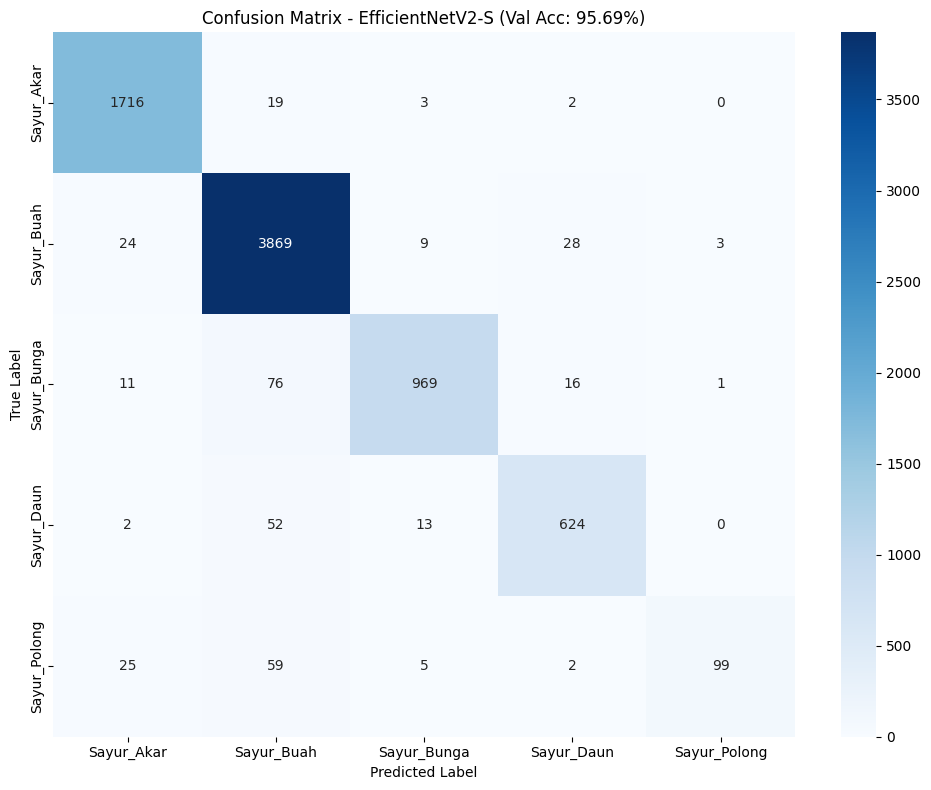

In [30]:
# @markdown ### Model.py - EfficientNetV2 Model
if HyperParams.RUN_EFFICIENTNETV2S:
    import torch.nn as nn
    import torch
    import torch.nn.functional as F
    from torchvision import models

    class EfficientNetV2Model(nn.Module):
        def __init__(
            self,
            num_classes=4,
            dropout_rate=0.3,
            pretrained=True,
            freeze_backbone=False,
        ):
            super().__init__()

            # Load EfficientNetV2-S (Small) pretrained model
            if pretrained:
                weights = models.EfficientNet_V2_S_Weights.DEFAULT
                self.backbone = models.efficientnet_v2_s(weights=weights)
            else:
                self.backbone = models.efficientnet_v2_s(weights=None)

            # Freeze backbone if requested
            if freeze_backbone:
                for param in self.backbone.parameters():
                    param.requires_grad = False

            # Get the number of features from the last layer
            in_features = self.backbone.classifier[1].in_features

            # Replace the classifier
            self.backbone.classifier = nn.Sequential(
                nn.Dropout(p=dropout_rate, inplace=True),
                nn.Linear(in_features, num_classes),
            )

            # Initialize the new classifier layer
            self._initialize_classifier()

        def _initialize_classifier(self):
            """Initialize the classifier layer"""
            for m in self.backbone.classifier.modules():
                if isinstance(m, nn.Linear):
                    nn.init.kaiming_normal_(
                        m.weight, mode="fan_out", nonlinearity="relu"
                    )
                    if m.bias is not None:
                        nn.init.constant_(m.bias, 0)

        def forward(self, x):
            return self.backbone(x)

        def unfreeze_backbone(self):
            """Unfreeze all backbone parameters for fine-tuning"""
            for param in self.backbone.parameters():
                param.requires_grad = True

    # @markdown ### Helper Data Loader
    import os
    from torch.utils.data import DataLoader
    import torchvision.transforms as T
    from torchvision.datasets import ImageFolder

    def load_dataset(
        dataset_dir,
        batch_size,
        num_workers,
        img_size,
        prefetch_factor,
        persistent_workers,
        pin_memory,
    ):
        train_dir = os.path.join(dataset_dir, "train")
        val_dir = os.path.join(dataset_dir, "val")

        # Buat transforms
        train_transform = T.Compose(
            [
                T.Resize((img_size, img_size)),
                # T.RandomHorizontalFlip(p=0.5),
                # T.RandomRotation(15),
                # T.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
                # T.RandomAffine(degrees=0, translate=(0.1, 0.1)),
                T.ToTensor(),
                T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
            ]
        )

        val_transform = T.Compose(
            [
                T.Resize((img_size, img_size)),
                T.ToTensor(),
                T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
            ]
        )

        # ImageFolder secara otomatis membaca struktur folder dan assign labels
        train_dataset = ImageFolder(root=train_dir, transform=train_transform)
        val_dataset = ImageFolder(root=val_dir, transform=val_transform)

        # Get class names dari ImageFolder
        class_names = train_dataset.classes

        # GPU-Optimized DataLoader settings
        dataloader_kwargs = {
            "batch_size": batch_size,
            "num_workers": num_workers,
            "pin_memory": pin_memory,
            "persistent_workers": persistent_workers if num_workers > 0 else False,
            "prefetch_factor": prefetch_factor if num_workers > 0 else None,
        }

        train_loader = DataLoader(train_dataset, shuffle=True, **dataloader_kwargs)
        val_loader = DataLoader(val_dataset, shuffle=False, **dataloader_kwargs)

        print(f"Dataset loaded using ImageFolder:")
        print(f"  {len(train_dataset)} train, {len(val_dataset)} val")
        print(f"  Classes ({len(class_names)}): {class_names}")

        return train_loader, val_loader, class_names


    print(f"dataset dir: {dataset_dir}")

    train_loader, val_loader, class_names = load_dataset(
        dataset_dir,
        batch_size=HyperParams.batch_size,
        num_workers=HyperParams.num_workers,
        img_size=HyperParams.img_size,
        prefetch_factor=HyperParams.prefetch_factor,
        persistent_workers=HyperParams.persistent_workers,
        pin_memory=HyperParams.pin_memory,
    )

    import torch
    import torch.nn as nn
    from torch.utils.tensorboard import SummaryWriter
    from torch.optim.lr_scheduler import CosineAnnealingLR, StepLR, ReduceLROnPlateau
    from tqdm import tqdm
    import os

    # Setup
    # ========================================
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    if torch.cuda.is_available():
        print(f"GPU: {torch.cuda.get_device_name(0)}")
        print(
            f"GPU Memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB"
        )
        # Enable TF32 for faster training on Ampere GPUs
        # torch.backends.cuda.matmul.allow_tf32 = True
        # torch.backends.cudnn.allow_tf32 = True
        # torch.backends.cudnn.benchmark = True

    # Model, Loss, Optimizer
    # ========================================
    model = EfficientNetV2Model(
        num_classes=HyperParams.num_classes,
        dropout_rate=HyperParams.dropout_rate,
        pretrained=HyperParams.pretrained,
        freeze_backbone=HyperParams.freeze_backbone,
    ).to(device)

    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"\nModel: EfficientNetV2-S")
    print(f"Total parameters: {total_params:,}")
    print(f"Trainable parameters: {trainable_params:,}")
    print(f"Pretrained: {HyperParams.pretrained}")
    print(f"Backbone frozen: {HyperParams.freeze_backbone}")

    # Loss function
    criterion = nn.CrossEntropyLoss(label_smoothing=HyperParams.label_smoothing)

    # Optimizer
    optimizer = torch.optim.AdamW(
        model.parameters(), lr=HyperParams.lr, weight_decay=HyperParams.weight_decay
    )

    # Learning rate scheduler
    if HyperParams.scheduler_type == "cosine":
        scheduler = CosineAnnealingLR(optimizer, T_max=HyperParams.epochs, eta_min=1e-6)
    elif HyperParams.scheduler_type == "step":
        scheduler = StepLR(optimizer, step_size=10, gamma=0.1)
    elif HyperParams.scheduler_type == "reduce_on_plateau":
        scheduler = ReduceLROnPlateau(
            optimizer, mode="max", factor=0.5, patience=5, min_lr=1e-6
        )
    else:
        scheduler = None

    # Mixed precision scaler
    scaler = torch.amp.GradScaler(device, enabled=HyperParams.use_amp)

    # TensorBoard writer
    writer = SummaryWriter(log_dir=os.path.join("runs", f"effnetv2s-{HyperParams.run_name}"))

    # Model checkpoint directory
    save_dir = os.path.join("models", f"effnetv2s-{HyperParams.run_name}")
    os.makedirs(save_dir, exist_ok=True)

    # Training Loop
    # ========================================
    best_val_acc = 0.0
    early_stop_counter = 0

    for epoch in range(HyperParams.epochs):
        print(f"\n{'='*60}")
        print(f"Epoch {epoch+1}/{HyperParams.epochs}")
        print(f"{'='*60}")

        # -------------------- Training --------------------
        model.train()
        train_loss = 0.0
        train_correct = 0
        train_total = 0

        pbar = tqdm(train_loader, desc=f"Training")
        for batch_idx, (images, labels) in enumerate(pbar):
            # Move data to GPU (non_blocking for async transfer)
            images = images.to(device, non_blocking=True)
            labels = labels.to(device, non_blocking=True)

            # Zero gradients
            optimizer.zero_grad(set_to_none=True)  # Faster than zero_grad()

            # Mixed precision forward pass
            with torch.amp.autocast(str(device), enabled=HyperParams.use_amp):
                outputs = model(images)
                loss = criterion(outputs, labels)

            # Backward pass
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            # Statistics
            train_loss += loss.item()
            _, predicted = outputs.max(1)
            train_total += labels.size(0)
            train_correct += predicted.eq(labels).sum().item()

            # Update progress bar
            pbar.set_postfix(
                {
                    "loss": f"{train_loss/(batch_idx+1):.4f}",
                    "acc": f"{100.*train_correct/train_total:.2f}%",
                }
            )

        train_loss_avg = train_loss / len(train_loader)
        train_acc = 100.0 * train_correct / train_total

        # -------------------- Validation --------------------
        model.eval()
        val_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            pbar = tqdm(val_loader, desc=f"Validation")
            for batch_idx, (images, labels) in enumerate(pbar):
                images = images.to(device, non_blocking=True)
                labels = labels.to(device, non_blocking=True)

                with torch.amp.autocast(str(device), enabled=HyperParams.use_amp):
                    outputs = model(images)
                    loss = criterion(outputs, labels)

                val_loss += loss.item()
                _, predicted = outputs.max(1)
                val_total += labels.size(0)
                val_correct += predicted.eq(labels).sum().item()

                pbar.set_postfix(
                    {
                        "loss": f"{val_loss/(batch_idx+1):.4f}",
                        "acc": f"{100.*val_correct/val_total:.2f}%",
                    }
                )

        val_loss_avg = val_loss / len(val_loader)
        val_acc = 100.0 * val_correct / val_total

        # -------------------- Logging --------------------
        current_lr = optimizer.param_groups[0]["lr"]

        print(f"\nResults:")
        print(f"  Train Loss: {train_loss_avg:.4f} | Train Acc: {train_acc:.2f}%")
        print(f"  Val Loss:   {val_loss_avg:.4f} | Val Acc:   {val_acc:.2f}%")
        print(f"  Learning Rate: {current_lr:.6f}")

        if torch.cuda.is_available():
            print(f"  GPU Memory: {torch.cuda.max_memory_allocated()/1e9:.2f} GB")
            torch.cuda.reset_peak_memory_stats()

        # TensorBoard logging
        writer.add_scalar(f"Loss/train", train_loss_avg, epoch)
        writer.add_scalar(f"Loss/val", val_loss_avg, epoch)
        writer.add_scalar(f"Accuracy/train", train_acc, epoch)
        writer.add_scalar(f"Accuracy/val", val_acc, epoch)
        writer.add_scalar(f"LR", current_lr, epoch)

        # -------------------- Scheduler Step --------------------
        if scheduler:
            if isinstance(scheduler, ReduceLROnPlateau):
                scheduler.step(val_acc)
            else:
                scheduler.step()

        # -------------------- Model Checkpoint --------------------
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            early_stop_counter = 0

            # Convert HyperParams to dict (avoid mappingproxy pickle error)
            hyperparams_dict = {
                "batch_size": HyperParams.batch_size,
                "img_size": HyperParams.img_size,
                "epochs": HyperParams.epochs,
                "lr": HyperParams.lr,
                "weight_decay": HyperParams.weight_decay,
                "num_classes": HyperParams.num_classes,
                "dropout_rate": HyperParams.dropout_rate,
                "scheduler_type": HyperParams.scheduler_type,
                "label_smoothing": HyperParams.label_smoothing,
                "pretrained": HyperParams.pretrained,
                "freeze_backbone": HyperParams.freeze_backbone,
            }

            checkpoint = {
                "epoch": epoch + 1,
                "model_state_dict": model.state_dict(),
                "optimizer_state_dict": optimizer.state_dict(),
                "scheduler_state_dict": scheduler.state_dict() if scheduler else None,
                "best_val_acc": best_val_acc,
                "val_loss": val_loss_avg,
                "hyperparams": hyperparams_dict,
                "class_names": class_names,
            }

            torch.save(checkpoint, os.path.join(save_dir, "best_model.pth"))
            print(f"  ✓ Best model saved! (Val Acc: {best_val_acc:.2f}%)")
        else:
            early_stop_counter += 1
            print(
                f"  Early stopping counter: {early_stop_counter}/{HyperParams.early_stopping_patience}"
            )

        # Early stopping
        if early_stop_counter >= HyperParams.early_stopping_patience:
            print(f"\n⚠ Early stopping triggered after {epoch+1} epochs")
            break

        # Save last checkpoint
        if not HyperParams.save_best_only:
            torch.save(
                checkpoint, os.path.join(save_dir, f"checkpoint_epoch_{epoch+1}.pth")
            )

    writer.close()
    print(f"\n{'='*60}")
    print(f"Training Complete!")
    print(f"Best Validation Accuracy: {best_val_acc:.2f}%")
    print(f"Model saved to: {save_dir}")
    print(f"{'='*60}")

    # -------------------- Classification Report --------------------
    print(f"\n{'='*60}")
    print("Generating Classification Report on Validation Set...")
    print(f"{'='*60}")

    from sklearn.metrics import classification_report, confusion_matrix
    import matplotlib.pyplot as plt
    import seaborn as sns
    import numpy as np

    model.eval()
    all_labels = []
    all_preds = []

    with torch.no_grad():
        for images, labels in tqdm(val_loader, desc="Collecting predictions"):
            images = images.to(device, non_blocking=True)
            labels = labels.to(device, non_blocking=True)

            with torch.amp.autocast(str(device), enabled=HyperParams.use_amp):
                outputs = model(images)
                _, predicted = outputs.max(1)

            all_labels.extend(labels.cpu().numpy())
            all_preds.extend(predicted.cpu().numpy())

    # Convert to numpy arrays
    all_labels = np.array(all_labels)
    all_preds = np.array(all_preds)

    print("\n" + "="*60)
    print("Classification Report")
    print("="*60)
    print(classification_report(all_labels, all_preds, target_names=class_names))

    # Compute confusion matrix
    cm = confusion_matrix(all_labels, all_preds)

    # Plot confusion matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(
        cm,
        annot=True,
        fmt="d",
        cmap="Blues",
        xticklabels=class_names,
        yticklabels=class_names,
    )
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.title(f"Confusion Matrix - EfficientNetV2-S (Val Acc: {best_val_acc:.2f}%)")
    plt.tight_layout()
    plt.show()

    print(f"\n{'='*60}")